# Project 3 of Evaluation Phase 2 - Loan Application Status Prediction 

#### Project Description
    This dataset includes details of applicants who have applied for loan. The dataset includes details like credit history, loan amount, their income, dependents etc. 
    Independent Variables:
    1.	Loan_ID - This refer to the unique identifier of the applicant's affirmed purchases
    2.	Gender - This refers to either of the two main categories (male and female) into which applicants are divided on the basis of their reproductive functions
    3.	Married - This refers to applicant being in a state of matrimony
    4.	Dependents - This refres to persons who depends on the applicants for survival
    5.	Education - This refers to number of years in which applicant received systematic instruction, especially at a school or university
    6.	Self_Employed - This refers to applicant working for oneself as a freelancer or the owner of a business rather than for an employer
    7.	Applicant Income - This refers to disposable income available for the applicant's use under State law.
    8.	CoapplicantIncome - This refers to disposable income available for the people that participate in the loan application process alongside the main applicant use under State law.
    9.	Loan_Amount - This refers to the amount of money an applicant owe at any given time.
    10.	Loan_Amount_Term - This refers to the duaration in which the loan is availed to the applicant
    11.	Credit History - This refers to a record of applicant's ability to repay debts and demonstrated responsibility in repaying them.
    12.	Property_Area - This refers to the total area within the boundaries of the property as set out in Schedule.
    13.	Loan_Status - This refres to whether applicant is eligible to be availed the Loan requested.
    You have to build a model that can predict whether the loan of the applicant will be approved(Loan_status) or not on the basis of the details provided in the dataset. 


###### Dataset Link-  
•	https://github.com/FlipRoboTechnologies/ML_-Datasets/blob/main/Loan%20Application%20Status/loan_prediction.csv


#### import the required library

In [259]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

##### read the dataset

In [260]:
data=pd.read_csv(r"C:\Users\Arcturus\Downloads\loan_prediction.csv")
data

,Loan_ID,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
0,LP001002,Male,No,0,Graduate,No,5849,0.0,NaN,360.0,1.0,Urban,Y
1,LP001003,Male,Yes,1,Graduate,No,4583,1508.0,128.0,360.0,1.0,Rural,N
2,LP001005,Male,Yes,0,Graduate,Yes,3000,0.0,66.0,360.0,1.0,Urban,Y
3,LP001006,Male,Yes,0,Not Graduate,No,2583,2358.0,120.0,360.0,1.0,Urban,Y
4,LP001008,Male,No,0,Graduate,No,6000,0.0,141.0,360.0,1.0,Urban,Y
...,...,...,...,...,...,...,...,...,...,...,...,...,...
609,LP002978,Female,No,0,Graduate,No,2900,0.0,71.0,360.0,1.0,Rural,Y
610,LP002979,Male,Yes,3+,Graduate,No,4106,0.0,40.0,180.0,1.0,Rural,Y
611,LP002983,Male,Yes,1,Graduate,No,8072,240.0,253.0,360.0,1.0,Urban,Y
612,LP002984,Male,Yes,2,Graduate,No,7583,0.0,187.0,360.0,1.0,Urban,Y


here Loan_ID is used only for unique is purpose so this is useless for model.

In [261]:
data.drop(['Loan_ID'],axis=1,inplace=True)

In [262]:
print(f"Rows : {data.shape[0]}")
print(f"Columns : {data.shape[1]}")

Rows : 614
Columns : 12


##### Check the datatype

In [263]:
data.dtypes

Gender                object
Married               object
Dependents            object
Education             object
Self_Employed         object
ApplicantIncome        int64
CoapplicantIncome    float64
LoanAmount           float64
Loan_Amount_Term     float64
Credit_History       float64
Property_Area         object
Loan_Status           object
dtype: object

###### here we see :
    Gender,Married,Dependents,Education,Self_Employed,Property_Area,Loan_Status is a object data type.
    ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History is a int or float data type.

### Data Intigrity Check : 

###### Check the dupplicate value

In [264]:
data.duplicated().sum()

0

here we see there is no any duplicate value in dataset.

##### Check the white space

In [265]:
# Check the white spaces on data
data.isin([' ','?','-','null','NA']).sum().any()

False

### Check Missing Value

In [266]:
# check the null value
data.isnull().sum()

Gender               13
Married               3
Dependents           15
Education             0
Self_Employed        32
ApplicantIncome       0
CoapplicantIncome     0
LoanAmount           22
Loan_Amount_Term     14
Credit_History       50
Property_Area         0
Loan_Status           0
dtype: int64

In [267]:
# check the null values with percentage
null_values = data.isnull().sum().sort_values(ascending = False)
per_null =(null_values/len(data))*100
print(pd.concat([null_values, per_null], axis =1, keys =['Null Values', ' %NUll data']))

                   Null Values   %NUll data
Credit_History              50     8.143322
Self_Employed               32     5.211726
LoanAmount                  22     3.583062
Dependents                  15     2.442997
Loan_Amount_Term            14     2.280130
Gender                      13     2.117264
Married                      3     0.488599
Education                    0     0.000000
ApplicantIncome              0     0.000000
CoapplicantIncome            0     0.000000
Property_Area                0     0.000000
Loan_Status                  0     0.000000


###### here we see:
    Credit_History has 8%, Self_Employed has 5%, LoanAmount has 3%, and Dependents,Loan_Amount_Term,Gender has 2% or Married has aprox 0.5% null values.so we have to remove the missing values further.
    

<Axes: >

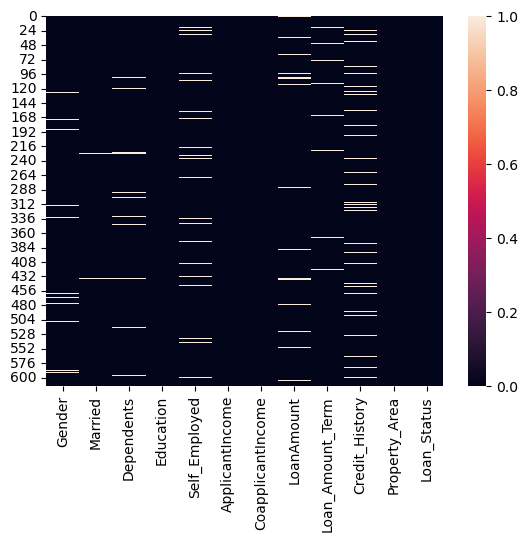

In [268]:
# lets visualization with heatmap for missing values
sns.heatmap(data.isnull())

##### Check the values counts

In [269]:
for col in data:
    print(data[col].value_counts())
    print("="*25)

Gender
Male      489
Female    112
Name: count, dtype: int64
Married
Yes    398
No     213
Name: count, dtype: int64
Dependents
0     345
1     102
2     101
3+     51
Name: count, dtype: int64
Education
Graduate        480
Not Graduate    134
Name: count, dtype: int64
Self_Employed
No     500
Yes     82
Name: count, dtype: int64
ApplicantIncome
2500    9
4583    6
6000    6
2600    6
3333    5
       ..
3244    1
4408    1
3917    1
3992    1
7583    1
Name: count, Length: 505, dtype: int64
CoapplicantIncome
0.0       273
2500.0      5
2083.0      5
1666.0      5
2250.0      3
         ... 
2791.0      1
1010.0      1
1695.0      1
2598.0      1
240.0       1
Name: count, Length: 287, dtype: int64
LoanAmount
120.0    20
110.0    17
100.0    15
160.0    12
187.0    12
         ..
240.0     1
214.0     1
59.0      1
166.0     1
253.0     1
Name: count, Length: 203, dtype: int64
Loan_Amount_Term
360.0    512
180.0     44
480.0     15
300.0     13
240.0      4
84.0       4
120.0      3
60

##### Comment :
    Gender,Married,Dependents,Education,Self_Employed,Property_Area,Loan_Status is a catagory column. and we see Loan_Status is a target feature so we can say this is binary classification problem.
    ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History is a numeric column.

###### Lets see remove the missing values.

In [270]:
# remove the missing value of Credit_History with mode
data['Credit_History']=data['Credit_History'].fillna(data['Credit_History'].mode()[0])

In [271]:
# remove the missing value of Self_Employed with mode
data['Self_Employed']=data['Self_Employed'].fillna(data['Self_Employed'].mode()[0])

In [272]:
# remove the missing value of LoanAmount with median
data['LoanAmount']=data['LoanAmount'].fillna(data['LoanAmount'].median())


In [273]:
# remove the missing value of Dependents with mode
data['Dependents']=data['Dependents'].fillna(data['Dependents'].mode()[0])

In [274]:
# remove the missing value of Loan_Amount_Term with mean
data['Loan_Amount_Term']=data['Loan_Amount_Term'].fillna(data['Loan_Amount_Term'].mean())

In [275]:
# remove the missing value of Gender with mode
data['Gender']=data['Gender'].fillna(data['Gender'].mode()[0])

In [276]:
# remove the missing value of Married with mode
data['Married']=data['Married'].fillna(data['Married'].mode()[0])

In [277]:
# here again check missing values
data.isnull().sum()

Gender               0
Married              0
Dependents           0
Education            0
Self_Employed        0
ApplicantIncome      0
CoapplicantIncome    0
LoanAmount           0
Loan_Amount_Term     0
Credit_History       0
Property_Area        0
Loan_Status          0
dtype: int64

###### Lets see we have solved the problem of missing values.

### Checked Statistical data

In [278]:
data.describe()

,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History
count,614.000000,614.000000,614.000000,614.000000,614.000000
mean,5403.459283,1621.245798,145.752443,342.000000,0.855049
std,6109.041673,2926.248369,84.107233,64.372489,0.352339
min,150.000000,0.000000,9.000000,12.000000,0.000000
25%,2877.500000,0.000000,100.250000,360.000000,1.000000
50%,3812.500000,1188.500000,128.000000,360.000000,1.000000
75%,5795.000000,2297.250000,164.750000,360.000000,1.000000
max,81000.000000,41667.000000,700.000000,480.000000,1.000000


In [279]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
ApplicantIncome,614.0,5403.459283,6109.041673,150.0,2877.50,3812.5,5795.00,81000.0
CoapplicantIncome,614.0,1621.245798,2926.248369,0.0,0.00,1188.5,2297.25,41667.0
LoanAmount,614.0,145.752443,84.107233,9.0,100.25,128.0,164.75,700.0
Loan_Amount_Term,614.0,342.000000,64.372489,12.0,360.00,360.0,360.00,480.0
Credit_History,614.0,0.855049,0.352339,0.0,1.00,1.0,1.00,1.0


##### Comment :
    Count is same for all column.
    In ApplicantIncome,CoapplicantIncome,LoanAmount column mean is greator than median so this has a right skewness.
    In Loan_Amount_Term,Credit_History column mean is less than median so this has left skewness.
    In ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term columns has huge difference b/w 75% and max.

# EDA And Visualization

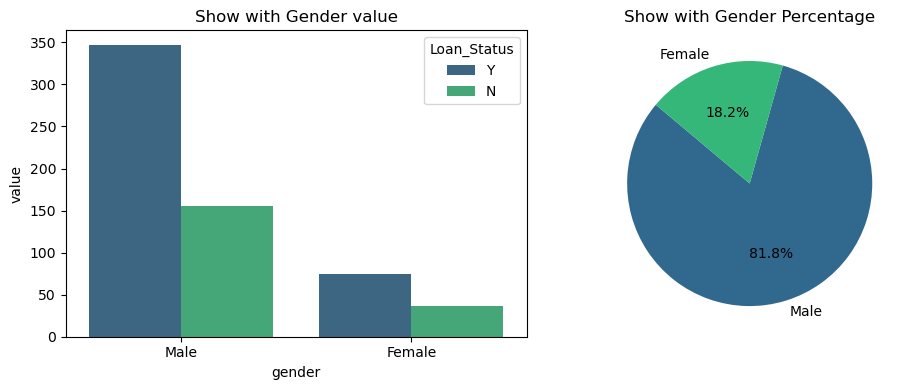

In [280]:
# Lets check Gender wise loan status
gender_percentage = data['Gender'].value_counts(normalize=True) * 100
fig, ax = plt.subplots(1, 2, figsize=(10,4))

sns.countplot(x='Gender',data=data,hue='Loan_Status', palette='viridis', ax=ax[0])
ax[0].set_title('Show with Gender value')
ax[0].set_xlabel('gender')
ax[0].set_ylabel('value')

ax[1].pie(gender_percentage, labels=gender_percentage.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette('viridis', len(gender_percentage)))
ax[1].set_title('Show with Gender Percentage')

plt.tight_layout()

plt.show()


here we see 81% applicant is male for approved loan rest are Female.

In [281]:
pd.crosstab(data['Gender'],data["Loan_Status"], margins=True).style.background_gradient(cmap='cool_r')

Loan_Status,N,Y,All
Gender,,,
Female,37,75,112
Male,155,347,502
All,192,422,614


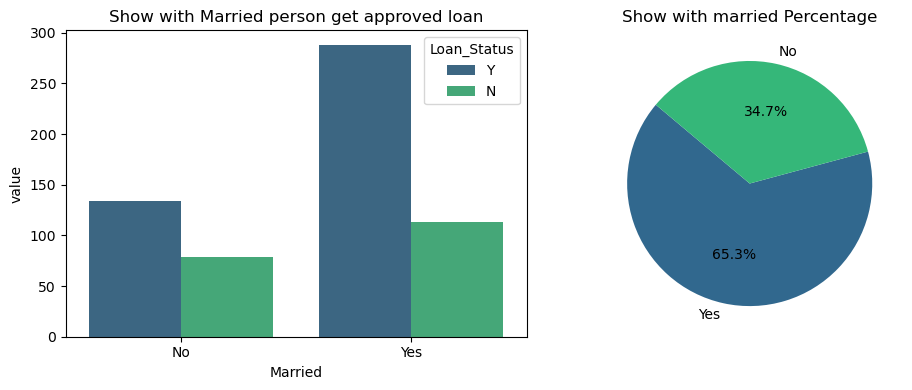

In [282]:
# Lets check Married wise loan status
married_percentage = data['Married'].value_counts(normalize=True) * 100
fig, ax = plt.subplots(1, 2, figsize=(10,4))

sns.countplot(x='Married',data=data,hue='Loan_Status', palette='viridis', ax=ax[0])
ax[0].set_title('Show with Married person get approved loan')
ax[0].set_xlabel('Married')
ax[0].set_ylabel('value')

ax[1].pie(married_percentage, labels=married_percentage.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette('viridis', len(married_percentage)))
ax[1].set_title('Show with married Percentage')

plt.tight_layout()

plt.show()


In [283]:
pd.crosstab([data['Gender'],data['Married']],data["Loan_Status"], margins=True).style.background_gradient(cmap='Blues_r')

###### Comment:
    65 % loan applicants are married. We can see from Count plot that Married people have more possibility of getting loan approval.
    But Here comes Interesting observation from crosstab :
    Unmarried Female are more chances of getting loan approval compare to married female.
    Married Male are more chances of loan approval.

###### Lets check dependent number:

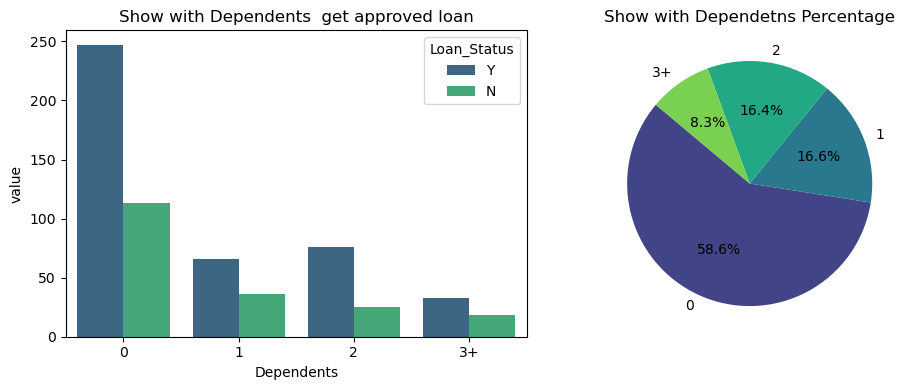

In [284]:
# Lets check dependent on loan status
dependent_percentage = data['Dependents'].value_counts(normalize=True) * 100
fig, ax = plt.subplots(1, 2, figsize=(10,4))

sns.countplot(x='Dependents',data=data,hue='Loan_Status', palette='viridis', ax=ax[0])
ax[0].set_title('Show with Dependents  get approved loan')
ax[0].set_xlabel('Dependents')
ax[0].set_ylabel('value')

ax[1].pie(dependent_percentage, labels=dependent_percentage.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette('viridis', len(dependent_percentage)))
ax[1].set_title('Show with Dependetns Percentage')
 
plt.tight_layout()

plt.show()

###### Education V/s Loan Status

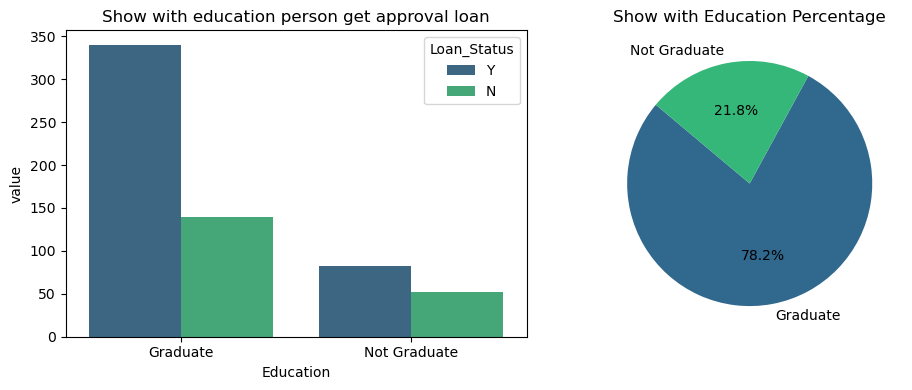

In [285]:
# Lets check Educated V/s loan status
Eduate_percentage = data['Education'].value_counts(normalize=True) * 100
fig, ax = plt.subplots(1, 2, figsize=(10,4))

sns.countplot(x='Education',data=data,hue='Loan_Status', palette='viridis', ax=ax[0])
ax[0].set_title('Show with education person get approval loan')
ax[0].set_xlabel('Education')
ax[0].set_ylabel('value')

ax[1].pie(Eduate_percentage, labels=Eduate_percentage.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette('viridis', len(Eduate_percentage)))
ax[1].set_title('Show with Education Percentage')

plt.tight_layout()

plt.show()

here we see the Graduate person 78.2% to get loan approval.

In [286]:
 pd.crosstab([data['Education'],data['Gender']],[data.Loan_Status],margins=True).style.background_gradient(cmap='crest_r')

here we see Graduate Male more get approval loan compare to graduate female and Not Graduate Female is very low to get loan approval.

###### ApplicantIncome V/s Loan status

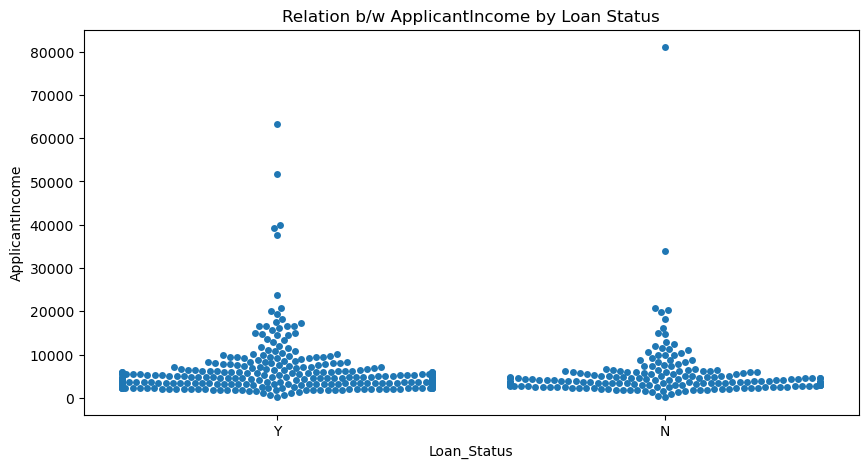

In [287]:
# Correlation and Distribution: Swarm Plot
plt.figure(figsize=(10, 5))
sns.swarmplot(x='Loan_Status', y='ApplicantIncome', data=data)
plt.title('Relation b/w ApplicantIncome by Loan Status')
plt.show()

here we see whose applicant income less than 20000 more likely to get loan aprroval.

###### Property Area v/s Loan Status

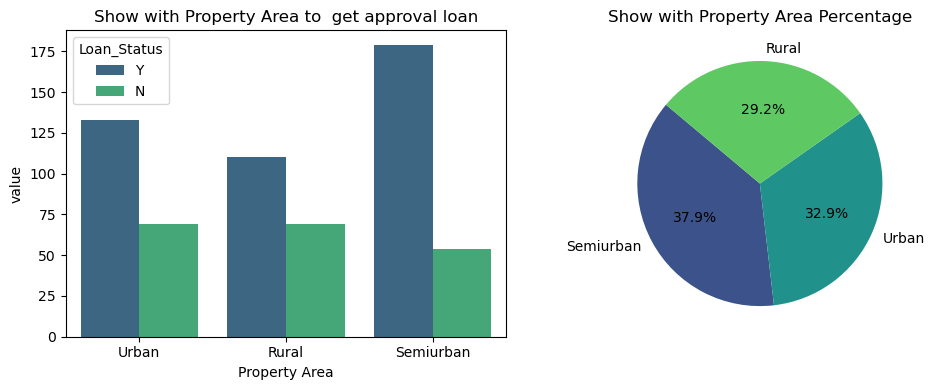

In [288]:
property_percentage = data['Property_Area'].value_counts(normalize=True) * 100
fig, ax = plt.subplots(1, 2, figsize=(10,4))

sns.countplot(x='Property_Area',data=data,hue='Loan_Status', palette='viridis', ax=ax[0])
ax[0].set_title('Show with Property Area to  get approval loan')
ax[0].set_xlabel('Property Area')
ax[0].set_ylabel('value')

ax[1].pie(property_percentage, labels=property_percentage.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette('viridis', len(property_percentage)))
ax[1].set_title('Show with Property Area Percentage')

plt.tight_layout()

plt.show()

here we see semiurban area more likely person to get loan approval.

###### Check value for Loan Status

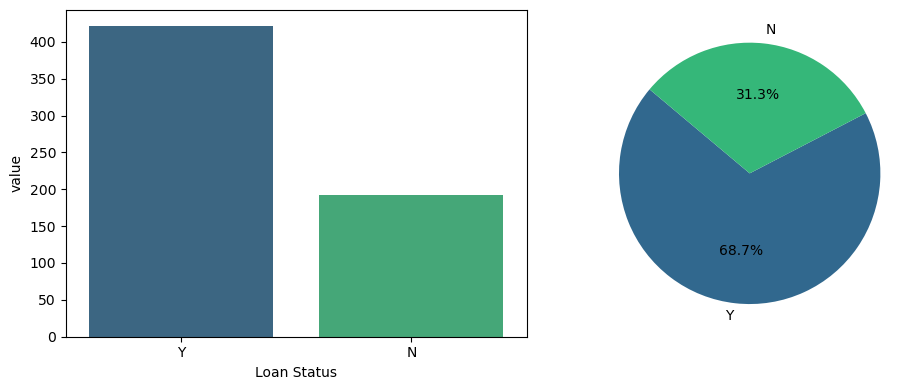

In [289]:
status_percentage = data['Loan_Status'].value_counts(normalize=True) * 100
fig, ax = plt.subplots(1, 2, figsize=(10,4))

sns.countplot(x='Loan_Status',data=data, palette='viridis', ax=ax[0])
ax[0].set_xlabel('Loan Status')
ax[0].set_ylabel('value')

ax[1].pie(status_percentage, labels=status_percentage.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette('viridis', len(status_percentage)))

plt.tight_layout()

plt.show()


    here we see for target Variable 68.7% to get loan and 31% not to get loan.
    this is imbalanced and furthor we will remove the imbalanced problem by SMOTE.


In [290]:
# Convert in categorical and numerical feature.
numeric=[]
category=[]
for col in data:
    if data[col].dtype=='object':
        category.append(col)
    else:
        numeric.append(col)
        

##### Check the Outliers with boxplot

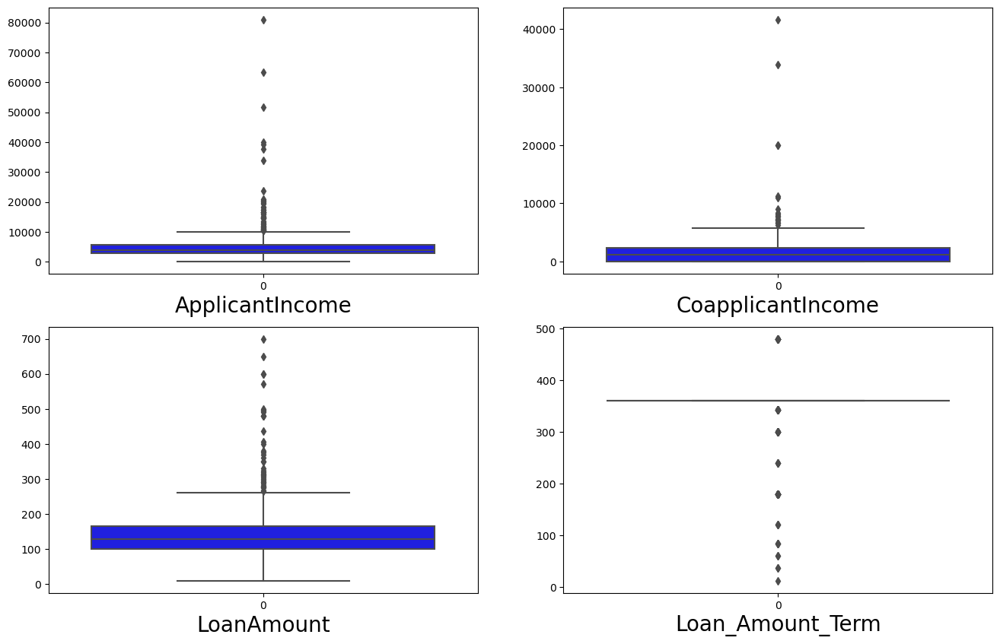

In [291]:
plt.figure(figsize=(16,10), facecolor='white')
col_no =1
for col in numeric:
    if col_no <=4:
        ax = plt.subplot(2,2,col_no)
        sns.boxplot(data[col], color='b')
        plt.xlabel(col,fontsize=20)
    col_no +=1
plt.show()

here we see all above column contain outliers.

##### Encoded categorical column

In [292]:
# Using Label Encoder on target variable
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
for col in data.columns:
    if data[col].dtype=='object':
        data[col]=le.fit_transform(data[col])

In [293]:
from scipy.stats import zscore
z = np.abs(zscore(data))
threshold = 3
df = data[(z<3).all(axis = 1)]

print ("Shape of the dataframe before removing outliers: ", data.shape)
print ("Shape of the dataframe after removing outliers: ", df.shape)
print ("Percentage of data loss post outlier removal: ", (data.shape[0]-df.shape[0])/data.shape[0]*100)

Shape of the dataframe before removing outliers:  (614, 12)
Shape of the dataframe after removing outliers:  (577, 12)
Percentage of data loss post outlier removal:  6.026058631921824


##### Checked the skewness

In [294]:
df.skew()

Gender              -1.622920
Married             -0.630211
Dependents           1.052106
Education            1.306588
Self_Employed        2.252848
ApplicantIncome      2.148522
CoapplicantIncome    1.350517
LoanAmount           1.151525
Loan_Amount_Term    -2.077031
Credit_History      -1.976043
Property_Area       -0.055332
Loan_Status         -0.822635
dtype: float64

    The skewness range is (-0.5 to 0.5) correct. but here we see Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Loan_Status  have + or - skewness.

###### Lets check skewness with diagram.

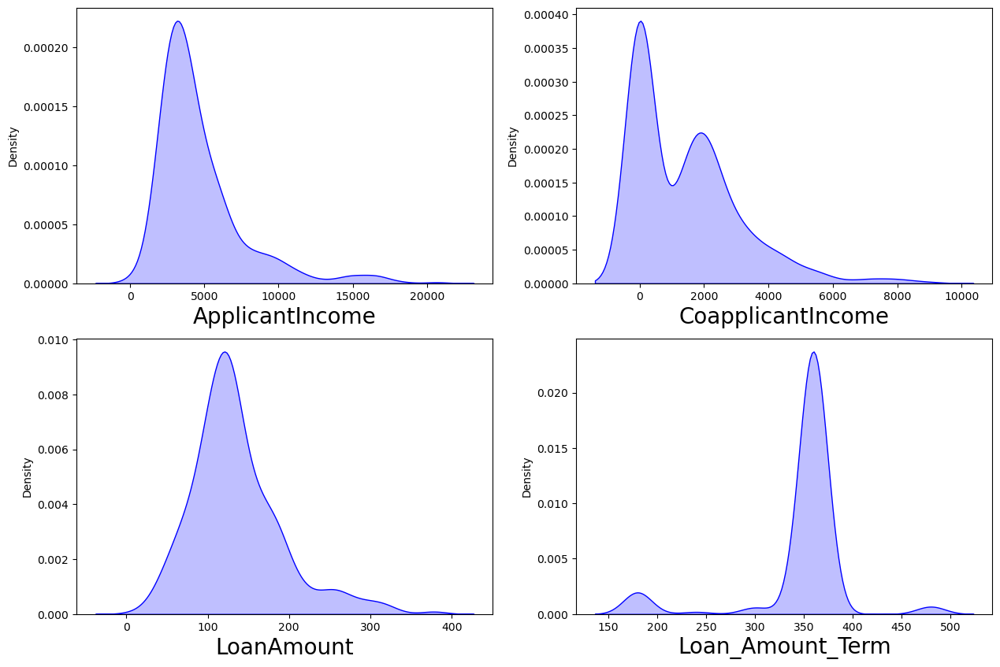

In [295]:
plt.figure(figsize=(15,10), facecolor='white')
col_no =1
for col in numeric:
    if col_no <=4:
        ax = plt.subplot(2,2,col_no)
        sns.kdeplot(df[col], color='b',shade=True)
        plt.xlabel(col,fontsize=20)
    col_no +=1
plt.show()

In [296]:
# Lets remove the skewness with yeo-johnson
from sklearn.preprocessing import PowerTransformer

pt = PowerTransformer(method='yeo-johnson')
def rm_skew(col):
    df[col] = pt.fit_transform(df[[col]])
skew_column=['ApplicantIncome','CoapplicantIncome','LoanAmount','Loan_Amount_Term']
for col in skew_column:
    rm_skew(col)

##### Check the correlation

In [297]:
df.corr()

,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
Gender,1.000000,0.378997,0.188162,0.045696,-0.006207,0.058590,0.234551,0.172146,-0.097638,0.013172,-0.026340,0.017408
Married,0.378997,1.000000,0.329900,0.024817,-0.015779,-0.024783,0.335820,0.181878,-0.128208,0.019308,0.010595,0.089026
Dependents,0.188162,0.329900,1.000000,0.069814,0.044543,0.105994,0.004109,0.131772,-0.074341,-0.020288,0.002327,0.017872
Education,0.045696,0.024817,0.069814,1.000000,-0.007139,-0.176074,0.049739,-0.128715,-0.067928,-0.075217,-0.068596,-0.092658
Self_Employed,-0.006207,-0.015779,0.044543,-0.007139,1.000000,0.212260,-0.087338,0.117218,-0.052342,-0.016390,-0.028253,-0.026525
ApplicantIncome,0.058590,-0.024783,0.105994,-0.176074,0.212260,1.000000,-0.360946,0.432154,-0.088056,0.028825,-0.011364,-0.002484
CoapplicantIncome,0.234551,0.335820,0.004109,0.049739,-0.087338,-0.360946,1.000000,0.200081,-0.002204,0.006564,-0.074476,0.079344
LoanAmount,0.172146,0.181878,0.131772,-0.128715,0.117218,0.432154,0.200081,1.000000,0.025068,-0.003626,-0.098090,-0.023609
Loan_Amount_Term,-0.097638,-0.128208,-0.074341,-0.067928,-0.052342,-0.088056,-0.002204,0.025068,1.000000,0.008534,-0.032706,-0.053447
Credit_History,0.013172,0.019308,-0.020288,-0.075217,-0.016390,0.028825,0.006564,-0.003626,0.008534,1.000000,-0.008121,0.560936


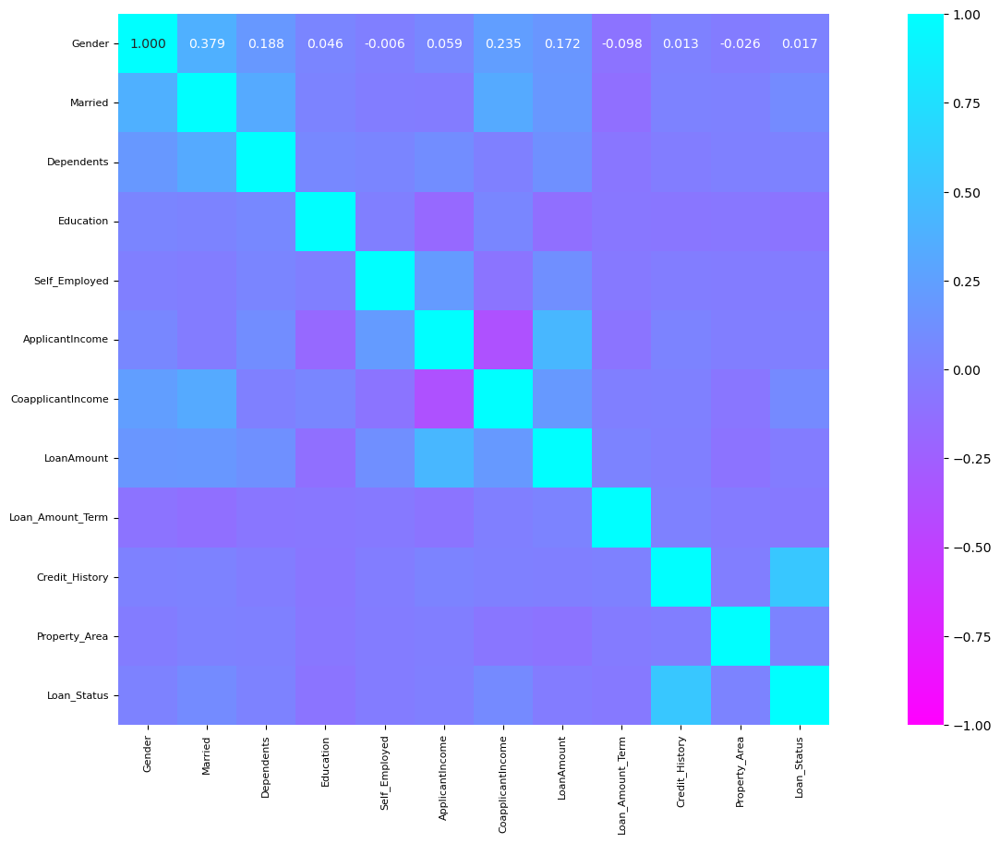

In [298]:
# Lets Visualize the correlation with heatmap
plt.figure(figsize=(22,10))
sns.heatmap(df.corr(), vmin=-1, vmax=1, annot=True, square=True, fmt='0.3f', 
            annot_kws={'size':10}, cmap="cool_r")
plt.xticks(fontsize=8)
plt.yticks(fontsize=8)
plt.show()

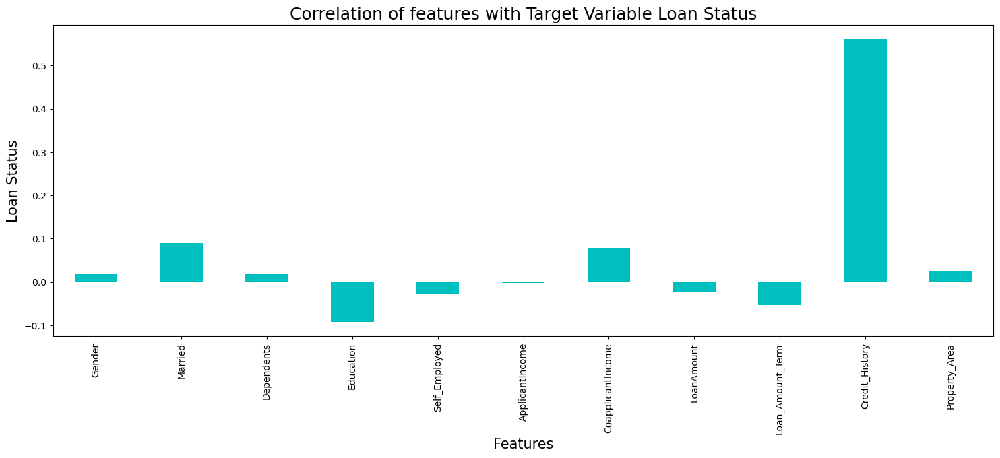

In [299]:
plt.figure(figsize = (18,6))
df.corr()['Loan_Status'].drop(['Loan_Status']).plot(kind='bar',color = 'c')
plt.xlabel('Features',fontsize=15)
plt.ylabel('Loan Status',fontsize=15)
plt.title('Correlation of features with Target Variable Loan Status',fontsize = 18)
plt.show()

#### Separate feature and label

In [300]:
X=df.drop(['Loan_Status'],axis=1)

In [301]:
Y=df['Loan_Status']

In [302]:
print(f"Shape of feature {X.shape}")
print(f"Shape of Label {Y.shape}")

Shape of feature (577, 11)
Shape of Label (577,)


#### Balancing Imbalanced problem

In [303]:
from imblearn.over_sampling import SMOTE
# Oversampleing using SMOTE Techniques
oversample = SMOTE()
X, Y = oversample.fit_resample(X, Y)

##### Checked shape after solved imbalanced problem

In [304]:
# after remove imbalan ced class
print(f"Shape of feature {X.shape}")
print(f"Shape of Label {Y.shape}")

Shape of feature (796, 11)
Shape of Label (796,)


In [305]:
# Y value
Y.value_counts()

Loan_Status
1    398
0    398
Name: count, dtype: int64

#### Using Standard Scalar

In [306]:
from sklearn.preprocessing import StandardScaler
sc=StandardScaler()
X=pd.DataFrame(sc.fit_transform(X),columns=X.columns)
X

,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area
0,0.495678,-1.206976,-0.684763,-0.497643,-0.324893,0.705141,-1.064784,-0.010802,0.081007,0.564419,1.311914
1,0.495678,0.828517,0.349528,-0.497643,-0.324893,0.242606,0.792735,-0.010802,0.081007,0.564419,-1.207467
2,0.495678,0.828517,-0.684763,-0.497643,3.077935,-0.545864,-1.064784,-1.460137,0.081007,0.564419,1.311914
3,0.495678,0.828517,-0.684763,2.009471,-0.324893,-0.819838,0.943670,-0.166323,0.081007,0.564419,1.311914
4,0.495678,-1.206976,-0.684763,-0.497643,-0.324893,0.753845,-1.064784,0.228542,0.081007,0.564419,1.311914
...,...,...,...,...,...,...,...,...,...,...,...
791,-2.017440,-1.206976,-0.684763,-0.497643,-0.324893,0.096723,-1.064784,-0.030791,0.081007,-1.891466,0.052223
792,0.495678,-1.206976,-0.684763,-0.497643,-0.324893,0.282252,0.897588,0.131043,0.081007,0.564419,0.052223
793,0.495678,0.828517,1.383818,-0.497643,-0.324893,-0.567881,0.890223,0.210497,0.081007,-1.891466,0.052223
794,0.495678,-1.206976,-0.684763,-0.497643,-0.324893,0.785240,1.102031,1.162902,0.081007,-1.286630,-1.207467


#### Checking Multicollinearity between features using variance_inflation_factor

In [307]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["VIF values"]=[variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif["Features"]=X.columns
vif

,VIF values,Features
0,1.245110,Gender
1,1.482981,Married
2,1.199580,Dependents
3,1.063813,Education
4,1.042445,Self_Employed
5,1.806143,ApplicantIncome
6,1.651681,CoapplicantIncome
7,1.707713,LoanAmount
8,1.073818,Loan_Amount_Term
9,1.021306,Credit_History


##### checked Using PCA

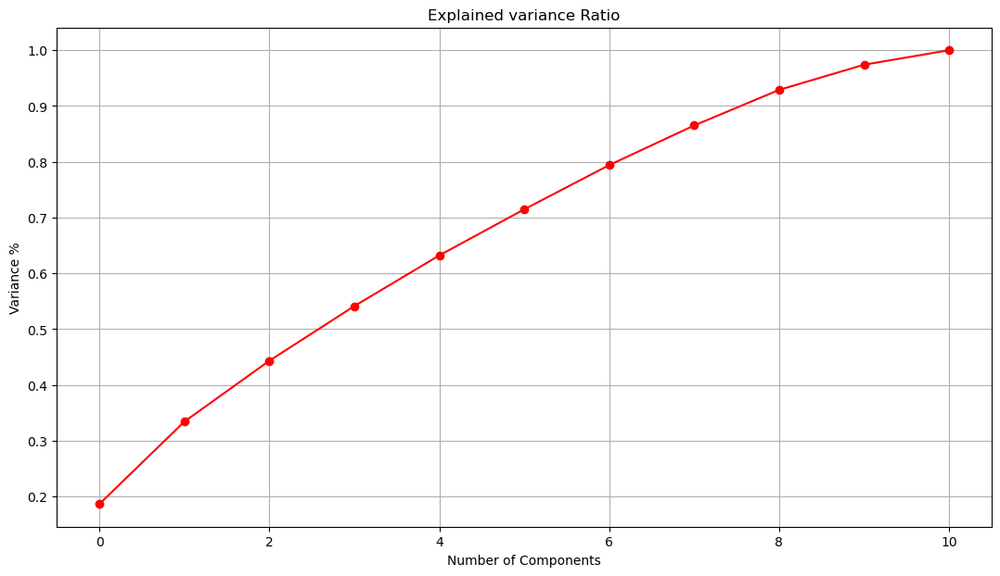

In [308]:
from sklearn.decomposition import PCA
pca = PCA()
#plot the graph to find the principal components
x = pca.fit_transform(X)
plt.figure(figsize=(13,7))
plt.plot(np.cumsum(pca.explained_variance_ratio_), 'ro-')
plt.xlabel('Number of Components')
plt.ylabel('Variance %')
plt.title('Explained variance Ratio')
plt.grid()

here we see all column is important for model prediction.

# Model Building For Classification Problem

In [309]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier as KNN
from sklearn.ensemble import ExtraTreesClassifier,GradientBoostingClassifier,AdaBoostClassifier,BaggingClassifier,RandomForestClassifier
from sklearn.svm import SVC
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report,confusion_matrix,roc_curve
from sklearn.linear_model import LogisticRegression

In [310]:
# Find the Random State for best Accuracy with Logistic Regression
Accuracy_max=0
Random_state_max=0
for random in range(1,100):
    x_train,x_test,y_train,y_test=train_test_split(X,Y,test_size=0.25,random_state=random)
    lr=LogisticRegression()
    lr.fit(x_train,y_train)
    pred=lr.predict(x_test)
    accuracy=accuracy_score(y_test,pred)
    if accuracy>Accuracy_max:
        Accuracy_max=accuracy
        Random_state_max=random
print(f"Best accuracy is: {Accuracy_max} at random_state: {Random_state_max}")

Best accuracy is: 0.8090452261306532 at random_state: 96


In [311]:
# Find the Random State for best Accuracy with Random Forest Classifier
Accuracy_max=0
Random_state_max=0
for random in range(1,100):
    x_train,x_test,y_train,y_test=train_test_split(X,Y,test_size=0.25,random_state=random)
    RFC=RandomForestClassifier()
    RFC.fit(x_train,y_train)
    pred=RFC.predict(x_test)
    accuracy=accuracy_score(y_test,pred)
    if accuracy>Accuracy_max:
        Accuracy_max=accuracy
        Random_state_max=random
print(f"Best accuracy is: {Accuracy_max} at random_state: {Random_state_max}")

Best accuracy is: 0.8743718592964824 at random_state: 68


So here we observe that Random forest Classifier have best accuracy with 68 random state.

In [314]:
x_train,x_test,y_train,y_test=train_test_split(X,Y,test_size=0.25,random_state=68)

In [315]:
all_model=[LogisticRegression,RandomForestClassifier,GradientBoostingClassifier,AdaBoostClassifier,BaggingClassifier,DecisionTreeClassifier,KNN,SVC]
for model in all_model:
    obj=model()
    obj.fit(x_train,y_train)
    predict=obj.predict(x_test)
    pred_train= obj.predict(x_train)
    print(f"-------------Accuracy with {str (model)}-----------------")
    print("Accuracy :",accuracy_score(y_test,predict))
    print("Acuracy on trained data :",accuracy_score(y_train,pred_train)*100)
    print(confusion_matrix(y_test,predict))
    print(classification_report(y_test,predict))
    
    print(f"*******Check the validation Score***********")
    score=cross_val_score(obj,X,Y,cv=10)
    print(score)
    print('val-score : ',score.mean())
    print(f"Difference between Accuracy score and cross validation score is : {accuracy_score(y_test,predict)-score.mean()}")
    print()

-------------Accuracy with <class 'sklearn.linear_model._logistic.LogisticRegression'>-----------------
Accuracy : 0.7889447236180904
Acuracy on trained data : 73.53433835845897
[[ 53  28]
 [ 14 104]]
              precision    recall  f1-score   support

           0       0.79      0.65      0.72        81
           1       0.79      0.88      0.83       118

    accuracy                           0.79       199
   macro avg       0.79      0.77      0.77       199
weighted avg       0.79      0.79      0.78       199

*******Check the validation Score***********
[0.75       0.625      0.7125     0.7125     0.7125     0.8
 0.70886076 0.7721519  0.74683544 0.78481013]
val-score :  0.7325158227848101
Difference between Accuracy score and cross validation score is : 0.05642890083328034

-------------Accuracy with <class 'sklearn.ensemble._forest.RandomForestClassifier'>-----------------
Accuracy : 0.8341708542713567
Acuracy on trained data : 100.0
[[ 66  15]
 [ 18 100]]
              p

On basis of maximum score in cross validation of Random Forest Classifier. we will apply Hyperparameter tuning on RandomForestClassifier.|

In [316]:
from sklearn.model_selection import GridSearchCV

In [319]:
parameter = {
            'n_estimators' : [10,50,100,150,200],
            'criterion' : ['gini', 'entropy','log_loss'],
            'max_features':['sqrt','log2'],
            'ccp_alpha':[0.1,0.0,0.2,0.3],
             'class_weight' : ["balanced", "balanced_subsample"],
            'random_state':range(1,100)
             }

In [320]:
gcv = GridSearchCV(RandomForestClassifier(),parameter,verbose=3,cv=5)
gcv.fit(x_train,y_train)

Fitting 5 folds for each of 23760 candidates, totalling 118800 fits
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=1;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=1;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=1;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=1;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=1;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=2;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=13;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=13;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=13;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=24;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=24;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=24;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=24;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=25;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=25;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=37;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=37;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=37;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=37;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=37;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=38;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=49;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=50;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=50;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=50;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=50;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=50;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=61;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=61;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=62;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=62;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=62;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=62;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=74;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=74;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=74;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=74;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=74;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=75;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=85;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=86;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=86;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=86;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=86;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=86;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=97;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=98;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=98;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=98;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=98;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=98;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=10;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=10;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=10;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=10;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=11;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=11;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=21;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=21;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=21;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=21;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=21;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=22;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=32;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=32;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=32;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=32;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=32;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=33;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=43;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=43;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=43;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=43;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=43;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=44;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=54;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=54;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=54;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=54;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=55;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=55;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=65;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=65;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=65;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=65;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=66;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=66;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=76;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=76;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=76;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=77;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=77;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=77;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=87;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=87;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=87;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=87;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=88;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=88;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=98;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=98;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=98;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=98;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=98;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=99;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=10;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=10;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=10;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=10;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=10;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=11;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=21;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=21;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=21;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=21;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=21;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=22;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=32;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=32;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=32;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=32;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=32;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=33;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=42;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=43;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=43;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=43;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=43;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=43;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=53;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=53;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=54;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=54;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=54;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=54;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=64;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=64;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=65;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=65;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=65;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=65;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=75;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=75;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=75;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=76;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=76;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=76;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=86;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=86;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=86;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=86;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=87;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=87;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=97;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=97;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=97;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=97;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=98;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=98;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=9;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=9;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=9;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=9;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=9;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=10;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=19;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=20;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=20;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=20;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=20;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=20;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=30;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=30;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=31;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=31;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=31;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=31;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=41;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=41;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=41;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=42;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=42;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=42;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=52;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=52;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=52;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=52;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=53;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=53;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=63;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=63;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=63;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=63;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=63;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=64;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=73;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=74;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=74;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=74;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=74;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=74;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=84;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=84;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=85;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=85;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=85;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=85;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=95;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=95;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=95;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=96;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=96;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=96;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=7;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=7;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=7;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=7;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=8;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=8;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=18;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=18;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=18;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=18;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=18;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=19;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=28;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=29;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=29;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=29;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=29;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=29;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=39;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=39;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=40;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=40;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=40;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=40;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=50;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=50;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=50;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=51;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=51;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=51;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=61;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=61;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=61;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=61;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=62;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=62;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=72;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=72;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=72;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=72;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=72;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=73;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=82;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=83;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=83;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=83;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=83;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=83;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=93;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=93;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=94;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=94;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=94;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=94;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=7;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=7;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=7;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=7;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=7;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=8;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estima

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=20;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=20;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=20;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=20;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=21;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=21;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=32;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=32;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=32;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=33;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=33;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=33;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=43;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=43;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=43;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=44;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=44;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=44;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=56;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=56;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=56;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=56;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=56;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=57;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=67;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=67;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=67;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=68;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=68;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=68;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=79;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=79;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=80;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=80;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=80;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=80;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=92;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=92;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=92;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=92;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=93;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=93;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=4;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=4;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=4;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=4;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=5;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=5;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estima

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=15;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=15;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=15;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=16;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=16;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=16;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=26;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=26;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=27;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=27;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=27;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=27;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=37;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=37;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=37;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=38;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=38;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=38;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=48;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=48;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=48;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=49;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=49;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=49;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=59;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=59;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=60;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=60;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=60;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=60;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=70;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=70;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=71;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=71;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=71;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=71;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=81;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=81;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=81;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=82;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=82;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=82;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=92;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=92;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=92;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=92;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=93;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=93;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=4;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=4;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=4;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=4;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=4;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=5;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=14;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=15;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=15;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=15;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=15;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=15;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=25;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=25;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=26;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=26;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=26;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=26;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=36;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=36;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=36;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=37;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=37;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=37;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=47;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=47;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=47;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=47;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=48;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=48;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=58;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=58;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=58;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=58;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=58;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=59;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=68;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=69;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=69;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=69;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=69;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=69;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=79;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=79;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=80;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=80;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=80;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=80;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=90;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=90;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=91;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=91;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=91;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=91;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=2;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=2;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=2;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=3;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=3;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=3;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=13;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=13;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=13;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=13;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=14;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=14;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=24;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=24;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=24;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=24;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=24;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=25;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=34;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=35;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=35;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=35;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=35;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=35;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=45;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=45;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=46;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=46;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=46;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=46;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=56;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=56;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=56;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=57;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=57;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=57;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=67;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=67;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=67;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=67;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=68;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=68;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=78;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=78;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=78;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=78;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=78;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=79;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=88;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=89;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=89;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=89;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=89;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=89;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=99;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=99;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=1;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=1;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=1;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=1;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=11;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=11;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=11;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=12;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=12;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=12;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=22;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=22;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=22;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=22;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=23;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=23;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=33;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=33;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=33;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=33;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=33;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=34;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=43;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=44;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=44;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=44;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=44;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=44;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=54;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=54;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=55;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=55;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=55;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=55;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=65;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=65;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=65;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=66;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=66;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=66;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=76;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=76;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=76;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=76;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=77;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=77;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=87;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=87;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=87;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=87;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=87;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=88;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=97;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=98;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=98;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=98;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=98;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=98;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=11;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=11;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=12;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=12;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=12;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=12;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=23;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=24;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=24;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=24;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=24;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=24;, score=0.723 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=36;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=36;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=36;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=36;, score=0.697 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=37;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=37;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=48;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=48;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=48;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=49;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=49;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=49;, score=0.790 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=59;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=59;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=59;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=59;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=60;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=60;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=71;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=71;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=71;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=72;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=72;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=72;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=82;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=82;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=83;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=83;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=83;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=83;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=95;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=95;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=95;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=95;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=96;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=96;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=7;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=7;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=7;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=8;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=8;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=8;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_fe

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=18;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=18;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=18;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=18;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=18;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=19;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=29;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=29;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=29;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=29;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=29;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=30;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=39;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=39;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=40;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=40;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=40;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=40;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=50;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=50;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=50;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=51;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=51;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=51;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=61;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=61;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=61;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=62;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=62;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=62;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=72;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=72;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=72;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=72;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=72;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=73;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=83;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=83;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=83;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=83;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=83;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=84;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=94;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=94;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=94;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=94;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=94;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=95;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=5;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=6;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=6;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=6;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=6;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=6;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=16;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=16;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=16;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=17;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=17;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=17;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=27;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=27;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=27;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=27;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=27;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=28;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=37;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=37;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=38;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=38;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=38;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=38;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=48;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=48;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=48;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=48;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=49;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=49;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=58;, score=0.723 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=59;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=59;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=59;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=59;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=59;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=69;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=69;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=70;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=70;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=70;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=70;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=80;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=80;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=80;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=81;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=81;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=81;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=91;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=91;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=91;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=91;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=91;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=92;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=2;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=2;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=3;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=3;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=3;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=3;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=13;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=13;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=13;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=13;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=14;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=14;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=23;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=24;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=24;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=24;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=24;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=24;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=34;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=34;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=34;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=35;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=35;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=35;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=45;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=45;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=45;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=45;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=45;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=46;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=55;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=55;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=56;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=56;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=56;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=56;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=66;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=66;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=66;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=66;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=67;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=67;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=76;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=77;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=77;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=77;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=77;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=77;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=87;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=87;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=87;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=88;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=88;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=88;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=98;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=98;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=98;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=98;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=98;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=99;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=9;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=9;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=10;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=10;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=10;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=10;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entro

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=20;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=20;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=20;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=20;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=21;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=21;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=30;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=31;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=31;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=31;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=31;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=31;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=41;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=41;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=41;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=42;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=42;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=42;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=52;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=52;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=52;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=52;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=52;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=53;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=62;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=62;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=63;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=63;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=63;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=63;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=73;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=73;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=73;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=73;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=74;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=74;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=83;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=84;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=84;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=84;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=84;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=84;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=94;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=94;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=94;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=95;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=95;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=95;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=6;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=7;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=7;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=7;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=7;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=7;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_fe

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=19;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=19;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=20;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=20;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=20;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=20;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=31;, score=0.765 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=31;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=31;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=32;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=32;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=32;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=43;, score=0.725 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=43;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=43;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=43;, score=0.655 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=43;, score=0.723 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=44;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=55;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=55;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=55;, score=0.723 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=56;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=56;, score=0.700 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=56;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=67;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=68;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=68;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=68;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=68;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=68;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=79;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=79;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=79;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=79;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=79;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=80;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=89;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=89;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=90;, score=0.725 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=90;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=90;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=90;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=1;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=1;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=2;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=2;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=2;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=2;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_fe

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=12;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=13;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=13;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=13;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=13;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=13;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=23;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=24;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=24;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=24;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=24;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=24;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=34;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=35;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=35;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=35;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=35;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=35;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=45;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=45;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=45;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=46;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=46;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=46;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=56;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=56;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=56;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=56;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=57;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=57;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=67;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=67;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=67;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=67;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=67;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=68;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=77;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=78;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=78;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=78;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=78;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=78;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=88;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=89;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=89;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=89;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=89;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=89;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=99;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=99;, score=0.723 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=1;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=1;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=1;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=1;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=11;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=11;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=11;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=11;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=12;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=12;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=22;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=22;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=22;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=22;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=22;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=23;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=32;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=32;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=33;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=33;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=33;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=33;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=43;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=43;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=43;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=43;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=44;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=44;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=53;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=54;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=54;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=54;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=54;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=54;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=64;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=64;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=64;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=65;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=65;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=65;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=75;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=75;, score=0.782 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=75;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=75;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=76;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=76;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=86;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=86;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=86;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=86;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=86;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=87;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=96;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=97;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=97;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=97;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=97;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=97;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=8;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=8;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=8;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=9;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=9;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=9;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=19;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=19;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=19;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=19;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=19;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=20;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=29;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=29;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=30;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=30;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=30;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=30;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=40;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=40;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=40;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=40;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=41;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=41;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=50;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=51;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=51;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=51;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=51;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=51;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=61;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=61;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=61;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=62;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=62;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=62;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=72;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=72;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=72;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=72;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=72;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=73;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=82;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=82;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=83;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=83;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=83;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=83;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=93;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=93;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=93;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=93;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=94;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=94;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=4;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=5;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=5;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=5;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=5;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=5;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=15;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=15;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=15;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=16;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=16;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=16;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=26;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=26;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=26;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=26;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=26;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=27;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=36;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=36;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=37;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=37;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=37;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=37;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=47;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=47;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=47;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=47;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=48;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=48;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=57;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=58;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=58;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=58;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=58;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=58;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=68;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=68;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=68;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=69;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=69;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=69;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=79;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=79;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=79;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=79;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=79;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=80;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=89;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=89;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=90;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=90;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=90;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=90;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=2;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=3;, score=0.725 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=3;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=3;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=3;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=3;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss,

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=14;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=15;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=15;, score=0.700 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=15;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=15;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=15;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=26;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=26;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=26;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=26;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=26;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=27;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=37;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=37;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=37;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=37;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=38;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=38;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=48;, score=0.692 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=48;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=48;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=48;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=48;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=49;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=59;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=59;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=59;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=59;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=60;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=60;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=70;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=70;, score=0.708 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=70;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=70;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=70;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=71;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=81;, score=0.706 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=81;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=82;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=82;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=82;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=82;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=93;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=93;, score=0.723 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=94;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=94;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=94;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=94;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=5;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=5;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=5;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=6;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=6;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=6;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss,

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=16;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=16;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=16;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=16;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=16;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=17;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=26;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=26;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=27;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=27;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=27;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=27;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=37;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=37;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=37;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=37;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=38;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=38;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=47;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=48;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=48;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=48;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=48;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=48;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=58;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=59;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=59;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=59;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=59;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=59;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=69;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=69;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=69;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=70;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=70;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=70;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=80;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=80;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=80;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=80;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=81;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=81;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=91;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=91;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=91;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=91;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=92;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=92;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=3;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=3;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=3;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=3;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=3;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=4;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=13;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=14;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=14;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=14;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=14;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=14;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=24;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=24;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=24;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=25;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=25;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=25;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=35;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=35;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=35;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=35;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=35;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=36;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=45;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=46;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=46;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=46;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=46;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=46;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=56;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=56;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=56;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=57;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=57;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=57;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=67;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=67;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=67;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=67;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=68;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=68;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=77;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=78;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=78;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=78;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=78;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=78;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=88;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=88;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=88;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=89;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=89;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=89;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=99;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=99;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=99;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=99;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=1;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=1;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=10;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=11;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=11;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=11;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=11;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=11;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=21;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=21;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=21;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=22;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=22;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=22;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=32;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=32;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=32;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=32;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=32;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=33;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=42;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=42;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=43;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=43;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=43;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=43;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=53;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=53;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=53;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=53;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=54;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=54;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=63;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=64;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=64;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=64;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=64;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=64;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=74;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=74;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=74;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=75;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=75;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=75;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=85;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=85;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=85;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=85;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=85;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=86;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=95;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=95;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=96;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=96;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=96;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=96;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=7;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=7;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=7;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=7;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=8;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=8;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=17;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=18;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=18;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=18;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=18;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=18;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=28;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=28;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=28;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=29;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=29;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=29;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=39;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=39;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=39;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=39;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=39;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=40;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=49;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=49;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=50;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=50;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=50;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=50;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=60;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=60;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=60;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=60;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=61;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=61;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=70;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=71;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=71;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=71;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=71;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=71;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=81;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=81;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=81;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=82;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=82;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=82;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=92;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=92;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=92;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=92;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=92;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=93;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=5;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=5;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=5;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=5;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=6;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=6;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss,

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=16;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=16;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=16;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=16;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=17;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=17;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=28;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=28;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=28;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=28;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=29;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=29;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=40;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=40;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=41;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=41;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=41;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=41;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=53;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=53;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=53;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=53;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=53;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=54;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=65;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=65;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=66;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=66;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=66;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=66;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=76;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=76;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=76;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=77;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=77;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=77;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=87;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=87;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=88;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=88;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=88;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=88;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=98;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=98;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=98;, score=0.723 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=99;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=99;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=99;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=10;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=10;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=10;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=10;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=10;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=11;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=20;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=21;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=21;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=21;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=21;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=21;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=31;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=32;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=32;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=32;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=32;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=32;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=42;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=42;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=43;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=43;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=43;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=43;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=53;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=53;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=53;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=54;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=54;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=54;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=64;, score=0.725 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=64;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=64;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=64;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=64;, score=0.723 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=65;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=75;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=75;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=75;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=75;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=75;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=76;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=85;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=85;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=96;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=96;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=97;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=97;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=97;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=97;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=8;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=8;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=8;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=8;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=9;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=9;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=19;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=19;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=19;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=19;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=19;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=20;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=29;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=29;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=30;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=30;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=30;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=30;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=40;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=40;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=40;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=41;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=41;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=41;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=51;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=51;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=51;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=51;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=51;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=52;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=61;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=62;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=62;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=62;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=62;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=62;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=72;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=72;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=72;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=73;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=73;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=73;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=83;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=83;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=83;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=83;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=83;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=84;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=93;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=93;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=94;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=94;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=94;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=94;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=5;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=5;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=5;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=5;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=6;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=6;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=16;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=16;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=16;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=16;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=16;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=17;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=26;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=26;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=27;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=27;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=27;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=27;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=37;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=37;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=37;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=37;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=38;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=38;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=47;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=48;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=48;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=48;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=48;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=48;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=58;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=58;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=58;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=70;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=80;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=80;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=80;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=80;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=90;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=90;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=90;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=90;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=91;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=91;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=1;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=2;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=2;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=2;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=2;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=2;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=12;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=12;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=12;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=13;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=13;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=13;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=23;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=23;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=23;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=23;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=23;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=24;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=33;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=33;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=34;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=34;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=34;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=34;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=44;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=44;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=44;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=44;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=45;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=45;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=54;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=55;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=55;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=55;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=55;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=55;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=65;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=65;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=65;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=66;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=66;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=66;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=76;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=76;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=76;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=76;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=76;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=77;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=86;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=86;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=87;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=87;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=87;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=87;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=97;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=97;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=97;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=97;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=98;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=98;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=10;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=10;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=10;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=10;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=11;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=11;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=20;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=21;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=21;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=21;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=21;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=21;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=32;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=32;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=32;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=32;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=33;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=33;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=43;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=43;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=43;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=43;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=44;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=44;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=54;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=54;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=54;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=54;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=55;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=55;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=65;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=66;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=66;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=66;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=66;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=66;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=76;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=76;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=76;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=77;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=77;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=77;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=87;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=87;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=87;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=87;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=87;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=88;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=98;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=98;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=98;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=98;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=99;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=99;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=9;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=9;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=10;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=10;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=10;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=10;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, cl

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=19;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=20;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=20;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=20;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=20;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=20;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=30;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=30;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=30;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=30;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=31;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=31;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=40;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=40;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=41;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=41;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=41;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=41;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=51;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=51;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=51;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=51;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=51;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=52;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=61;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=61;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=61;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=62;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=62;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=62;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=71;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=71;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=72;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=72;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=72;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=72;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=82;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=82;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=82;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=82;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=83;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=83;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=92;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=92;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=92;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=93;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=93;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=93;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=3;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=3;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=4;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=4;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=4;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=4;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=13;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=14;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=14;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=14;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=14;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=14;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=24;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=24;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=24;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=24;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=25;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=25;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=34;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=34;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=34;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=35;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=35;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=35;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=44;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=44;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=45;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=45;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=45;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=45;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=54;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=55;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=55;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=55;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=55;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=55;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=65;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=65;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=65;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=65;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=66;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=66;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=75;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=75;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=75;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=76;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=76;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=76;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=85;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=86;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=86;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=86;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=86;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=86;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=96;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=96;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=96;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=96;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=96;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=97;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=7;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=7;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=7;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=7;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=8;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=8;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=17;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=17;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=17;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=18;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=18;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=18;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=27;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=27;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=28;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=28;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=28;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=28;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=37;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=38;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=38;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=38;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=38;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=38;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=48;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=48;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=48;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=48;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=48;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=49;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=58;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=58;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=58;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=58;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=59;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=59;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=68;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=68;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=68;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=69;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=69;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=69;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=78;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=78;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=79;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=79;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=79;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=79;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=88;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=89;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=89;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=89;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=89;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=89;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=99;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=99;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=99;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=99;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=99;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=1;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=10;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=10;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=10;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=10;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=11;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=11;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=20;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=20;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=20;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=21;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=21;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=21;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=30;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=30;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=31;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=31;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=31;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=31;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=40;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=41;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=41;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=41;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=41;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=41;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=51;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=51;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=51;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=51;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=51;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=52;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=61;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=61;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=61;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=61;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=62;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=62;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=71;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=71;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=71;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=72;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=72;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=72;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=81;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=81;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=82;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=82;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=82;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=82;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=91;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=92;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=92;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=92;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=92;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=92;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=3;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=3;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=3;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=3;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=3;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=4;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=13;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=13;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=13;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=13;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=14;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=14;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=24;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=24;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=24;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=24;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=25;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=25;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=35;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=35;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=36;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=36;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=36;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=36;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=47;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=47;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=47;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=48;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=48;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=48;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=57;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=58;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=58;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=58;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=58;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=58;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=69;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=69;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=69;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=69;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=69;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=70;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=80;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=81;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=81;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=81;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=81;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=81;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=91;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=91;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=91;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=92;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=92;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=92;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=2;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=2;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=3;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=3;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=3;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=3;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=13;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=13;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=13;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=13;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=13;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=14;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=24;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=24;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=33;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=33;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=33;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=34;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=34;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=34;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=43;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=43;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=44;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=44;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=44;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=44;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=54;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=54;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=54;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=54;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=54;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=55;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=64;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=64;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=65;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=65;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=65;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=65;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=75;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=75;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=75;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=75;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=75;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=76;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=85;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=85;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=85;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=85;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=86;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=86;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=95;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=95;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=96;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=96;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=96;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=96;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=7;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=7;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=7;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=7;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=7;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=8;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=17;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=17;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=17;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=18;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=18;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=18;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=27;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=28;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=28;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=28;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=28;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=28;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=38;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=38;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=38;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=38;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=38;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=39;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=48;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=48;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=48;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=49;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=49;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=49;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=58;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=58;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=59;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=59;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=59;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=59;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=68;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=69;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=69;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=69;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=69;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=69;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=79;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=79;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=79;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=79;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=80;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=80;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=89;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=89;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=90;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=90;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=90;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=90;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=99;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=1;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=1;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=1;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=1;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=1;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1,

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=11;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=11;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=11;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=11;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=11;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=12;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=21;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=21;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=21;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=21;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=22;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=22;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=31;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=31;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=31;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=32;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=32;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=32;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=41;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=41;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=42;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=42;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=42;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=42;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=51;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=52;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=52;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=52;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=52;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=52;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=62;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=62;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=62;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=62;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=62;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=63;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=72;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=72;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=72;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=72;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=73;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=73;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=82;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=82;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=82;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=83;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=83;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=83;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=92;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=92;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=93;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=93;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=93;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=93;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=3;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=4;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=4;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=4;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=4;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=4;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=14;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=14;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=14;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=14;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=14;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=15;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=24;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=24;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=24;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=24;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=25;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=25;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=34;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=34;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=34;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=35;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=35;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=35;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=44;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=44;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=45;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=45;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=45;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=45;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=54;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=55;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=55;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=55;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=55;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=55;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=65;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=65;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=65;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=65;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=65;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=66;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=75;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=75;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=75;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=75;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=76;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=76;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=85;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=85;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=85;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=86;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=86;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=86;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=95;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=95;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=96;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=96;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=96;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=96;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=7;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=8;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=8;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=8;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=8;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=8;, score=0.706 total time=   0.0s
[CV 1/5] END ccp

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=18;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=18;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=18;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=18;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=18;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=19;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=29;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=29;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=29;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=30;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=30;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=30;, score=0.782 total time=   0.0s
[CV 4/5] E

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=40;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=40;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=40;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=41;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=41;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=41;, score=0.773 total time=   0.0s
[CV 4/5] E

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=50;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=50;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=51;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=51;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=51;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=51;, score=0.765 total time=   0.0s
[CV 5/5] E

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=60;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=60;, score=0.723 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=61;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=61;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=61;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=61;, score=0.748 total time=   0.0s
[CV 5/5] E

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=72;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=72;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=72;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=72;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=73;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=73;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=82;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=82;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=82;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=83;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=83;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=83;, score=0.773 total time=   0.0s
[CV 4/5] E

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=94;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=94;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=94;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=94;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=94;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=95;, score=0.733 total time=   0.0s
[CV 2/5] E

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=5;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=5;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=5;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=5;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=6;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=6;, score=0.692 total time=   0.0s
[CV 3/5] END ccp

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=15;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=15;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=15;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=15;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=16;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=16;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=25;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=25;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=25;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=25;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=26;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=26;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=35;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=35;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=36;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=36;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=36;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=36;, score=0.748 total time=   0.0s
[CV 5/5] E

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=46;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=46;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=46;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=46;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=46;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=47;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=56;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=56;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=56;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=56;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=56;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=57;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=66;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=66;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=66;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=66;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=67;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=67;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=76;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=76;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=76;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=77;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=77;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=77;, score=0.773 total time=   0.0s
[CV 4/5] E

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=86;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=86;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=87;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=87;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=87;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=87;, score=0.748 total time=   0.1s
[CV 5/5] E

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=96;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=97;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=97;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=97;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=97;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=97;, score=0.706 total time=   0.0s
[CV 1/5] E

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=7;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=8;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=8;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=8;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=8;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=8;, score=0.706 total time=   0.1s
[CV 1/5] E

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=17;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=18;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=18;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=18;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=18;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=18;, score=0.706 total time=   0.1s
[CV 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=28;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=28;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=28;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=28;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=28;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=29;, score=0.717 total time=   0.2s
[CV 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=38;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=38;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=38;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=38;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=38;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=39;, score=0.717 total time=   0.2s
[CV 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=48;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=48;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=48;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=48;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=48;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=49;, score=0.717 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=58;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=58;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=58;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=58;, score=0.723 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=59;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=59;, score=0.692 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=68;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=68;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=68;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=68;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=69;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=69;, score=0.692 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=78;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=78;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=78;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=78;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=79;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=79;, score=0.692 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=88;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=88;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=88;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=88;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=89;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=89;, score=0.692 total time=   0.1s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=98;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=98;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=98;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=99;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=99;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=99;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=9;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=9;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=9;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=10;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=10;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=10;, score=0.773 total time=   0.2s
[CV 4/5

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=19;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=19;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=19;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=20;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=20;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=20;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=29;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=29;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=29;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=30;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=30;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=30;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=39;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=39;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=39;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=40;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=40;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=40;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=49;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=49;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=49;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=50;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=50;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=50;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=59;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=59;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=59;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=60;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=60;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=60;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=69;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=69;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=69;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=70;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=70;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=70;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=79;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=79;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=79;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=80;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=80;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=80;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=89;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=89;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=89;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=90;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=90;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=90;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=99;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=99;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=99;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=1;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=1;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=1;, score=0.773 total time=   0.3s
[CV 4/5

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=10;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=10;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=10;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=11;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=11;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=11;, score=0.773 total time=   0.4s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=20;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=20;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=20;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=21;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=21;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=21;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=30;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=30;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=30;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=31;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=31;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=31;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=40;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=40;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=40;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=41;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=41;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=41;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=50;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=50;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=50;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=51;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=51;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=51;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=60;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=60;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=60;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=61;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=61;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=61;, score=0.773 total time=   0.4s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=70;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=70;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=70;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=71;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=71;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=71;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=80;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=80;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=80;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=81;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=81;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=81;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=90;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=90;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=90;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=91;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=91;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=91;, score=0.773 total time=   0.3s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=2;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=3;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=3;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=3;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=3;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=3;, score=0.706 total time=   0.0s
[CV 1/5] END ccp

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=14;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=14;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=14;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=14;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=15;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=15;, score=0.700 total time=   0.0s
[CV 3/5] E

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=25;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=25;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=25;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=25;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=25;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=26;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=35;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=36;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=36;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=36;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=36;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=36;, score=0.723 total time=   0.0s
[CV 1/5] E

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=46;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=46;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=46;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=46;, score=0.723 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=47;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=47;, score=0.683 total time=   0.0s
[CV 3/5] E

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=57;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=57;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=57;, score=0.756 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=57;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=57;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=58;, score=0.725 total time=   0.0s
[CV 2/5] E

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=67;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=67;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=67;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=67;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=68;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=68;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=79;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=79;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=79;, score=0.790 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=79;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=79;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=80;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=90;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=90;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=90;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=90;, score=0.731 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=91;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=91;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=1;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=1;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=1;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=2;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=2;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=2;, score=0.773 total time=   0.0s
[CV 4/5] END ccp

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=11;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=11;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=12;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=12;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=12;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=12;, score=0.748 total time=   0.0s
[CV 5/5] E

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=21;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=22;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=22;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=22;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=22;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=22;, score=0.706 total time=   0.0s
[CV 1/5] E

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=32;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=32;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=32;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=32;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=32;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=33;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=42;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=42;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=42;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=42;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=42;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=43;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=52;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=52;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=52;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=53;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=53;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=53;, score=0.773 total time=   0.1s
[CV 4/5] E

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=62;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=62;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=62;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=63;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=63;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=63;, score=0.773 total time=   0.0s
[CV 4/5] E

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=72;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=72;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=72;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=73;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=73;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=73;, score=0.773 total time=   0.0s
[CV 4/5] E

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=82;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=83;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=83;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=83;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=83;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=83;, score=0.706 total time=   0.0s
[CV 1/5] E

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=93;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=93;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=93;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=93;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=94;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=94;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=4;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=4;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=4;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=4;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=5;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=5;, score=0.692 total time=   0.1s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=14;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=14;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=14;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=14;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=15;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=15;, score=0.692 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=24;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=24;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=24;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=24;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=25;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=25;, score=0.692 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=34;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=34;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=34;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=34;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=35;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=35;, score=0.692 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=44;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=44;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=44;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=44;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=45;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=45;, score=0.692 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=54;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=54;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=54;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=54;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=55;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=55;, score=0.692 total time=   0.1s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=64;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=64;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=64;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=65;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=65;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=65;, score=0.773 total time=   0.1s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=74;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=74;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=74;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=75;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=75;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=75;, score=0.773 total time=   0.1s
[CV 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=84;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=84;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=85;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=85;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=85;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=85;, score=0.748 total time=   0.1s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=94;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=95;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=95;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=95;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=95;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=95;, score=0.706 total time=   0.1s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=5;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=6;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=6;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=6;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=6;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=6;, score=0.706 total time=   0.3s
[CV 1/5] E

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=15;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=16;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=16;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=16;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=16;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=16;, score=0.706 total time=   0.2s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=25;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=26;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=26;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=26;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=26;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=26;, score=0.706 total time=   0.2s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=35;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=36;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=36;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=36;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=36;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=36;, score=0.706 total time=   0.2s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=45;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=46;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=46;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=46;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=46;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=46;, score=0.706 total time=   0.2s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=55;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=56;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=56;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=56;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=56;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=56;, score=0.706 total time=   0.2s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=65;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=66;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=66;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=66;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=66;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=66;, score=0.706 total time=   0.2s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=75;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=76;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=76;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=76;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=76;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=76;, score=0.706 total time=   0.3s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=85;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=86;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=86;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=86;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=86;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=86;, score=0.706 total time=   0.3s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=95;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=96;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=96;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=96;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=96;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=96;, score=0.706 total time=   0.3s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=6;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=7;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=7;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=7;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=7;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=7;, score=0.706 total time=   0.3s
[CV 1/5] E

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=16;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=17;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=17;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=17;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=17;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=17;, score=0.706 total time=   0.3s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=26;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=27;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=27;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=27;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=27;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=27;, score=0.706 total time=   0.4s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=36;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=37;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=37;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=37;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=37;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=37;, score=0.706 total time=   0.4s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=46;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=47;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=47;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=47;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=47;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=47;, score=0.706 total time=   0.3s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=56;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=57;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=57;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=57;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=57;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=57;, score=0.706 total time=   0.3s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=66;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=67;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=67;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=67;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=67;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=67;, score=0.706 total time=   0.3s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=76;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=77;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=77;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=77;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=77;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=77;, score=0.706 total time=   0.4s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=86;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=87;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=87;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=87;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=87;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=87;, score=0.706 total time=   0.3s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=96;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=97;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=97;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=97;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=97;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=97;, score=0.706 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=8;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=8;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=8;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=8;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=9;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=9;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=19;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=19;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=19;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=19;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=19;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=20;, score=0.717 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=29;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=29;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=30;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=30;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=30;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=30;, score=0.765 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=41;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=41;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=41;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=41;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=42;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=42;, score=0.692 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=52;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=52;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=52;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=52;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=52;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=53;, score=0.717 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=62;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=62;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=62;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=62;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=62;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=63;, score=0.717 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=72;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=72;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=72;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=73;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=73;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=73;, score=0.773 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=82;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=83;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=83;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=83;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=83;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=83;, score=0.706 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=93;, score=0.723 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=94;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=94;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=94;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=94;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=94;, score=0.706 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=5;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=5;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=5;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=5;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=6;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=6;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=15;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=15;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=15;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=16;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=16;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=16;, score=0.773 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=25;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=25;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=25;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=26;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=26;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=26;, score=0.773 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=35;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=35;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=36;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=36;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=36;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=36;, score=0.748 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=45;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=45;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=46;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=46;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=46;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=46;, score=0.748 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=55;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=55;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=56;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=56;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=56;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=56;, score=0.748 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=65;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=66;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=66;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=66;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=66;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=66;, score=0.706 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=76;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=76;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=76;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=76;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=76;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=77;, score=0.717 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=86;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=86;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=86;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=86;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=87;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=87;, score=0.692 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=96;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=96;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=97;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=97;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=97;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=97;, score=0.748 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=7;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=8;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=8;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=8;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=8;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=8;, score=0.706 total time=   0.1s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=17;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=18;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=18;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=18;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=18;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=18;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=27;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=28;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=28;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=28;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=28;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=28;, score=0.706 total time=   0.1

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=38;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=38;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=38;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=38;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=38;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=39;, score=0.717 total time=   0.1

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=48;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=48;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=48;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=48;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=48;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=49;, score=0.717 total time=   0.1

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=58;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=58;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=58;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=58;, score=0.723 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=59;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=59;, score=0.692 total time=   0.1

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=68;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=68;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=68;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=68;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=69;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=69;, score=0.692 total time=   0.1

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=78;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=78;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=78;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=78;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=79;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=79;, score=0.692 total time=   0.1

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=88;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=88;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=88;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=88;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=89;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=89;, score=0.692 total time=   0.1

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=98;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=98;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=98;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=98;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=99;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=99;, score=0.692 total time=   0.1

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=9;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=9;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=9;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=9;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=10;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=10;, score=0.692 total time=   0.2s
[C

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=19;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=19;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=19;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=19;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=20;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=20;, score=0.692 total time=   0.2

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=29;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=29;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=29;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=29;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=30;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=30;, score=0.692 total time=   0.2

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=39;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=39;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=39;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=39;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=40;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=40;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=49;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=49;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=49;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=49;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=50;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=50;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=59;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=59;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=59;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=59;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=60;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=60;, score=0.692 total time=   0.2

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=69;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=69;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=69;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=69;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=70;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=70;, score=0.692 total time=   0.2

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=79;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=79;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=79;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=79;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=80;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=80;, score=0.692 total time=   0.2

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=89;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=89;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=89;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=89;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=90;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=90;, score=0.692 total time=   0.2

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=99;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=99;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=99;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=99;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=1;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=1;, score=0.692 total time=   0.3s


[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=10;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=10;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=10;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=10;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=11;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=11;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=20;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=20;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=20;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=20;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=21;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=21;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=30;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=30;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=30;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=30;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=31;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=31;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=40;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=40;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=40;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=40;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=41;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=41;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=50;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=50;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=50;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=50;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=51;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=51;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=60;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=60;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=60;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=60;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=61;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=61;, score=0.692 total time=   0.4

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=70;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=70;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=70;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=70;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=71;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=71;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=80;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=80;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=80;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=80;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=81;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=81;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=90;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=90;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=90;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=90;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=91;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=91;, score=0.692 total time=   0.3

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=2;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=3;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=3;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=3;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=3;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=3;, score=0.706 total time=   0.0s
[CV 1/5] E

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=13;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=13;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=13;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=13;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=14;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=14;, score=0.692 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=24;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=25;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=25;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=25;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=25;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=25;, score=0.706 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=36;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=36;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=36;, score=0.723 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=37;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=37;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=37;, score=0.773 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=47;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=47;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=47;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=47;, score=0.639 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=48;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=48;, score=0.692 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=58;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=58;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=58;, score=0.739 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=59;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=59;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=59;, score=0.773 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=69;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=70;, score=0.692 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=70;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=70;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=70;, score=0.723 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=70;, score=0.706 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=81;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=81;, score=0.706 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=81;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=82;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=82;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=82;, score=0.773 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=92;, score=0.731 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=92;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=93;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=93;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=93;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=93;, score=0.765 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=5;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=14;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=14;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=14;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=14;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=14;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=15;, score=0.717 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=24;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=24;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=24;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=24;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=25;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=25;, score=0.692 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=34;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=34;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=34;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=35;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=35;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=35;, score=0.773 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=44;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=45;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=45;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=45;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=45;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=45;, score=0.706 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=55;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=55;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=55;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=55;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=55;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=56;, score=0.717 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=65;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=65;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=65;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=65;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=65;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=66;, score=0.717 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=75;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=75;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=75;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=75;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=76;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=76;, score=0.692 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=85;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=85;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=85;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.773 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=95;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=95;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=96;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=96;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=96;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=96;, score=0.748 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=6;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=6;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=7;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=7;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=7;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=7;, score=0.748 total time=   0.1s
[CV 

[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=16;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=16;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.748 total time=   0.1

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=26;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=27;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=27;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=27;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=27;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=27;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=36;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=37;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=37;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=37;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=37;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=37;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=46;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=47;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=47;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=47;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=47;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=47;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=56;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=57;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=57;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=57;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=57;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=57;, score=0.706 total time=   0.1

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=67;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=67;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=67;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=67;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=67;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=68;, score=0.717 total time=   0.1

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=77;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=77;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=77;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=77;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=77;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=78;, score=0.717 total time=   0.1

[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=87;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=87;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=87;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=87;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=87;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=88;, score=0.717 total time=   0.1

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=97;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=97;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=97;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=97;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=98;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=98;, score=0.692 total time=   0.1

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=8;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=8;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=8;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=8;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.692 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=18;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=18;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=18;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=18;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.692 total time=   0.2

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=28;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=28;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=28;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=28;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.692 total time=   0.2

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=38;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=38;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=38;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=38;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=48;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=48;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=48;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=48;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=49;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=49;, score=0.692 total time=   0.2

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=58;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=58;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=58;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=58;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=68;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=68;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=68;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=68;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.692 total time=   0.2

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=78;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=78;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=78;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=78;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.692 total time=   0.2

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=88;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=88;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=88;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=88;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=98;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=98;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=98;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=98;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.692 total time=   0.2

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=9;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=9;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=9;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=9;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=10;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=10;, score=0.692 total time=   0.3s
[C

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=19;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=19;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=19;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=19;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=20;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=20;, score=0.692 total time=   0.4

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=29;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=29;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=29;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=29;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=30;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=30;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=39;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=39;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=39;, score=0.748 total time=   0.5s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=39;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=40;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=40;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=49;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=49;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=49;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=49;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=50;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=50;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=59;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=59;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=59;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=59;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=60;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=60;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=69;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=69;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=69;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=69;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=70;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=70;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=79;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=79;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=79;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=79;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=80;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=80;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=89;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=89;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=89;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=89;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.692 total time=   0.3

[CV 2/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=99;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=99;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=99;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.1, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=99;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=1;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=1;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, cl

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=11;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.667 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.824 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=24;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=24;, score=0.706 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=24;, score=0.739 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=25;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=25;, score=0.708 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=25;, score=0.798 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=35;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=36;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=36;, score=0.733 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=36;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=36;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=36;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=48;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=49;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=49;, score=0.725 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=49;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=49;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=49;, score=0.748 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=60;, score=0.733 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=60;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=60;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=60;, score=0.739 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=61;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=61;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=71;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=71;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=71;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=71;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=71;, score=0.748 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=72;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=82;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=83;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=83;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=83;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=83;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=83;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=95;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=95;, score=0.857 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=95;, score=0.723 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=95;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=96;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=96;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=7;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=7;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=7;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=7;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=8;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=8;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estima

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=18;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=18;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=18;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=18;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=19;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=19;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=29;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=29;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=29;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=29;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=29;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=30;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=39;, score=0.824 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=40;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=40;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=40;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=40;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=40;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=50;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=50;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=51;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=51;, score=0.792 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=51;, score=0.857 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=51;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=61;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=61;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=62;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=62;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=62;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=62;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=72;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=73;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=73;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=73;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=73;, score=0.815 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=73;, score=0.824 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=83;, score=0.807 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=83;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=84;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=84;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=84;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=84;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=94;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=94;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=94;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=95;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=95;, score=0.792 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=95;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=6;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=6;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=6;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=6;, score=0.840 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=7;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=7;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=17;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=17;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=17;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=17;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=17;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=18;, score=0.767 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=27;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=28;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=28;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=28;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=28;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=28;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=38;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=38;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=39;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=39;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=39;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=39;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=49;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=49;, score=0.782 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=50;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=50;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=50;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=50;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=60;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=60;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=60;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=61;, score=0.767 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=61;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=61;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=71;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=71;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=71;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=71;, score=0.832 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=72;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=72;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=82;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=82;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=82;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=82;, score=0.765 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=82;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=83;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=93;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=93;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=93;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=93;, score=0.765 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=93;, score=0.790 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=94;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=4;, score=0.790 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=5;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=5;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=5;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=5;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=5;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=15;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=15;, score=0.782 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=16;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=16;, score=0.792 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=16;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=16;, score=0.756 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=26;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=26;, score=0.756 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=26;, score=0.790 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=27;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=27;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=27;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=37;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=37;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=37;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=37;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=38;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=38;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=48;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=48;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=48;, score=0.798 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=48;, score=0.832 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=49;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=49;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=59;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=59;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=59;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=59;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=59;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=60;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=69;, score=0.832 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=70;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=70;, score=0.750 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=70;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=70;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=70;, score=0.824 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=80;, score=0.790 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=80;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=81;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=81;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=81;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=81;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=91;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=91;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=91;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=92;, score=0.767 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=92;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=92;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=3;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=3;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=3;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=3;, score=0.824 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=4;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=4;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=14;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=14;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=14;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=14;, score=0.798 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=14;, score=0.832 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=15;, score=0.742 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=24;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=25;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=25;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=25;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=25;, score=0.790 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=25;, score=0.824 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=35;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=35;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=36;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=36;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=36;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=36;, score=0.798 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=46;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=46;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=46;, score=0.832 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=47;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=47;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=47;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=57;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=57;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=57;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=57;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=58;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=58;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=68;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=68;, score=0.750 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=68;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=68;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=68;, score=0.824 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=69;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=78;, score=0.807 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=79;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=79;, score=0.792 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=79;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=79;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=79;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=89;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=89;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=90;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=90;, score=0.750 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=90;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=90;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=sq

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=3;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=3;, score=0.714 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=3;, score=0.739 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=4;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=4;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=4;, score=0.798 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estima

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=14;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=14;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=15;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=15;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=15;, score=0.857 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=15;, score=0.697 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=25;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=26;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=26;, score=0.733 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=26;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=26;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=26;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=39;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=39;, score=0.733 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=39;, score=0.882 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=39;, score=0.731 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=39;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=40;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=51;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=51;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=52;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=52;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=52;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=52;, score=0.714 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=62;, score=0.706 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=62;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=63;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=63;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=63;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=63;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=75;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=75;, score=0.866 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=75;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=75;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=76;, score=0.783 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=76;, score=0.725 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=88;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=88;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=88;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=88;, score=0.714 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=88;, score=0.731 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=89;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=99;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=99;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=99;, score=0.739 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=1;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=1;, score=0.792 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=1;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_est

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=11;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=12;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=12;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=12;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=12;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=12;, score=0.849 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=24;, score=0.725 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=34;, score=0.857 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=34;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=34;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=35;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=35;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=35;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=45;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=46;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=46;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=46;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=46;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=46;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=56;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=56;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=57;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=57;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=57;, score=0.857 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=57;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=67;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=68;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=68;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=68;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=68;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=68;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=78;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=79;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=79;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=79;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=79;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=79;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=90;, score=0.783 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=90;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=90;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=90;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=90;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=91;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=2;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=2;, score=0.792 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=2;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=2;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=2;, score=0.840 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=3;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=13;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=13;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=13;, score=0.815 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=13;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=13;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=14;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=23;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=24;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=24;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=24;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=24;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=24;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=34;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=34;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=35;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=35;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=35;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=35;, score=0.798 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=45;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=45;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=46;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=46;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=46;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=46;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=56;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=56;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=57;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=57;, score=0.742 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=57;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=57;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=67;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=67;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=67;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=68;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=68;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=68;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=78;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=78;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=78;, score=0.824 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=78;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=79;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=79;, score=0.792 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=89;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=89;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=89;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=89;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=89;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=90;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=99;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=1;, score=0.742 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=1;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=1;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=1;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=1;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=11;, score=0.824 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=12;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=12;, score=0.792 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=12;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=12;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=12;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=22;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=22;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=23;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=23;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=23;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=23;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=33;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=33;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=33;, score=0.765 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=34;, score=0.742 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=34;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=34;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=44;, score=0.792 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=44;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=44;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=44;, score=0.815 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=45;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=45;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=55;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=55;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=55;, score=0.815 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=55;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=55;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=56;, score=0.767 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=65;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=66;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=66;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=66;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=66;, score=0.765 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=66;, score=0.815 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.790 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=77;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=77;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=77;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=77;, score=0.798 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=87;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=87;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=88;, score=0.742 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=88;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=88;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=88;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=98;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=98;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=98;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=99;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=99;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=99;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=10;, score=0.750 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=10;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=10;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=10;, score=0.824 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=11;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=11;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=21;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=21;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=21;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=21;, score=0.765 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=21;, score=0.832 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=22;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=31;, score=0.824 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=32;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=32;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=32;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=32;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=32;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=42;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=42;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=43;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=43;, score=0.775 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=43;, score=0.815 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=43;, score=0.765 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=53;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=53;, score=0.782 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=53;, score=0.790 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=54;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=54;, score=0.792 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=54;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=64;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=64;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=64;, score=0.756 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=64;, score=0.832 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=65;, score=0.742 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=65;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=75;, score=0.742 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=75;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=75;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=75;, score=0.765 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=75;, score=0.790 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=76;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=85;, score=0.782 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=86;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=86;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=86;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=86;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=86;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=96;, score=0.756 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=96;, score=0.798 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=97;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=97;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=97;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=97;, score=0.756 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=8;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=8;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=8;, score=0.756 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=9;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=9;, score=0.717 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=9;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_fe

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=20;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=20;, score=0.790 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=20;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=20;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=21;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=21;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=31;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=31;, score=0.733 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=31;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=31;, score=0.723 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=31;, score=0.731 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=32;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=43;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=43;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=43;, score=0.731 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=44;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=44;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=44;, score=0.790 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=55;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=55;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=55;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=55;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=55;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=56;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.733 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.748 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=67;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=67;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=78;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=78;, score=0.798 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=78;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=78;, score=0.756 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=79;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=79;, score=0.675 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=89;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=89;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=89;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=90;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=90;, score=0.733 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=90;, score=0.790 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=1;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=1;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=1;, score=0.840 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=2;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=2;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=2;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_fe

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=12;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=12;, score=0.731 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=12;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=13;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=13;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=13;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=23;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=23;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=23;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=23;, score=0.832 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=24;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=24;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=34;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=34;, score=0.817 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=34;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=34;, score=0.815 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=34;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=35;, score=0.783 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=44;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=44;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=45;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=45;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=45;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=45;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=55;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=55;, score=0.824 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=56;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=56;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=56;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=56;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=66;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=66;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=66;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=66;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=67;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=67;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=77;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=77;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=77;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=77;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=78;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=78;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=88;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=88;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=88;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=88;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=88;, score=0.824 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=89;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=98;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=98;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=99;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=99;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=99;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=99;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=10;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=10;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=10;, score=0.840 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=11;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=11;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=11;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=21;, score=0.792 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=21;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=21;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=21;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=22;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=22;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=31;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=32;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=32;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=32;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=32;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=32;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=42;, score=0.798 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=42;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=43;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=43;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=43;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=43;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=53;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=53;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=53;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=53;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=54;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=54;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=63;, score=0.832 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=64;, score=0.742 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=64;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=64;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=64;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=64;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=74;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=74;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=74;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=75;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=75;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=75;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=85;, score=0.800 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=85;, score=0.815 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=85;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=85;, score=0.782 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=86;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=86;, score=0.733 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=95;, score=0.765 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=96;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=96;, score=0.750 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=96;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=96;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=96;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=7;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=7;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=7;, score=0.832 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=8;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=8;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=8;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=18;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=18;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=18;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=18;, score=0.765 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=18;, score=0.773 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=19;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=28;, score=0.756 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=28;, score=0.815 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=29;, score=0.767 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=29;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=29;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=29;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=39;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=39;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=39;, score=0.807 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=39;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=40;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=40;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=49;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=50;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=50;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=50;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=50;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=50;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=60;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=60;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=60;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=61;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=61;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=61;, score=0.815 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=71;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=71;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=71;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=71;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=71;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=72;, score=0.742 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=81;, score=0.765 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=81;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=82;, score=0.767 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=82;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=82;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=82;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=92;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=92;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=92;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=92;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=93;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=93;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=3;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=4;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=4;, score=0.775 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=4;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=4;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=4;, score=0.807 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=14;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=14;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=14;, score=0.807 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=15;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=15;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=15;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=25;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=25;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=25;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=25;, score=0.790 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=25;, score=0.824 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=26;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=35;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=35;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=36;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=36;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=36;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=36;, score=0.782 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=46;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=46;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=46;, score=0.765 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=46;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=47;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=47;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=56;, score=0.782 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=57;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=57;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=57;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=57;, score=0.798 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=57;, score=0.832 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=67;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=67;, score=0.798 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=67;, score=0.790 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=68;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=68;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=68;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=78;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=78;, score=0.758 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=78;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=78;, score=0.790 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=78;, score=0.798 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=79;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=88;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=88;, score=0.773 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=89;, score=0.742 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=89;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=89;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=89;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=99;, score=0.758 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=99;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=99;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=99;, score=0.840 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=1;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=1;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=11;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=11;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=11;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=12;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=12;, score=0.725 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=12;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=22;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=22;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=22;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=22;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=22;, score=0.756 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=23;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=33;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=33;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=33;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=33;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=33;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=34;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=44;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=44;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=44;, score=0.790 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=44;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=44;, score=0.756 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=45;, score=0.708 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=55;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=55;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=55;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=56;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=56;, score=0.717 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=56;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=66;, score=0.725 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=66;, score=0.733 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=66;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=66;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=66;, score=0.748 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=67;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=77;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=77;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=77;, score=0.798 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=77;, score=0.706 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=77;, score=0.739 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=78;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=87;, score=0.731 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=87;, score=0.824 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=88;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=88;, score=0.792 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=88;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=88;, score=0.723 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=99;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=1;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=1;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=1;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=1;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=1;, score=0.840 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_f

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=12;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=12;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=12;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=12;, score=0.731 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=12;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=13;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=23;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=23;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=23;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=23;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=23;, score=0.832 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=24;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=34;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=34;, score=0.817 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=34;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=34;, score=0.815 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=34;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=35;, score=0.783 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=44;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=44;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=45;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=45;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=45;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=45;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=55;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=55;, score=0.824 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=56;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=56;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=56;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=56;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=66;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=66;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=66;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=66;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=67;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=67;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=76;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=77;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=77;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=77;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=77;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=77;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=87;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=87;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=87;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=88;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=88;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=88;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=98;, score=0.815 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=98;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=98;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=99;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=99;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=99;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=10;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=10;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=10;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=10;, score=0.756 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=10;, score=0.840 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=11;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=20;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=21;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=21;, score=0.792 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=21;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=21;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=21;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=31;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=31;, score=0.765 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=31;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=32;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=32;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=32;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=42;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=42;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=42;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=42;, score=0.798 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=42;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=43;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=52;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=53;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=53;, score=0.750 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=53;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=53;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=53;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=63;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=63;, score=0.832 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=64;, score=0.742 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=64;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=64;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=64;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=74;, score=0.792 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=74;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=74;, score=0.739 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=74;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=75;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=75;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=84;, score=0.815 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=85;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=85;, score=0.800 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=85;, score=0.815 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=85;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=85;, score=0.782 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=95;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=95;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=96;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=96;, score=0.750 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=96;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=96;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=7;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=7;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=7;, score=0.790 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=7;, score=0.832 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=8;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=8;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=17;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=18;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=18;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=18;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=18;, score=0.765 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=18;, score=0.773 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=28;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=28;, score=0.756 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=28;, score=0.815 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=29;, score=0.767 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=29;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=29;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=39;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=39;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=39;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=39;, score=0.807 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=39;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=40;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=49;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=49;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=50;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=50;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=50;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=50;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=60;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=60;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=60;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=60;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=61;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=61;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=70;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=71;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=71;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=71;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=71;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=71;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=81;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=81;, score=0.765 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=81;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=82;, score=0.767 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=82;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=82;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=92;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=92;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=92;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=92;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=92;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=93;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=3;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=3;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=4;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=4;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=4;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=4;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=14;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=14;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=14;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=14;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=15;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=15;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=24;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=25;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=25;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=25;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=25;, score=0.790 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=25;, score=0.824 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=35;, score=0.824 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=35;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=35;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=36;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=36;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=36;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=46;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=46;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=46;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=46;, score=0.765 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=46;, score=0.807 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=47;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=56;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=56;, score=0.782 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=57;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=57;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=57;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=57;, score=0.798 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=67;, score=0.800 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=67;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=67;, score=0.798 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=67;, score=0.790 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=68;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=68;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=77;, score=0.773 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=78;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=78;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=78;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=78;, score=0.790 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=78;, score=0.798 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=88;, score=0.815 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=88;, score=0.782 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=88;, score=0.773 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=89;, score=0.742 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=89;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=89;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=99;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=99;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=99;, score=0.824 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=99;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=99;, score=0.840 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=1;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=11;, score=0.783 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=11;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=11;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=11;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=11;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=12;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=23;, score=0.798 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=23;, score=0.739 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=24;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=24;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=24;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=24;, score=0.723 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=34;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=34;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=34;, score=0.807 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=34;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=35;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=35;, score=0.717 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=46;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=46;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=47;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=47;, score=0.717 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=47;, score=0.790 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=47;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=57;, score=0.700 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=57;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=57;, score=0.714 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=57;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=58;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=58;, score=0.717 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=69;, score=0.717 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=69;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=69;, score=0.706 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=69;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=70;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=70;, score=0.733 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=80;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=80;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=81;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=81;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=81;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=81;, score=0.714 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=92;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=92;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=92;, score=0.731 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=92;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=93;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=93;, score=0.733 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=4;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=4;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=4;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=4;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=5;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=5;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss,

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=15;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=15;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=15;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=15;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=15;, score=0.849 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=16;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=25;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=25;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=26;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=26;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=26;, score=0.857 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=26;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=36;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=36;, score=0.857 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=36;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=36;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=37;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=37;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=47;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=47;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=47;, score=0.798 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=47;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=48;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=48;, score=0.808 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=58;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=58;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=58;, score=0.857 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=58;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=58;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=59;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=69;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=69;, score=0.792 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=69;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=69;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=69;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=70;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=79;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=80;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=80;, score=0.792 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=80;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=80;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=80;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=90;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=91;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=91;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=91;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=91;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=91;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=2;, score=0.798 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=2;, score=0.815 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=3;, score=0.783 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=3;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=3;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=3;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=13;, score=0.807 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=13;, score=0.765 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=13;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=14;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=14;, score=0.750 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=14;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=24;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=24;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=24;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=24;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=25;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=25;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=34;, score=0.840 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=35;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=35;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=35;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=35;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=35;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=45;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=45;, score=0.765 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=45;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=46;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=46;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=46;, score=0.857 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=56;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=56;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=56;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=56;, score=0.790 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=57;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=57;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=67;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=67;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=67;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=67;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=67;, score=0.782 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=68;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=77;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=77;, score=0.790 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=78;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=78;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=78;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=78;, score=0.798 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=88;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=88;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=88;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=89;, score=0.742 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=89;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=89;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=99;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=99;, score=0.742 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=99;, score=0.815 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=99;, score=0.739 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=99;, score=0.832 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=1;, score=0.742 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterio

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=10;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=10;, score=0.824 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=11;, score=0.767 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=11;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=11;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=11;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=21;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=21;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=21;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=21;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=22;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=22;, score=0.792 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=31;, score=0.815 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=32;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=32;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=32;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=32;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=32;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=42;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=42;, score=0.798 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=42;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=43;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=43;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=43;, score=0.815 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=53;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=53;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=53;, score=0.815 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=53;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=53;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=54;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=63;, score=0.765 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=63;, score=0.832 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=64;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=64;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=64;, score=0.815 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=64;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=74;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=74;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=74;, score=0.739 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=74;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=75;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=75;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=84;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=85;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=85;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=85;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=85;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=85;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=95;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=95;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=95;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=96;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=96;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=96;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=7;, score=0.767 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=7;, score=0.792 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=7;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=7;, score=0.790 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=7;, score=0.824 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=8;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=17;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=17;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=18;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=18;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=18;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=18;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=28;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=28;, score=0.824 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=28;, score=0.756 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=28;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=29;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=29;, score=0.800 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=38;, score=0.840 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=39;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=39;, score=0.750 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=39;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=39;, score=0.798 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=39;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=49;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=49;, score=0.765 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=49;, score=0.824 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=50;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=50;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=50;, score=0.824 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=60;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=60;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=60;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=60;, score=0.790 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=60;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=61;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=70;, score=0.756 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=70;, score=0.798 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=71;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=71;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=71;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=71;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=81;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=81;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=81;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=81;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=82;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=82;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=91;, score=0.807 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=92;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=92;, score=0.792 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=92;, score=0.849 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=92;, score=0.765 total time=   0.4s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=92;, score=0.790 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=5;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=5;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=6;, score=0.725 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=6;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=6;, score=0.798 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=6;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss,

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=18;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=18;, score=0.725 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=18;, score=0.798 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=18;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=18;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=19;, score=0.783 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=30;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=30;, score=0.733 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=30;, score=0.857 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=30;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=30;, score=0.748 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=31;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=42;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=42;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=42;, score=0.731 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=42;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=43;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=43;, score=0.792 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=52;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=53;, score=0.800 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=53;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=53;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=53;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=53;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=65;, score=0.725 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=65;, score=0.725 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=65;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=65;, score=0.697 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=65;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=66;, score=0.725 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=76;, score=0.700 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=76;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=76;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=76;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=77;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=77;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=87;, score=0.824 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=88;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=88;, score=0.792 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=88;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=88;, score=0.723 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=88;, score=0.756 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=1;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=1;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=1;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=1;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=1;, score=0.840 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=2;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss,

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=12;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=12;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=12;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=12;, score=0.731 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=12;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=13;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=22;, score=0.798 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=22;, score=0.832 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=23;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=23;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=23;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=23;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=33;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=33;, score=0.857 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=33;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=33;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=34;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=34;, score=0.817 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=44;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=44;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=44;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=44;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=45;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=45;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=54;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=55;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=55;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=55;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=55;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=55;, score=0.824 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=65;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=65;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=66;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=66;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=66;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=66;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=76;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=76;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=77;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=77;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=77;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=77;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=87;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=87;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=87;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=88;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=88;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=88;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=98;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=98;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=98;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=98;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=99;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=99;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=9;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=10;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=10;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=10;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=10;, score=0.756 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=10;, score=0.840 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterio

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=20;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=20;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=20;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=21;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=21;, score=0.792 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=21;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=31;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=31;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=31;, score=0.765 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=31;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=32;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=32;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=41;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=42;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=42;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=42;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=42;, score=0.798 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=42;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=52;, score=0.756 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=52;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=53;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=53;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=53;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=53;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=63;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=63;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=63;, score=0.832 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=64;, score=0.742 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=64;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=64;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=74;, score=0.792 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=74;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=74;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=74;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=75;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=75;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=84;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=85;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=85;, score=0.800 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=85;, score=0.815 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=85;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=85;, score=0.782 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=95;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=95;, score=0.765 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=96;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=96;, score=0.750 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=96;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=96;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=7;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=7;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=7;, score=0.790 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=7;, score=0.832 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=8;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=8;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=17;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=18;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=18;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=18;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=18;, score=0.765 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=18;, score=0.773 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=28;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=28;, score=0.756 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=28;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.767 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.807 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=40;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=49;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=49;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=50;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=50;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=50;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=50;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=60;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=60;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=60;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=60;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=61;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=61;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=70;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=71;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=71;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=71;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=71;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=71;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=81;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=81;, score=0.765 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=81;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=82;, score=0.767 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=82;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=82;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=92;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=92;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=92;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=92;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=92;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=93;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=3;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=3;, score=0.798 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=4;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=4;, score=0.775 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=4;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=4;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=14;, score=0.775 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=14;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=14;, score=0.782 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=14;, score=0.807 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=15;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=15;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=24;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=25;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=25;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=25;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=25;, score=0.790 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=25;, score=0.824 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=35;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=35;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=35;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=36;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=36;, score=0.758 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=36;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=46;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=46;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=46;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=46;, score=0.765 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=46;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=47;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=56;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=56;, score=0.782 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=57;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=57;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=57;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=57;, score=0.798 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=67;, score=0.800 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=67;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=67;, score=0.798 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=67;, score=0.790 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=68;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=68;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=77;, score=0.773 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=78;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=78;, score=0.758 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=78;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=78;, score=0.790 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=78;, score=0.798 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=88;, score=0.815 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=88;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=88;, score=0.773 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=89;, score=0.742 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=89;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=89;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=99;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=99;, score=0.758 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=99;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=99;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=99;, score=0.840 total time=   0.4s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=1;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subs

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=11;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=11;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=11;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=11;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=11;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=22;, score=0.733 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=22;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=22;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=22;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=23;, score=0.800 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=23;, score=0.725 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=33;, score=0.756 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=34;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=34;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=34;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=34;, score=0.798 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=34;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=44;, score=0.756 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=45;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=45;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=45;, score=0.857 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=45;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=45;, score=0.756 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=55;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=55;, score=0.731 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=55;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=56;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=56;, score=0.700 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=56;, score=0.857 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=65;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=66;, score=0.725 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=66;, score=0.733 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=66;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=66;, score=0.723 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=66;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=76;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=77;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=77;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=77;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=77;, score=0.723 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=77;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=88;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=89;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=89;, score=0.708 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=89;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=89;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=89;, score=0.824 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=1;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=1;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=1;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=1;, score=0.798 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=1;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=2;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=11;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=11;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=11;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=12;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=12;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=12;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=21;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=21;, score=0.832 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=22;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=22;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=22;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=22;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=32;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=32;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=32;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=32;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=32;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=33;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=42;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=42;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=43;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=43;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=43;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=43;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=53;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=53;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=53;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=53;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=54;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=54;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=63;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=63;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=63;, score=0.824 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=64;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=64;, score=0.792 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=64;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=73;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=73;, score=0.824 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=74;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=74;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=74;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=74;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=84;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=84;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=84;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=84;, score=0.731 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=84;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=85;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=94;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=94;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=94;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=94;, score=0.824 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=95;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=95;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=5;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=5;, score=0.832 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=6;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=6;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=6;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=6;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=16;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=16;, score=0.792 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=16;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=16;, score=0.765 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=16;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=17;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=26;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=26;, score=0.756 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=26;, score=0.790 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=27;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=27;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=27;, score=0.857 total time=   0.1s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=36;, score=0.807 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=36;, score=0.840 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=37;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=37;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=37;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=37;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=47;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=47;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=47;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=47;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=47;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=48;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=57;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=57;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=57;, score=0.790 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=58;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=58;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=58;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=67;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=67;, score=0.815 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=68;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=68;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=68;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=68;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=77;, score=0.773 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=78;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=78;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=78;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=78;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=78;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=88;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=88;, score=0.742 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=88;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=88;, score=0.765 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=88;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=89;, score=0.767 total time=   0.1s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=98;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=98;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=98;, score=0.798 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=98;, score=0.790 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=99;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=99;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=9;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=9;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=9;, score=0.790 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=10;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=10;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=10;, score=0.857 total time=   0.2s
[CV 4/5] END ccp_alpha=0.

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=19;, score=0.790 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=19;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=20;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=20;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=20;, score=0.849 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=20;, score=0.765 total time=   0.2s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=29;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=30;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=30;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=30;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=30;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=30;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=40;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=40;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=40;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=40;, score=0.782 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=40;, score=0.840 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=41;, score=0.767 total time=   0.2s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=50;, score=0.800 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=50;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=50;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=50;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=51;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=51;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=60;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=60;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=60;, score=0.832 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=61;, score=0.742 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=61;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=61;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=70;, score=0.782 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=70;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=71;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=71;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=71;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=71;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=80;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=81;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=81;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=81;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=81;, score=0.765 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=81;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=91;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=91;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=91;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=91;, score=0.790 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=91;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=92;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=2;, score=0.750 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=2;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=2;, score=0.782 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=2;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=3;, score=0.750 total time=   0.4s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=3;, score=0.767 total time=   0.4s
[CV 3/5] END ccp_alpha=0.0, 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=12;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=12;, score=0.765 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=12;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=13;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=13;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=13;, score=0.824 total time=   0.4s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=22;, score=0.782 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=22;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=23;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=23;, score=0.775 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=23;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=23;, score=0.790 total time=   0.3s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=32;, score=0.832 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=33;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=33;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=33;, score=0.815 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=33;, score=0.790 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=33;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=43;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=43;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=43;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=43;, score=0.782 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=43;, score=0.807 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=44;, score=0.742 total time=   0.3s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=53;, score=0.775 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=53;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=53;, score=0.765 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=53;, score=0.807 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=54;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=54;, score=0.800 total time=   0.3s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=63;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=63;, score=0.798 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=63;, score=0.832 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=64;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=64;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=64;, score=0.815 total time=   0.3s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=73;, score=0.765 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=73;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=74;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=74;, score=0.742 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=74;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=74;, score=0.782 total time=   0.3s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=83;, score=0.782 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=84;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=84;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=84;, score=0.849 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=84;, score=0.790 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=84;, score=0.807 total time=   0.3s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=94;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=94;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=94;, score=0.832 total time=   0.4s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=94;, score=0.765 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=94;, score=0.807 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=95;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=5;, score=0.733 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=5;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=5;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=5;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=6;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=6;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=16;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=16;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=16;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=16;, score=0.739 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=17;, score=0.792 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=17;, score=0.725 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=27;, score=0.874 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=27;, score=0.723 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=27;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=28;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=28;, score=0.717 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=28;, score=0.798 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=39;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=39;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=39;, score=0.731 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=39;, score=0.756 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=40;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=40;, score=0.725 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=49;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=50;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=50;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=50;, score=0.782 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=50;, score=0.798 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=50;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=60;, score=0.731 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=60;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=61;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=61;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=61;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=61;, score=0.723 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=72;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=72;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=72;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=72;, score=0.748 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=73;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=73;, score=0.725 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=84;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=84;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=84;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=84;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=84;, score=0.731 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=85;, score=0.692 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=95;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=95;, score=0.700 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=95;, score=0.790 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=95;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=95;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=96;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=6;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=6;, score=0.874 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=6;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=6;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=7;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=7;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=16;, score=0.731 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=16;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=17;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=17;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=17;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=17;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=26;, score=0.748 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=27;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=27;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=27;, score=0.857 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=27;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=27;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=37;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=37;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=37;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=37;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=37;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=38;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=47;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=47;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=47;, score=0.807 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=47;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=48;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=48;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=57;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=57;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=57;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=58;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=58;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=58;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=68;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=68;, score=0.792 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=68;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=68;, score=0.807 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=68;, score=0.832 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=69;, score=0.725 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=78;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=78;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=78;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=79;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=79;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=79;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=88;, score=0.840 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.798 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=99;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=99;, score=0.723 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=99;, score=0.840 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=1;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=1;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=1;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=10;, score=0.815 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=11;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=11;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=11;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=11;, score=0.756 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=11;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=21;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=21;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=21;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=21;, score=0.832 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=22;, score=0.733 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=22;, score=0.800 total time=   0.1s
[CV 3/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=31;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=31;, score=0.840 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=32;, score=0.742 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=32;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=32;, score=0.857 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=32;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=41;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=42;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=42;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=42;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=42;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=42;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=52;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=52;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=52;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=52;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=52;, score=0.815 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=53;, score=0.767 total time=   0.1s
[CV 2/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=62;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=62;, score=0.765 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=62;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=63;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=63;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=63;, score=0.866 total time=   0.1s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=72;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=72;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=73;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=73;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=73;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=73;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=83;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=83;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=83;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=83;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=83;, score=0.790 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=84;, score=0.767 total time=   0.1s
[CV 2/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=93;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=93;, score=0.807 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=93;, score=0.790 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=94;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=94;, score=0.808 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=94;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=4;, score=0.765 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=4;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=5;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=5;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=5;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=5;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=14;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=15;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=15;, score=0.792 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=15;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=15;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=15;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=25;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=25;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=25;, score=0.807 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=25;, score=0.765 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=25;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=26;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=35;, score=0.792 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=35;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=35;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=35;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=36;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=36;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=45;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=45;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=45;, score=0.840 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=46;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=46;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=46;, score=0.857 total time=   0.2s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=55;, score=0.782 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=55;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=56;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=56;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=56;, score=0.849 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=56;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=65;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=66;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=66;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=66;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=66;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=66;, score=0.832 total time=   0.2s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.792 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=77;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=86;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=86;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=86;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=86;, score=0.824 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=87;, score=0.767 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=87;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=96;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=96;, score=0.798 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=96;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=97;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=97;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=97;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=7;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=7;, score=0.807 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=8;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=8;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=8;, score=0.815 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=8;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=17;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=18;, score=0.742 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=18;, score=0.775 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=18;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=18;, score=0.782 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=18;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=28;, score=0.750 total time=   0.4s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=28;, score=0.775 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=28;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=28;, score=0.790 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=28;, score=0.832 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=29;, score=0.742 total time=   0.2s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=38;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=38;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=38;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=38;, score=0.807 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=39;, score=0.742 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=39;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=48;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=48;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=48;, score=0.824 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=49;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=49;, score=0.792 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=49;, score=0.857 total time=   0.3s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=58;, score=0.765 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=58;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=59;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=59;, score=0.742 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=59;, score=0.815 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=59;, score=0.765 total time=   0.3s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=68;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=69;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=69;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=69;, score=0.824 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=69;, score=0.765 total time=   0.4s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=69;, score=0.798 total time=   0.3s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=79;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=79;, score=0.792 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=79;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=79;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=79;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=80;, score=0.742 total time=   0.3s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=89;, score=0.792 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=89;, score=0.857 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=89;, score=0.790 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=89;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=90;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=90;, score=0.800 total time=   0.3s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=99;, score=0.824 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=99;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=99;, score=0.807 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=1;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=1;, score=0.725 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=1;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_al

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=11;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=12;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=12;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=12;, score=0.798 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=12;, score=0.681 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=12;, score=0.739 total time=   0.0s
[CV 1/5] E

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=23;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=23;, score=0.798 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=23;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=23;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=24;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=24;, score=0.758 total time=   0.0s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=33;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=33;, score=0.798 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=33;, score=0.723 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=33;, score=0.840 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=34;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=34;, score=0.742 total time=   0.0s
[CV 3/5] E

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=44;, score=0.739 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=45;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=45;, score=0.708 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=45;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=45;, score=0.714 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=45;, score=0.798 total time=   0.0s
[CV 1/5] E

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=56;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=56;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=56;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=56;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=56;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=57;, score=0.775 total time=   0.0s
[CV 2/5] E

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.714 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=67;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=67;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=67;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=67;, score=0.723 total time=   0.0s
[CV 5/5] E

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=76;, score=0.723 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=76;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=77;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=77;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=77;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=77;, score=0.723 total time=   0.0s
[CV 5/5] E

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=86;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=86;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=87;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=87;, score=0.717 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=87;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=87;, score=0.756 total time=   0.0s
[CV 5/5] E

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=97;, score=0.725 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=97;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=97;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=97;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=98;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=98;, score=0.750 total time=   0.0s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=8;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=8;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=8;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=8;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=9;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=9;, score=0.742 total time=   0.0s
[CV 3/5] END ccp

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=18;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=18;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=18;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=18;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=19;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=19;, score=0.750 total time=   0.1s
[CV 3/5] E

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=28;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=28;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=28;, score=0.840 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=29;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=29;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=29;, score=0.849 total time=   0.0s
[CV 4/5] E

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=38;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=38;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=38;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=39;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=39;, score=0.733 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=39;, score=0.824 total time=   0.0s
[CV 4/5] E

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=48;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=49;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=49;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=49;, score=0.857 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=49;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=49;, score=0.807 total time=   0.1s
[CV 1/5] E

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=59;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=59;, score=0.717 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=59;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=59;, score=0.807 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=59;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=60;, score=0.758 total time=   0.0s
[CV 2/5] E

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=69;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=69;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=69;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=69;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=70;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=70;, score=0.783 total time=   0.0s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=79;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=79;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=79;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=79;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=80;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=80;, score=0.758 total time=   0.0s
[CV 3/5] E

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=89;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=89;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=89;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=90;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=90;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=90;, score=0.849 total time=   0.0s
[CV 4/5] E

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=99;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=99;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=99;, score=0.824 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=1;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=1;, score=0.750 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=1;, score=0.840 total time=   0.1s
[CV 4/5] E

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=10;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=10;, score=0.765 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=10;, score=0.832 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=11;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=11;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=11;, score=0.815 total time=   0.1s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=20;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=20;, score=0.756 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=20;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=21;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=21;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=21;, score=0.849 total time=   0.1s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=30;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=30;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=30;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=31;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=31;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=31;, score=0.807 total time=   0.1s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=40;, score=0.866 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=40;, score=0.765 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=40;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=41;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=41;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=41;, score=0.832 total time=   0.1s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=50;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=50;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=50;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=51;, score=0.767 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=51;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=51;, score=0.832 total time=   0.1s
[CV 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=60;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=60;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=61;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=61;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=61;, score=0.815 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=61;, score=0.798 total time=   0.2s
[CV 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=70;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=71;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=71;, score=0.742 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=71;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=71;, score=0.756 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=71;, score=0.815 total time=   0.2s
[CV 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=81;, score=0.742 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=81;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=81;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=81;, score=0.756 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=81;, score=0.773 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=82;, score=0.767 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=91;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=91;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=91;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=91;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=92;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=92;, score=0.783 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=2;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=2;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=2;, score=0.790 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=2;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=3;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=3;, score=0.767 total time=   0.2s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=12;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=12;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=12;, score=0.756 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=12;, score=0.790 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=13;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=13;, score=0.783 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=22;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=22;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=22;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=22;, score=0.832 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=23;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=23;, score=0.775 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=32;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=32;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=32;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=32;, score=0.790 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=33;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=33;, score=0.792 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=42;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=42;, score=0.815 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=42;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=42;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=43;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=43;, score=0.775 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=52;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=52;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=52;, score=0.790 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=52;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=53;, score=0.767 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=53;, score=0.767 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=62;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=62;, score=0.815 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=62;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=62;, score=0.773 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=63;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=63;, score=0.775 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=72;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=72;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=72;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=72;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=73;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=73;, score=0.767 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=82;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=82;, score=0.849 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=82;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=82;, score=0.824 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=83;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=83;, score=0.767 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=92;, score=0.775 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=92;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=92;, score=0.756 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=92;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=93;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=93;, score=0.767 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=3;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=3;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=3;, score=0.756 total time=   0.4s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=3;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=4;, score=0.742 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=4;, score=0.750 total time=   0.3s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=13;, score=0.792 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=13;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=13;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=13;, score=0.807 total time=   0.4s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=14;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=14;, score=0.767 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=23;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=23;, score=0.807 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=23;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=23;, score=0.798 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=24;, score=0.750 total time=   0.4s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=24;, score=0.758 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=33;, score=0.800 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=33;, score=0.815 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=33;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=33;, score=0.832 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=34;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=34;, score=0.750 total time=   0.4s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=43;, score=0.775 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=43;, score=0.824 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=43;, score=0.765 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=43;, score=0.840 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=44;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=44;, score=0.800 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=53;, score=0.775 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=53;, score=0.849 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=53;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=53;, score=0.790 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=54;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=54;, score=0.792 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=63;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=63;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=63;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=63;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=64;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=64;, score=0.800 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=73;, score=0.800 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=73;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=73;, score=0.798 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=73;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=74;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=74;, score=0.767 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=83;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=83;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=83;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=83;, score=0.782 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=84;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=84;, score=0.792 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=93;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=93;, score=0.849 total time=   0.4s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=93;, score=0.782 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=93;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=94;, score=0.750 total time=   0.4s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=94;, score=0.767 total time=   0.3s
[CV 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=4;, score=0.739 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=5;, score=0.725 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=5;, score=0.708 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=5;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=5;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=5;, score=0.815 total time=   0.0s
[CV 1/5] END ccp

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=16;, score=0.808 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=16;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=16;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=16;, score=0.714 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=16;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=17;, score=0.767 total time=   0.0s
[CV 2/5] E

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=26;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=26;, score=0.681 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=26;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=27;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=27;, score=0.700 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=27;, score=0.832 total time=   0.0s
[CV 4/5] E

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=36;, score=0.748 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=37;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=37;, score=0.725 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=37;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=37;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=37;, score=0.756 total time=   0.0s
[CV 1/5] E

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=47;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=47;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=48;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=48;, score=0.792 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=48;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=48;, score=0.739 total time=   0.0s
[CV 5/5] E

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=58;, score=0.731 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=59;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=59;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=59;, score=0.790 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=59;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=59;, score=0.765 total time=   0.0s
[CV 1/5] E

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=69;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=70;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=70;, score=0.725 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=70;, score=0.790 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=70;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=70;, score=0.832 total time=   0.0s
[CV 1/5] E

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=80;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=80;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=80;, score=0.731 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=81;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=81;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=81;, score=0.790 total time=   0.0s
[CV 4/5] E

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=90;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=90;, score=0.756 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=91;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=91;, score=0.700 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=91;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=91;, score=0.815 total time=   0.0s
[CV 5/5] E

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=2;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=2;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=2;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=2;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=2;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=3;, score=0.742 total time=   0.0s
[CV 2/5] END ccp

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=12;, score=0.798 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=12;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=12;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=13;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=13;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=13;, score=0.832 total time=   0.0s
[CV 4/5] E

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=22;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=22;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=23;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=23;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=23;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=23;, score=0.756 total time=   0.0s
[CV 5/5] E

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=32;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=32;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=33;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=33;, score=0.800 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=33;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=33;, score=0.748 total time=   0.0s
[CV 5/5] E

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=42;, score=0.824 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=43;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=43;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=43;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=43;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=43;, score=0.807 total time=   0.0s
[CV 1/5] E

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=52;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=53;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=53;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=53;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=53;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=53;, score=0.782 total time=   0.0s
[CV 1/5] E

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=62;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=63;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=63;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=63;, score=0.815 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=63;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=63;, score=0.798 total time=   0.0s
[CV 1/5] E

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=73;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=73;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=73;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=73;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=74;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=74;, score=0.758 total time=   0.0s
[CV 3/5] E

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=83;, score=0.798 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=83;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=84;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=84;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=84;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=84;, score=0.773 total time=   0.0s
[CV 5/5] E

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=93;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=93;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=94;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=94;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=94;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=94;, score=0.723 total time=   0.0s
[CV 5/5] E

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=4;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=5;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=5;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=5;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=5;, score=0.739 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=5;, score=0.815 total time=   0.1s
[CV 1/5] E

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=14;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=15;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=15;, score=0.750 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=15;, score=0.815 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=15;, score=0.756 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=15;, score=0.815 total time=   0.1s
[CV 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=24;, score=0.790 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=25;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=25;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=25;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=25;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=25;, score=0.807 total time=   0.2s
[CV 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=34;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=35;, score=0.767 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=35;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=35;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=35;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=35;, score=0.815 total time=   0.1s
[CV 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=44;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=45;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=45;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=45;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=45;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=45;, score=0.790 total time=   0.1s
[CV 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=55;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=55;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=55;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=55;, score=0.798 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=55;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=56;, score=0.758 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=65;, score=0.792 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=65;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=65;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=65;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=66;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=66;, score=0.775 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=75;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=75;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=75;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=75;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=76;, score=0.767 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=76;, score=0.750 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=85;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=85;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=85;, score=0.798 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=85;, score=0.798 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=86;, score=0.733 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=86;, score=0.758 total time=   0.1s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=95;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=95;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=95;, score=0.773 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=96;, score=0.767 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=96;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=96;, score=0.824 total time=   0.1s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=6;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=6;, score=0.798 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=6;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=7;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=7;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=7;, score=0.824 total time=   0.3s
[CV 4/5] E

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=16;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=16;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=16;, score=0.824 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=17;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=17;, score=0.792 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=17;, score=0.840 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=26;, score=0.849 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=26;, score=0.756 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=26;, score=0.824 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=27;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=27;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=27;, score=0.840 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=36;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=36;, score=0.807 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=36;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=37;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=37;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=37;, score=0.840 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=46;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=46;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=46;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=47;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=47;, score=0.750 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=47;, score=0.832 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=56;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=56;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=56;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=57;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=57;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=57;, score=0.807 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=66;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=66;, score=0.790 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=66;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=67;, score=0.767 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=67;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=67;, score=0.849 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=76;, score=0.807 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=76;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=76;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=77;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=77;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=77;, score=0.832 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=86;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=86;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=86;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=87;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=87;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=87;, score=0.832 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=96;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=96;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=96;, score=0.790 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=97;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=97;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=97;, score=0.832 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=7;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=7;, score=0.756 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=7;, score=0.840 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=8;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=8;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=8;, score=0.832 total time=   0.3s
[CV 4/5] E

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=17;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=17;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=17;, score=0.824 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=18;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=18;, score=0.775 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=18;, score=0.832 total time=   0.4s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=27;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=27;, score=0.756 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=27;, score=0.807 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=28;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=28;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=28;, score=0.840 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=37;, score=0.824 total time=   0.4s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=37;, score=0.782 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=37;, score=0.790 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=38;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=38;, score=0.775 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=38;, score=0.832 total time=   0.4s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=47;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=47;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=47;, score=0.790 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=48;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=48;, score=0.783 total time=   0.4s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=48;, score=0.840 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=57;, score=0.807 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=57;, score=0.798 total time=   0.4s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=57;, score=0.807 total time=   0.4s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=58;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=58;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=58;, score=0.849 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=67;, score=0.849 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=67;, score=0.782 total time=   0.4s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=67;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=68;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=68;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=68;, score=0.840 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=77;, score=0.849 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=77;, score=0.782 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=77;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=78;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=78;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=78;, score=0.832 total time=   0.4s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=87;, score=0.815 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=87;, score=0.798 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=87;, score=0.807 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=88;, score=0.758 total time=   0.4s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=88;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=88;, score=0.824 total time=   0.4s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=97;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=97;, score=0.739 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=97;, score=0.773 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=98;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=98;, score=0.775 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=98;, score=0.824 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=10;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=10;, score=0.697 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=10;, score=0.756 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=11;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=11;, score=0.725 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=11;, score=0.866 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=21;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=21;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=21;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=21;, score=0.790 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=22;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=22;, score=0.758 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=32;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=32;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=33;, score=0.733 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=33;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=33;, score=0.798 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=33;, score=0.723 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=43;, score=0.824 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=44;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=44;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=44;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=44;, score=0.731 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=44;, score=0.739 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=54;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=54;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=54;, score=0.697 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=54;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=55;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=55;, score=0.758 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=64;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=64;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=64;, score=0.748 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=65;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=65;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=65;, score=0.807 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=75;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=75;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=76;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=76;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=76;, score=0.790 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=76;, score=0.723 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=86;, score=0.857 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=86;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=86;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=87;, score=0.775 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=87;, score=0.717 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=87;, score=0.807 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=96;, score=0.706 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=96;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=97;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=97;, score=0.725 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=97;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=97;, score=0.765 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=8;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=8;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=8;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=8;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=8;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=9;, score=0.767 total time=   0.0s
[CV 2/5] E

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=18;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=18;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=18;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=18;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=19;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=19;, score=0.750 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=28;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=28;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=28;, score=0.840 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=29;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=29;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=29;, score=0.849 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=38;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=38;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=38;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=39;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=39;, score=0.733 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=39;, score=0.824 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=48;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=48;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=49;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=49;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=49;, score=0.857 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=49;, score=0.790 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=58;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=59;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=59;, score=0.717 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=59;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=59;, score=0.807 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=59;, score=0.790 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=69;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=69;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=69;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=69;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=69;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=70;, score=0.750 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=79;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=79;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=79;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=80;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=80;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=80;, score=0.849 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=89;, score=0.815 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=90;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=90;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=90;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=90;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=90;, score=0.815 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=1;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=1;, score=0.750 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=1;, score=0.840 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=1;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=1;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=2;, score=0.750 total time=   0.1s
[CV 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=11;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=11;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=11;, score=0.815 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=11;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=11;, score=0.832 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=12;, score=0.767 total time=   0.1

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=21;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=21;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=21;, score=0.849 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=21;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=21;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=22;, score=0.758 total time=   0.1

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=31;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=31;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=31;, score=0.807 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=31;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=31;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=32;, score=0.742 total time=   0.1

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=41;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=41;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=41;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=41;, score=0.798 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=41;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=42;, score=0.750 total time=   0.1

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=51;, score=0.767 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=51;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=51;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=51;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=51;, score=0.782 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=52;, score=0.742 total time=   0.1

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=61;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=61;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=61;, score=0.815 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=61;, score=0.798 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=61;, score=0.815 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=62;, score=0.742 total time=   0.1

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=71;, score=0.742 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=71;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=71;, score=0.756 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=71;, score=0.815 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=72;, score=0.767 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=72;, score=0.767 total time=   0.1

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=81;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=81;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=81;, score=0.756 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=81;, score=0.773 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=82;, score=0.767 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=82;, score=0.792 total time=   0.2

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=91;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=91;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=91;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=91;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=92;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=92;, score=0.783 total time=   0.1

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=2;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=2;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=2;, score=0.790 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=2;, score=0.798 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=3;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=3;, score=0.767 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=12;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=12;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=12;, score=0.756 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=12;, score=0.790 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=13;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=13;, score=0.783 total time=   0.2

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=22;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=22;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=22;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=22;, score=0.832 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=23;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=23;, score=0.775 total time=   0.2

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=32;, score=0.758 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=32;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=32;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=32;, score=0.790 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=33;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=33;, score=0.792 total time=   0.2

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=42;, score=0.775 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=42;, score=0.815 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=42;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=42;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=43;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=43;, score=0.775 total time=   0.2

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=52;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=52;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=52;, score=0.790 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=52;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=53;, score=0.767 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=53;, score=0.767 total time=   0.2

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=62;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=62;, score=0.815 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=62;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=62;, score=0.773 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=63;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=63;, score=0.775 total time=   0.3

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=72;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=72;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=72;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=72;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=73;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=73;, score=0.767 total time=   0.3

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=82;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=82;, score=0.849 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=82;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=82;, score=0.824 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=83;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=83;, score=0.767 total time=   0.2

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=92;, score=0.775 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=92;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=92;, score=0.756 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=92;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=93;, score=0.750 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=93;, score=0.767 total time=   0.2

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=3;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=3;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=3;, score=0.756 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=3;, score=0.815 total time=   0.4s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=4;, score=0.742 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=4;, score=0.750 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=13;, score=0.792 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=13;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=13;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=13;, score=0.807 total time=   0.4s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=14;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=14;, score=0.767 total time=   0.3

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=23;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=23;, score=0.807 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=23;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=23;, score=0.798 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=24;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=24;, score=0.758 total time=   0.3

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=33;, score=0.800 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=33;, score=0.815 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=33;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=33;, score=0.832 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=34;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=34;, score=0.750 total time=   0.3

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=43;, score=0.775 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=43;, score=0.824 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=43;, score=0.765 total time=   0.4s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=43;, score=0.840 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=44;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=44;, score=0.800 total time=   0.4

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=53;, score=0.775 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=53;, score=0.849 total time=   0.4s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=53;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=53;, score=0.790 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=54;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=54;, score=0.792 total time=   0.3

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=63;, score=0.783 total time=   0.4s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=63;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=63;, score=0.773 total time=   0.4s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=63;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=64;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=64;, score=0.800 total time=   0.3

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=73;, score=0.800 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=73;, score=0.840 total time=   0.4s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=73;, score=0.798 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=73;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=74;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=74;, score=0.767 total time=   0.3

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=83;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=83;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=83;, score=0.773 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=83;, score=0.782 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=84;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=84;, score=0.792 total time=   0.3

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=93;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=93;, score=0.849 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=93;, score=0.782 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=93;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=94;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=94;, score=0.767 total time=   0.4

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=4;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=4;, score=0.739 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=5;, score=0.725 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=5;, score=0.708 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=5;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=5;, score=0.748 total time=   0.0s
[CV 5/5] E

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=15;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=15;, score=0.742 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=15;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=15;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=15;, score=0.756 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=16;, score=0.808 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=25;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=26;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=26;, score=0.733 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=26;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=26;, score=0.681 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=26;, score=0.782 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=37;, score=0.725 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=37;, score=0.832 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=37;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=37;, score=0.756 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=38;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=38;, score=0.750 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=48;, score=0.815 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=48;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=48;, score=0.756 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=49;, score=0.783 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=49;, score=0.725 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=49;, score=0.849 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=59;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=60;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=60;, score=0.800 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=60;, score=0.807 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=60;, score=0.723 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=60;, score=0.773 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=71;, score=0.725 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=71;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=71;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=71;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=71;, score=0.765 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=72;, score=0.725 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=81;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=81;, score=0.790 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=81;, score=0.739 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=81;, score=0.756 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=82;, score=0.725 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=82;, score=0.733 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=92;, score=0.748 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=93;, score=0.725 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=93;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=93;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=93;, score=0.706 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=93;, score=0.756 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.767 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=5;, score=0.750 total time=   0.0s
[CV 2/5] E

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=14;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=14;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=14;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=14;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=14;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=15;, score=0.742 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=24;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=24;, score=0.758 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=24;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=24;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=24;, score=0.782 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=25;, score=0.750 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=34;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=34;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=34;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=34;, score=0.782 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=34;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=35;, score=0.758 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=44;, score=0.783 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=44;, score=0.840 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=44;, score=0.773 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=44;, score=0.782 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=45;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=45;, score=0.758 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=54;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=54;, score=0.765 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=54;, score=0.756 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=55;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=55;, score=0.750 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=55;, score=0.832 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=64;, score=0.756 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=64;, score=0.798 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=65;, score=0.742 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=65;, score=0.775 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=65;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=65;, score=0.798 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=75;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=75;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=75;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=75;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=75;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=76;, score=0.775 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=85;, score=0.758 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=85;, score=0.767 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=85;, score=0.824 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=85;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=85;, score=0.807 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.750 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=95;, score=0.750 total time=   0.0s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=95;, score=0.849 total time=   0.0s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=95;, score=0.790 total time=   0.0s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=95;, score=0.773 total time=   0.0s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=96;, score=0.750 total time=   0.0s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=96;, score=0.742 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=6;, score=0.857 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=6;, score=0.782 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=6;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=7;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=7;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=7;, score=0.832 total time=   0.1s
[CV 

[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=16;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=16;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.857 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.756 total time=   0.1

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=26;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=27;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=27;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=27;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=27;, score=0.765 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=27;, score=0.790 total time=   0.1

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=36;, score=0.824 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=37;, score=0.742 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=37;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=37;, score=0.824 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=37;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=37;, score=0.807 total time=   0.1

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=46;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=47;, score=0.750 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=47;, score=0.750 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=47;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=47;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=47;, score=0.790 total time=   0.1

[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=56;, score=0.790 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=57;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=57;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=57;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=57;, score=0.782 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=57;, score=0.807 total time=   0.1

[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=67;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=67;, score=0.783 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=67;, score=0.857 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=67;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=67;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=68;, score=0.750 total time=   0.2

[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=77;, score=0.767 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=77;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=77;, score=0.773 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=77;, score=0.807 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=78;, score=0.742 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=78;, score=0.775 total time=   0.1

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=87;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=87;, score=0.790 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=87;, score=0.790 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=88;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=88;, score=0.758 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=88;, score=0.832 total time=   0.1

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=97;, score=0.832 total time=   0.1s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=97;, score=0.739 total time=   0.1s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=97;, score=0.773 total time=   0.1s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=98;, score=0.758 total time=   0.1s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=98;, score=0.775 total time=   0.1s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=98;, score=0.824 total time=   0.1

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=8;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=8;, score=0.756 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=8;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.742 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.849 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=18;, score=0.832 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=18;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=18;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.767 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.840 total time=   0.2

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=28;, score=0.849 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=28;, score=0.790 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=28;, score=0.824 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.800 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.824 total time=   0.2

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=38;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=38;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=38;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.783 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.849 total time=   0.3

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=48;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=48;, score=0.765 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=48;, score=0.790 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=49;, score=0.767 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=49;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=49;, score=0.849 total time=   0.2

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=58;, score=0.849 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=58;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=58;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.742 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.840 total time=   0.3

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=68;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=68;, score=0.798 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=68;, score=0.815 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.758 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.840 total time=   0.2

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=78;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=78;, score=0.782 total time=   0.4s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=78;, score=0.824 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.767 total time=   0.2s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.792 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.840 total time=   0.3

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=88;, score=0.840 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=88;, score=0.773 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=88;, score=0.798 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.783 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.824 total time=   0.2

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=98;, score=0.824 total time=   0.2s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=98;, score=0.798 total time=   0.2s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=98;, score=0.807 total time=   0.2s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.767 total time=   0.2s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.832 total time=   0.2

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=9;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=9;, score=0.765 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=9;, score=0.824 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=10;, score=0.758 total time=   0.4s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=10;, score=0.792 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=10;, score=0.832 total time=   0.3s
[

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=19;, score=0.824 total time=   0.4s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=19;, score=0.790 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=19;, score=0.824 total time=   0.4s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=20;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=20;, score=0.783 total time=   0.4s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=20;, score=0.824 total time=   0.4

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=29;, score=0.832 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=29;, score=0.765 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=29;, score=0.807 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=30;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=30;, score=0.758 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=30;, score=0.832 total time=   0.3

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=39;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=39;, score=0.790 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=39;, score=0.798 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=40;, score=0.750 total time=   0.4s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=40;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=40;, score=0.849 total time=   0.3

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=49;, score=0.840 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=49;, score=0.765 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=49;, score=0.807 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=50;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=50;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=50;, score=0.832 total time=   0.3

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=59;, score=0.832 total time=   0.4s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=59;, score=0.765 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=59;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=60;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=60;, score=0.783 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=60;, score=0.832 total time=   0.3

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=69;, score=0.840 total time=   0.4s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=69;, score=0.798 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=69;, score=0.815 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=70;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=70;, score=0.783 total time=   0.4s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=70;, score=0.840 total time=   0.3

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=79;, score=0.849 total time=   0.4s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=79;, score=0.782 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=79;, score=0.798 total time=   0.4s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=80;, score=0.758 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=80;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=80;, score=0.832 total time=   0.4

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=89;, score=0.824 total time=   0.3s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=89;, score=0.773 total time=   0.4s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=89;, score=0.824 total time=   0.3s
[CV 1/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.750 total time=   0.3s
[CV 2/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.767 total time=   0.3s
[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.832 total time=   0.3

[CV 3/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=99;, score=0.832 total time=   0.4s
[CV 4/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=99;, score=0.756 total time=   0.3s
[CV 5/5] END ccp_alpha=0.0, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=99;, score=0.824 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=1;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=1;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=1;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balan

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=13;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=13;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=24;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=24;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=24;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=24;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=24;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=25;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=35;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=35;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=35;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=36;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=36;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=36;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=47;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=48;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=48;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=48;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=48;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=48;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=60;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=60;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=60;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=60;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=61;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=61;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=72;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=72;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=72;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=72;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=73;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=73;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=83;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=83;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=83;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=83;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=83;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=84;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=94;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=94;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=94;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=94;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=94;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=95;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=6;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=6;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=6;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=6;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=6;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=7;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estima

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=17;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=17;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=17;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=17;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=18;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=18;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=28;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=28;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=28;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=29;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=29;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=29;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=39;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=39;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=39;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=39;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=40;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=40;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=50;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=50;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=50;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=50;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=50;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=51;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=61;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=61;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=61;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=61;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=61;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=62;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=72;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=72;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=72;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=72;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=73;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=73;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=83;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=83;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=83;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=83;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=83;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=84;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=94;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=94;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=94;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=94;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=94;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=95;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=5;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=6;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=6;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=6;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=6;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=6;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=16;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=17;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=17;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=17;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=17;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=17;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=27;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=27;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=28;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=28;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=28;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=28;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=38;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=38;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=38;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=39;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=39;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=39;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=49;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=49;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=49;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=49;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=50;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=50;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=60;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=60;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=60;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=60;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=60;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=61;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=70;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=71;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=71;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=71;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=71;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=71;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=81;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=81;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=82;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=82;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=82;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=82;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=92;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=92;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=92;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=93;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=93;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=93;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=4;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=4;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=4;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=4;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=5;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=5;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=15;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=15;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=15;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=15;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=15;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=16;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=25;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=26;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=26;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=26;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=26;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=26;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=36;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=36;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=37;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=37;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=37;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=37;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=47;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=47;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=47;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=48;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=48;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=48;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=58;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=58;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=58;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=58;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=59;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=59;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=69;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=69;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=69;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=69;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=69;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=70;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=80;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=80;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=80;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=80;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=80;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=81;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=90;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=91;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=91;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=91;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=91;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=91;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=2;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=2;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=3;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=3;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=3;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=3;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=13;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=13;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=13;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=14;, score=0.467 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=14;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=14;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=24;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=24;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=24;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=24;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=25;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=25;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=35;, score=0.467 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=35;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=35;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=35;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=35;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=36;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=45;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=46;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=46;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=46;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=46;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=46;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=56;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=56;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=57;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=57;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=57;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=57;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=67;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=67;, score=0.529 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=67;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=68;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=68;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=68;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=78;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=78;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=78;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=78;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=79;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=79;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=89;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=89;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=89;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=89;, score=0.529 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=89;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=90;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=99;, score=0.529 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=1;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=1;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=1;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=1;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=1;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_esti

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=13;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=14;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=14;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=14;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=14;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=14;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=26;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=26;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=27;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=27;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=27;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=27;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=39;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=39;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=40;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=40;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=40;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=40;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=52;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=52;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=53;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=53;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=53;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=53;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=63;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=63;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=63;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=64;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=64;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=64;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=75;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=75;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=75;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=75;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=76;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=76;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=87;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=88;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=88;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=88;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=88;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=88;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=99;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=99;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=99;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=1;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=1;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=1;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_est

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=11;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=11;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=11;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=12;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=12;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=12;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=22;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=22;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=33;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=33;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=34;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=34;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=34;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=34;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=44;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=44;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=45;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=45;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=45;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=45;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=55;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=55;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=56;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=56;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=56;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=56;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=66;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=66;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=67;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=67;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=67;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=67;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=77;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=77;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=78;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=78;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=78;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=78;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=88;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=99;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=99;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=1;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=1;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=1;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=1;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=11;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=11;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=12;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=12;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=12;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=12;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=22;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=22;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=23;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=23;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=23;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=23;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=33;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=33;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=34;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=34;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=34;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=34;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=44;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=44;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=44;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=45;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=45;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=45;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=55;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=55;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=55;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=55;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=56;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=56;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=66;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=66;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=66;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=66;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=67;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=67;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=77;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=77;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=77;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=77;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=77;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=78;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=88;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=88;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=88;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=88;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=88;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=89;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=98;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=99;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=99;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=99;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=99;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=99;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=10;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=10;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=11;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=11;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=11;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=11;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=21;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=21;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=21;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=22;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=22;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=22;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=32;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=32;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=32;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=32;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=33;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=33;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=43;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=43;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=43;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=43;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=43;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=44;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=53;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=54;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=54;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=54;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=54;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=54;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=64;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=64;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=65;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=65;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=65;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=65;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=75;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=75;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=75;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=86;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=86;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=86;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=86;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=87;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=87;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=97;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=97;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=97;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=97;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=98;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=98;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=9;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=9;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=9;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=9;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=9;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=10;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=19;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=20;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=20;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=20;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=20;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=20;, score=0.529 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=30;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=30;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=31;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=31;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=31;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=31;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=41;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=41;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=41;, score=0.529 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=42;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=42;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=42;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=52;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=52;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=52;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=52;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=53;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=53;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=63;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=63;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=63;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=63;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=63;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=64;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=73;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=74;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=74;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=74;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=74;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=74;, score=0.529 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=84;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=84;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=85;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=85;, score=0.467 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=85;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=85;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=95;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=95;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=95;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=96;, score=0.467 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=96;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=96;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=8;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=8;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=8;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=8;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=9;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=9;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_fe

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=19;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=19;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=20;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=20;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=20;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=20;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=30;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=30;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=30;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=30;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=31;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=31;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=42;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=42;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=42;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=42;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=43;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=43;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=53;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=53;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=53;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=54;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=54;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=54;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=65;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=77;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=77;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=77;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=78;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=78;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=78;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=88;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=89;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=89;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=89;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=89;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=89;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=99;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=99;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=1;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=1;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=1;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=1;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=11;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=11;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=11;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=12;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=12;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=12;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=22;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=22;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=22;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=22;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=22;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=23;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=33;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=33;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=33;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=33;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=33;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=34;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=43;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=44;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=44;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=44;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=44;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=44;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=54;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=54;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=54;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=55;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=55;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=55;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=65;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=65;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=65;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=65;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=65;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=66;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=75;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=76;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=76;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=76;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=76;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=76;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=86;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=86;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=86;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=87;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=87;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=87;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=97;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=97;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=97;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=97;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=98;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=98;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=8;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=9;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=9;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=9;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=9;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=9;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=19;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=19;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=19;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=20;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=20;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=20;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=30;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=30;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=30;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=30;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=30;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=31;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=40;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=41;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=41;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=41;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=41;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=41;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=51;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=51;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=52;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=52;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=52;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=52;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=62;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=62;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=62;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=62;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=63;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=63;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=73;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=73;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=73;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=73;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=73;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=74;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=83;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=83;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=84;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=84;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=84;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=84;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=94;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=94;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=94;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=95;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=95;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=95;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=6;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=6;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=6;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=6;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=6;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=7;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=16;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=16;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=17;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=17;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=17;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=17;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=27;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=27;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=27;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=27;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=28;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=28;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=37;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=38;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=38;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=38;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=38;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=38;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=48;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=48;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=48;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=49;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=49;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=49;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=59;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=59;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=59;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=59;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=59;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=60;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=69;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=69;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=70;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=70;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=70;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=70;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=80;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=80;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=80;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=80;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=81;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=81;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=90;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=91;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=91;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=91;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=91;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=91;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=2;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=2;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=2;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=3;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=3;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=3;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=13;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=13;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=13;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=13;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=13;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=14;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=23;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=23;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=24;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=24;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=24;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=24;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=34;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=34;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=34;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=34;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=35;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=35;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=44;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=45;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=45;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=45;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=45;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=45;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=55;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=55;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=55;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=56;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=56;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=56;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=66;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=66;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=66;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=66;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=66;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=67;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=76;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=76;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=77;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=77;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=77;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=77;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=87;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=87;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=87;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=87;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=88;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=88;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=97;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=98;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=98;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=98;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=98;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=98;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=11;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=11;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=11;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=11;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=12;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=12;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=22;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=22;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=22;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=23;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=23;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=23;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=33;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=33;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=33;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=33;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=33;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=34;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=44;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=44;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=44;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=44;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=45;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=45;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=56;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=56;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=56;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=56;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=57;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=57;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=68;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=68;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=68;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=69;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=69;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=69;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=79;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=80;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=80;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=80;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=80;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=80;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=91;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=91;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=92;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=92;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=92;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=92;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=3;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=3;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=3;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=3;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=4;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=4;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_fe

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=14;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=14;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=14;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=14;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=15;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=15;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=25;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=25;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=25;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=25;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=26;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=26;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=35;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=36;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=36;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=36;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=36;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=36;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=46;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=47;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=47;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=47;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=47;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=47;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=57;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=58;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=58;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=58;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=58;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=58;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=68;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=68;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=68;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=69;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=69;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=69;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=79;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=79;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=79;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=80;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=80;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=80;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=90;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=90;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=90;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=91;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=91;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=91;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=2;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=2;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=2;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=2;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=2;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=3;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=12;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=12;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=13;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=13;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=13;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=13;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=23;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=23;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=23;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=23;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=24;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=24;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=33;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=34;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=34;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=34;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=34;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=34;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=44;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=44;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=44;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=45;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=45;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=45;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=55;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=55;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=55;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=55;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=55;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=56;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=65;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=65;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=66;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=66;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=66;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=66;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=76;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=76;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=76;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=76;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=77;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=77;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=87;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=87;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=87;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=87;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=87;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=88;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=97;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=97;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=98;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=98;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=98;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=98;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=9;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=9;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=9;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=9;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=10;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=10;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=19;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=20;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=20;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=20;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=20;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=20;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=30;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=30;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=30;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=31;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=31;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=31;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=41;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=41;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=41;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=41;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=41;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=42;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=51;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=51;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=52;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=52;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=52;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=52;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=62;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=62;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=62;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=62;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=63;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=63;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=72;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=73;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=73;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=73;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=73;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=73;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=83;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=83;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=83;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=84;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=84;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=84;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=94;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=94;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=94;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=94;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=94;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=95;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=5;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=5;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=6;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=6;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=6;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=6;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=16;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=16;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=16;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=16;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=17;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=17;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=26;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=27;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=27;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=27;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=27;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=27;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=37;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=37;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=37;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=38;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=38;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=38;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=48;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=48;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=48;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=48;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=48;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=49;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=58;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=58;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=59;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=59;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=59;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=59;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=69;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=69;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=69;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=69;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=70;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=70;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=79;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=80;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=80;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=80;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=80;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=80;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=90;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=90;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=90;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=91;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=91;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=91;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=3;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=3;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=3;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=3;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=4;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=4;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss,

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=15;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=15;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=15;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=16;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=16;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=16;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=27;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=27;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=28;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=28;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=28;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=28;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=39;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=40;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=40;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=40;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=40;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=40;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=51;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=52;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=52;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=52;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=52;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=52;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=63;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=63;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=63;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=63;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=64;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=64;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=74;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=74;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=74;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=74;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=74;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=75;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=85;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=85;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=85;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=86;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=86;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=86;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=98;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=98;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=98;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=98;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=99;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=99;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=10;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=10;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=10;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=10;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=10;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=11;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=20;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=20;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=21;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=21;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=21;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=21;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=31;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=31;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=31;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=32;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=32;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=32;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=42;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=42;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=42;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=42;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=42;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=43;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=52;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=53;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=53;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=53;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=53;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=53;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=63;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=63;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=64;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=64;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=64;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=64;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=74;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=74;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=74;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=74;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=75;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=75;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=85;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=85;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=85;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=85;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=85;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=86;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=96;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=96;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=96;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=96;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=96;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=97;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=7;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=8;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=8;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=8;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=8;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=8;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=18;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=18;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=18;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=19;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=19;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=19;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=29;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=29;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=29;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=29;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=29;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=30;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=39;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=39;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=40;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=40;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=40;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=40;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=50;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=50;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=50;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=51;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=51;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=51;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=61;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=61;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=61;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=61;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=61;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=62;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=71;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=71;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=72;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=72;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=72;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=72;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=82;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=82;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=82;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=82;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=83;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=83;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=93;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=93;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=93;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=93;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=93;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=94;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=4;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=4;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=5;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=5;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=5;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=5;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=15;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=15;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=15;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=15;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=16;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=16;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=25;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=26;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=26;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=26;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=26;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=26;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=36;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=36;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=36;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=37;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=37;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=37;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=47;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=47;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=47;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=47;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=47;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=48;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=57;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=57;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=58;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=58;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=58;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=58;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=68;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=68;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=68;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=68;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=69;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=69;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=78;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=79;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=79;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=79;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=79;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=79;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=89;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=89;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=89;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=90;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=90;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=90;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=1;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=1;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=1;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=1;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=1;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=2;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=11;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=11;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=12;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=12;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=12;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=12;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=22;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=22;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=22;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=22;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=23;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=23;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=32;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=33;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=33;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=33;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=33;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=33;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=43;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=43;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=43;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=44;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=44;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=44;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=54;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=54;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=54;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=54;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=54;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=55;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=64;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=64;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=65;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=65;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=65;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=65;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=75;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=75;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=75;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=75;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=76;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=76;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=85;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=86;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=86;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=86;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=86;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=86;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=96;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=96;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=96;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=97;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=97;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=97;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=9;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=9;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=9;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=9;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=10;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=10;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_los

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=20;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=20;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=21;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=21;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=21;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=21;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=33;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=33;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=33;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=33;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=33;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=34;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=44;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=44;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=44;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=44;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=44;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=45;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=55;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=55;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=55;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=56;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=56;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=56;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=67;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=67;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=68;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=68;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=68;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=68;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=79;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=80;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=80;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=80;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=80;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=80;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=92;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=92;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=92;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=92;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=92;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=93;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=5;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss,

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=14;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=15;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=15;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=15;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=15;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=15;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=25;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=25;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=26;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=26;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=26;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=26;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=36;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=36;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=36;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=36;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=37;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=37;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=46;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=47;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=47;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=47;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=47;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=47;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=57;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=57;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=57;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=58;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=58;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=58;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=68;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=68;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=68;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=68;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=69;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=69;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=79;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=79;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=79;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=79;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=79;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=80;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=89;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=89;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=90;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=90;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=90;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=90;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=1;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=1;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=1;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=2;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=2;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=2;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=12;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=12;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=12;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=12;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=12;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=13;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=22;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=22;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=23;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=23;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=23;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=23;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=33;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=33;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=33;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=33;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=34;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=34;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=43;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=44;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=44;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=44;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=44;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=44;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=54;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=54;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=55;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=55;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=55;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=55;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=65;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=65;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=65;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=65;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=66;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=66;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=75;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=76;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=76;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=76;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=76;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=76;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=86;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=86;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=86;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=87;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=87;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=87;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=97;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=97;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=97;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=97;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=97;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=98;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=8;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=8;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=20;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=20;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=30;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=30;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=30;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=30;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=30;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=40;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=40;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=40;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=41;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=41;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=41;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=51;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=51;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=51;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=51;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=51;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=52;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=61;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=61;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=62;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=62;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=62;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=62;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=72;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=72;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=72;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=72;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=73;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=73;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=82;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=83;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=83;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=83;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=83;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=83;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=93;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=93;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=93;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=94;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=94;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=94;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=5;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=5;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=5;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=5;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=5;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=6;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=15;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=15;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=16;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=16;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=16;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=16;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=26;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=26;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=26;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=26;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=27;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=27;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=36;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=37;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=37;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=37;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=37;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=37;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=47;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=47;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=47;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=48;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=48;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=48;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=58;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=58;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=58;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=58;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=58;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=59;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=68;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=68;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=69;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=69;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=69;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=69;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=79;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=79;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=79;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=79;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=80;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=80;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=89;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=2;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=2;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=2;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=2;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=3;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=3;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=13;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=13;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=14;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=14;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=14;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=14;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=24;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=24;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=24;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=25;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=25;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=25;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=34;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=35;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=35;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=35;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=35;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=35;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=46;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=46;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=47;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=47;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=47;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=47;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=57;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=57;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=57;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=57;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=58;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=58;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=68;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=68;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=68;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=68;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=68;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=69;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=79;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=79;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=79;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=80;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=80;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=80;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=91;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=91;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=91;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=91;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=92;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=92;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=2;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=2;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=2;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=3;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=3;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=3;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=12;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=13;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=13;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=13;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=13;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=13;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=23;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=23;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=23;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=23;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=23;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=24;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=33;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=33;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=33;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=34;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=34;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=34;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=43;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=44;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=44;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=44;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=44;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=44;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=54;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=54;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=54;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=54;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=55;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=55;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=64;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=64;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=65;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=65;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=65;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=65;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=74;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=75;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=75;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=75;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=75;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=75;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=85;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=85;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=85;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=86;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=86;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=86;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=96;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=96;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=96;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=96;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=96;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=97;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=7;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=7;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=7;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=8;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=8;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=8;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=17;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=18;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=18;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=18;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=18;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=18;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=28;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=28;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=28;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=28;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=29;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=29;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=38;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=38;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=39;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=39;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=39;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=39;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=48;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=49;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=49;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=49;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=49;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=49;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=59;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=59;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=59;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=59;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=59;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=60;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=69;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=69;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=69;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=69;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=70;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=70;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=79;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=79;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=79;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=80;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=80;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=80;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=89;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=90;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=90;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=90;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=90;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=90;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=1;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=1;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=1;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=1;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=1;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=2;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=11;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=11;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=11;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=11;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=12;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=12;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=21;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=21;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=21;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=22;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=22;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=22;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=31;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=31;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=32;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=32;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=32;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=32;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=41;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=42;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=42;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=42;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=42;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=42;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=52;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=52;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=52;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=52;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=52;, score=0.529 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=53;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=62;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=62;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=62;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=62;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=63;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=63;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=72;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=72;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=72;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=73;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=73;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=73;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=82;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=82;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=83;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=83;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=83;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=83;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=92;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=93;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=93;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=93;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=93;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=93;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=4;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=4;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=4;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=4;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=4;, score=0.529 total time=   0.4s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=5;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.2, 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=14;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=14;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=14;, score=0.529 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=14;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=15;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=15;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=24;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=24;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=24;, score=0.529 total time=   0.4s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=25;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=25;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=25;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=34;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=34;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=35;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=35;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=35;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=35;, score=0.529 total time=   0.3s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=44;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=45;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=45;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=45;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=45;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=45;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=55;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=55;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=55;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=55;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=55;, score=0.471 total time=   0.4s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=56;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=65;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=65;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=65;, score=0.529 total time=   0.4s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=65;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=66;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=66;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=75;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=75;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=75;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=76;, score=0.533 total time=   0.4s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=76;, score=0.467 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=76;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=85;, score=0.529 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=85;, score=0.471 total time=   0.4s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=86;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=86;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=86;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=86;, score=0.471 total time=   0.4s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=95;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=96;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=96;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=96;, score=0.471 total time=   0.4s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=96;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=96;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=8;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=8;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=8;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=8;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=8;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=9;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=19;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=19;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=19;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=19;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=19;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=20;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=29;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=29;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=29;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=30;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=30;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=30;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=40;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=40;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=40;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=40;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=40;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=41;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=51;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=51;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=51;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=51;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=51;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=52;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=61;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=61;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=61;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=62;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=62;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=62;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=72;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=72;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=72;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=72;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=72;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=73;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=83;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=84;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=84;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=84;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=84;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=84;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=95;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=95;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=95;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=95;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=96;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=96;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=6;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=6;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=7;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=7;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=7;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=7;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=17;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=17;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=17;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=17;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=17;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=18;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=27;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=27;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=28;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=28;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=28;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=28;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=38;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=38;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=38;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=38;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=38;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=39;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=48;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=48;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=48;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=49;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=49;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=49;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=58;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=58;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=59;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=59;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=59;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=59;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=68;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=69;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=69;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=69;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=69;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=69;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=79;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=79;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=79;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=79;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=80;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=80;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=90;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=90;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=90;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=99;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=1;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=1;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=1;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=1;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=1;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=11;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=11;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=11;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=11;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=12;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=12;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=21;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=21;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=22;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=22;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=22;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=22;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=32;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=32;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=32;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=32;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=32;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=33;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=42;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=42;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=42;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=42;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=43;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=43;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=52;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=52;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=53;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=53;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=53;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=53;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=62;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=63;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=63;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=63;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=63;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=63;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=73;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=73;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=73;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=73;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=73;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=74;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=83;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=83;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=83;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=83;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=84;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=84;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=93;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=93;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=93;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=94;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=94;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=94;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=4;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=4;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=5;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=5;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=5;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=5;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=14;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=15;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=15;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=15;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=15;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=15;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=25;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=25;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=25;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=25;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=25;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=26;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=35;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=35;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=35;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=35;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=36;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=36;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=45;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=45;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=45;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=46;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=46;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=46;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=55;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=55;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=56;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=56;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=56;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=56;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=65;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=66;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=66;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=66;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=66;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=66;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=77;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=86;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=86;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=86;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=86;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=87;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=87;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=96;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=96;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=96;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=97;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=97;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=97;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=7;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=7;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=8;, score=0.533 total time=   0.4s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=8;, score=0.533 total time=   0.4s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=8;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=8;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=17;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=18;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=18;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=18;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=18;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=18;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=28;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=28;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=28;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=28;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=28;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=29;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=38;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=38;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=38;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=38;, score=0.529 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=39;, score=0.533 total time=   0.4s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=39;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=48;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=48;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=48;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=49;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=49;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=49;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=58;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=58;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=59;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=59;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=59;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=59;, score=0.529 total time=   0.3s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=68;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=69;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=69;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=69;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=69;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=69;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=79;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=79;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=79;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=79;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=79;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=80;, score=0.533 total time=   0.4s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=89;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=89;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=89;, score=0.529 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=89;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=90;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=90;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=99;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=99;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=99;, score=0.529 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=1;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=1;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=1;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_al

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=12;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=12;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=12;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=12;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=12;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=13;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=22;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=22;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=22;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=23;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=23;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=23;, score=0.773 total time=   0.0s
[CV 4/5] E

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=32;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=33;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=33;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=33;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=33;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=33;, score=0.706 total time=   0.0s
[CV 1/5] E

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=43;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=44;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=44;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=44;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=44;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=44;, score=0.706 total time=   0.0s
[CV 1/5] E

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=55;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=55;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=55;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=55;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=56;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=56;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=67;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=67;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=77;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=77;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=77;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=77;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=78;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=78;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=87;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=88;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=88;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=88;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=88;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=88;, score=0.706 total time=   0.0s
[CV 1/5] E

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=97;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=98;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=98;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=98;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=98;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=98;, score=0.706 total time=   0.0s
[CV 1/5] E

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=9;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=9;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=9;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=9;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=10;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=10;, score=0.692 total time=   0.0s
[CV 3/5] END c

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=19;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=19;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=19;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=19;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=20;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=20;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=29;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=29;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=29;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=29;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=30;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=30;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=39;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=39;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=39;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=39;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=40;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=40;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=49;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=49;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=49;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=49;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=50;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=50;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=59;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=59;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=59;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=59;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=60;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=60;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=69;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=69;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=69;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=69;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=70;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=70;, score=0.692 total time=   0.1s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=79;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=79;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=79;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=79;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=80;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=80;, score=0.692 total time=   0.1s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=89;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=89;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=89;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=89;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=90;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=90;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=99;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=99;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=1;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=1;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=1;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=1;, score=0.748 total time=   0.1s
[CV 5/5] E

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=10;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=10;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=11;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=11;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=11;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=11;, score=0.748 total time=   0.1s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=20;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=21;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=21;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=21;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=21;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=21;, score=0.706 total time=   0.1s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=30;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=31;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=31;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=31;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=31;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=31;, score=0.706 total time=   0.2s
[CV 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=41;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=41;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=41;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=41;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=41;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=42;, score=0.717 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=51;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=51;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=51;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=51;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=52;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=52;, score=0.692 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=61;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=61;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=61;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=61;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=62;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=62;, score=0.692 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=71;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=71;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=71;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=72;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=72;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=72;, score=0.773 total time=   0.1s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=81;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=81;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=82;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=82;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=82;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=82;, score=0.748 total time=   0.1s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=91;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=91;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=92;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=92;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=92;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=92;, score=0.748 total time=   0.1s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=2;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=2;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=3;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=3;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=3;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=3;, score=0.748 total time=   0.2s
[CV 5/5] E

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=12;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=12;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=13;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=13;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=13;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=13;, score=0.748 total time=   0.2s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=22;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=22;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=23;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=23;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=23;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=23;, score=0.748 total time=   0.2s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=32;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=32;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=33;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=33;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=33;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=33;, score=0.748 total time=   0.2s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=42;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=42;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=43;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=43;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=43;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=43;, score=0.748 total time=   0.3s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=52;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=52;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=53;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=53;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=53;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=53;, score=0.748 total time=   0.2s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=62;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=62;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=63;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=63;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=63;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=63;, score=0.748 total time=   0.2s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=72;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=72;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=73;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=73;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=73;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=73;, score=0.748 total time=   0.3s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=82;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=82;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=83;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=83;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=83;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=83;, score=0.748 total time=   0.2s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=92;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=92;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=93;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=93;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=93;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=93;, score=0.748 total time=   0.2s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=3;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=3;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=4;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=4;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=4;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=4;, score=0.748 total time=   0.3s
[CV 5/5] E

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=13;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=13;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=14;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=14;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=14;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=14;, score=0.748 total time=   0.4s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=23;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=23;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=24;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=24;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=24;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=24;, score=0.748 total time=   0.3s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=33;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=33;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=34;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=34;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=34;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=34;, score=0.748 total time=   0.3s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=43;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=43;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=44;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=44;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=44;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=44;, score=0.748 total time=   0.3s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=53;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=53;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=54;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=54;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=54;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=54;, score=0.748 total time=   0.3s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=63;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=63;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=64;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=64;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=64;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=64;, score=0.748 total time=   0.3s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=73;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=73;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=74;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=74;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=74;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=74;, score=0.748 total time=   0.3s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=83;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=83;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=84;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=84;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=84;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=84;, score=0.748 total time=   0.3s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=93;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=93;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=94;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=94;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=94;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=94;, score=0.748 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=6;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=6;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=6;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=6;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=7;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=7;, score=0.692 total time=   0.0s
[CV 3/5] END ccp

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=17;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=17;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=18;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=18;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=18;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=18;, score=0.748 total time=   0.0s
[CV 5/5] E

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=28;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=28;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=29;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=29;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=29;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=29;, score=0.748 total time=   0.0s
[CV 5/5] E

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=39;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=39;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=39;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=39;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=40;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=40;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=50;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=51;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=51;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=51;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=51;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=51;, score=0.706 total time=   0.0s
[CV 1/5] E

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=61;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=61;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=61;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=61;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=61;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=62;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=72;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=72;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=72;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=72;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=73;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=73;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=83;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=83;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=83;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=83;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=83;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=84;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=93;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=93;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=94;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=94;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=94;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=94;, score=0.748 total time=   0.0s
[CV 5/5] E

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=4;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=5;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=5;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=5;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=5;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=5;, score=0.706 total time=   0.0s
[CV 1/5] END ccp

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=15;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=15;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=15;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=15;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=16;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=16;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=25;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=25;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=25;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=26;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=26;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=26;, score=0.773 total time=   0.0s
[CV 4/5] E

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=35;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=35;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=35;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=36;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=36;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=36;, score=0.773 total time=   0.0s
[CV 4/5] E

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=45;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=46;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=46;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=46;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=46;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=46;, score=0.706 total time=   0.0s
[CV 1/5] E

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=56;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=56;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=56;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=56;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=56;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=57;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=66;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=66;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=66;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=66;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=67;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=67;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=76;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=76;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=76;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=76;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=77;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=77;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=86;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=86;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=86;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=87;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=87;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=87;, score=0.773 total time=   0.0s
[CV 4/5] E

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=96;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=96;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=97;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=97;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=97;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=97;, score=0.748 total time=   0.0s
[CV 5/5] E

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=7;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=8;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=8;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=8;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=8;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=8;, score=0.706 total time=   0.1s
[CV 1/5] E

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=17;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=18;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=18;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=18;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=18;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=18;, score=0.706 total time=   0.1s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=27;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=28;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=28;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=28;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=28;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=28;, score=0.706 total time=   0.1s
[CV 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=38;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=38;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=38;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=38;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=38;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=39;, score=0.717 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=48;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=48;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=48;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=48;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=49;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=49;, score=0.692 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=58;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=58;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=58;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=58;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=59;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=59;, score=0.692 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=68;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=68;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=68;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=68;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=69;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=69;, score=0.692 total time=   0.1s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=78;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=78;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=78;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=79;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=79;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=79;, score=0.773 total time=   0.1s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=88;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=88;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=88;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=89;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=89;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=89;, score=0.773 total time=   0.1s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=98;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=98;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=98;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=99;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=99;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=99;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=9;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=9;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=9;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=10;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=10;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=10;, score=0.773 total time=   0.3s
[CV 4/5

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=19;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=19;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=19;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=20;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=20;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=20;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=29;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=29;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=29;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=30;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=30;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=30;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=39;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=39;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=39;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=40;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=40;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=40;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=49;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=49;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=49;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=50;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=50;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=50;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=59;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=59;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=59;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=60;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=60;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=60;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=69;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=69;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=69;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=70;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=70;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=70;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=79;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=79;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=79;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=80;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=80;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=80;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=89;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=89;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=89;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=90;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=90;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=90;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=99;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=99;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=99;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=1;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=1;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=1;, score=0.773 total time=   0.3s
[CV 4/5

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=10;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=10;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=10;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=11;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=11;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=11;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=20;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=20;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=20;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=21;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=21;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=21;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=30;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=30;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=30;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=31;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=31;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=31;, score=0.773 total time=   0.4s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=40;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=40;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=40;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=41;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=41;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=41;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=50;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=50;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=50;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=51;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=51;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=51;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=60;, score=0.773 total time=   0.5s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=60;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=60;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=61;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=61;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=61;, score=0.773 total time=   0.4s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=70;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=70;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=70;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=71;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=71;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=71;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=80;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=80;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=80;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=81;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=81;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=81;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=90;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=90;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=90;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=91;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=91;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=91;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=2;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=2;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=2;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=3;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=3;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=3;, score=0.773 total time=   0.0s
[CV 4/5] E

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=13;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=13;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=13;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=13;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=14;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=14;, score=0.692 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=24;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=24;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=24;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=25;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=25;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=25;, score=0.773 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=34;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=34;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=35;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=35;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=35;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=35;, score=0.748 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=45;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=45;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=45;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=46;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=46;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=46;, score=0.471 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=56;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=57;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=57;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=57;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=57;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=57;, score=0.706 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=66;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=67;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=67;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=67;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=67;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=67;, score=0.706 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=77;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=78;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=78;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=78;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=78;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=78;, score=0.706 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=89;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=89;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=89;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=89;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=90;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=90;, score=0.692 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=99;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=99;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=99;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=1;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=1;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=1;, score=0.773 total time=   0.0s
[CV 4/5

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=10;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=10;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=10;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=11;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=11;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=11;, score=0.773 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=20;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=20;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=21;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=21;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=21;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=21;, score=0.748 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=30;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=30;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=31;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=31;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=31;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=31;, score=0.748 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=40;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=41;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=41;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=41;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=41;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=41;, score=0.706 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=51;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=51;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=51;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=51;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=52;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=52;, score=0.692 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=61;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=61;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=61;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=62;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=62;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=62;, score=0.773 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=71;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=71;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=72;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=72;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=72;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=72;, score=0.748 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=81;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=82;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=82;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=82;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=82;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=82;, score=0.706 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=91;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=92;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=92;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=92;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=92;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=92;, score=0.706 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=2;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=3;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=3;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=3;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=3;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=3;, score=0.706 total time=   0.2s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=12;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=13;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=13;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=13;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=13;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=13;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=22;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=23;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=23;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=23;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=23;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=23;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=32;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=33;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=33;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=33;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=33;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=33;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=42;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=43;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=43;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=43;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=43;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=43;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=52;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=53;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=53;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=53;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=53;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=53;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=62;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=63;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=63;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=63;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=63;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=63;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=72;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=73;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=73;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=73;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=73;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=73;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=82;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=83;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=83;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=83;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=83;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=83;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=92;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=93;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=93;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=93;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=93;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=93;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=3;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=4;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=4;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=4;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=4;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=4;, score=0.706 total time=   0.3s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=13;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=14;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=14;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=14;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=14;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=14;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=23;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=24;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=24;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=24;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=24;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=24;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=33;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=34;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=34;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=34;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=34;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=34;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=43;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=44;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=44;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=44;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=44;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=44;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=53;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=54;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=54;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=54;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=54;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=54;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=63;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=64;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=64;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=64;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=64;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=64;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=73;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=74;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=74;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=74;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=74;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=74;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=83;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=84;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=84;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=84;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=84;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=84;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=93;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=94;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=94;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=94;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=94;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=94;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=4;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=5;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=5;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=5;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=5;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=5;, score=0.706 total time=   0.3s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=14;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=15;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=15;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=15;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=15;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=15;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=24;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=25;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=25;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=25;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=25;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=25;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=34;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=35;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=35;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=35;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=35;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=35;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=44;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=45;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=45;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=45;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=45;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=45;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=54;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=55;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=55;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=55;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=55;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=55;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=64;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=65;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=65;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=65;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=65;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=65;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=74;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=75;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=75;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=75;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=75;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=75;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=84;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=85;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=85;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=85;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=85;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=85;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=94;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=95;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=95;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=95;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=95;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=95;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=6;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=7;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=7;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=7;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=7;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=7;, score=0.706 total time=   0.0s
[CV 1/5] E

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=18;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=18;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=18;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=18;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=18;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=19;, score=0.717 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=28;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=28;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=28;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=28;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=29;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=29;, score=0.692 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=38;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=39;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=39;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=39;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=39;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=39;, score=0.706 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=49;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=49;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=49;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=50;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=50;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=50;, score=0.773 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=60;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=61;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=61;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=61;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=61;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=61;, score=0.706 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=71;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=71;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=71;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=72;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=72;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=72;, score=0.773 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=82;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=83;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=83;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=83;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=83;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=83;, score=0.706 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=93;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=93;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=94;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=94;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=94;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=94;, score=0.748 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=5;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=5;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=5;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=5;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=5;, score=0.706 total time=   0.0s
[CV 1/5] E

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=15;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=15;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=15;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=15;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=15;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=16;, score=0.717 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=25;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=25;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=25;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=25;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=25;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=26;, score=0.717 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=35;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=35;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=35;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=35;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=35;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=36;, score=0.717 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=45;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=45;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=45;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=45;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=46;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=46;, score=0.692 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=55;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=55;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=55;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=56;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=56;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=56;, score=0.773 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=65;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=65;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=66;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=66;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=66;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=66;, score=0.748 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=75;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=76;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=76;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=76;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=76;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=76;, score=0.706 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=87;, score=0.717 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=96;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=96;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=96;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=96;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=97;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=97;, score=0.692 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=7;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=7;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=7;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=7;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=8;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=8;, score=0.692 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=18;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=18;, score=0.692 total time=   0.1

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=27;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=27;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=27;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=28;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=28;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=28;, score=0.773 total time=   0.1

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=37;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=37;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=37;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=38;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=38;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=38;, score=0.773 total time=   0.1

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=47;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=47;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=47;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=48;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=48;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=48;, score=0.773 total time=   0.1

[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=57;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=57;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=57;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=58;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=58;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=58;, score=0.773 total time=   0.1

[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=67;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=67;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=68;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=68;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=68;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=68;, score=0.748 total time=   0.1

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=77;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=78;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=78;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=78;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=78;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=78;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=87;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=88;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=88;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=88;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=88;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=88;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=97;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=98;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=98;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=98;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=98;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=98;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=8;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.706 total time=   0.3s
[CV 

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=18;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=28;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=38;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=48;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=49;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=49;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=49;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=49;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=49;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=58;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=68;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=78;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=88;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=98;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=9;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=10;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=10;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=10;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=10;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=10;, score=0.706 total time=   0.3s

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=19;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=20;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=20;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=20;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=20;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=20;, score=0.706 total time=   0.4

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=29;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=30;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=30;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=30;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=30;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=30;, score=0.706 total time=   0.4

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=39;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=40;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=40;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=40;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=40;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=40;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=49;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=50;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=50;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=50;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=50;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=50;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=59;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=60;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=60;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=60;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=60;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=60;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=69;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=70;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=70;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=70;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=70;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=70;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=79;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=80;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=80;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=80;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=80;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=80;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=89;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.2, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=99;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=1;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=1;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=1;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=1;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=1;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_feature

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=11;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=12;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=22;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=23;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=23;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=23;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=23;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=23;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=34;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=35;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=35;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=35;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=35;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=35;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=47;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=47;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=47;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=48;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=48;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=48;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=60;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=60;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=60;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=60;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=61;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=61;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=73;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=73;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=73;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=73;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=73;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=74;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=83;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=84;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=84;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=84;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=84;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=84;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=96;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=96;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=96;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=96;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=97;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=10, random_state=97;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=8;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=8;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=8;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=8;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=9;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=9;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estima

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=19;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=19;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=19;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=19;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=19;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=20;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=29;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=30;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=30;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=30;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=30;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=30;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=40;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=41;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=41;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=41;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=41;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=41;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=52;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=52;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=52;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=52;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=52;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=53;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=62;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=63;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=63;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=63;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=63;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=63;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=73;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=74;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=74;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=74;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=74;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=74;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=85;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=85;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=85;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=85;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=85;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=86;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=96;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=96;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=96;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=96;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=96;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=50, random_state=97;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=7;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=8;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=8;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=8;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=8;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=8;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=18;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=19;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=19;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=19;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=19;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=19;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=29;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=30;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=30;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=30;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=30;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=30;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=40;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=41;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=41;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=41;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=41;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=41;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=51;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=51;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=52;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=52;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=52;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=52;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=62;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=62;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=63;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=63;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=63;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=63;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=73;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=73;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=73;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=74;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=74;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=74;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=84;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=84;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=84;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=84;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=85;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=85;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=95;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=95;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=95;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=95;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=96;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=100, random_state=96;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=7;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=7;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=7;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=7;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=7;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=8;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=17;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=18;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=18;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=18;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=18;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=18;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=28;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=28;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=29;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=29;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=29;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=29;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=39;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=39;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=39;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=40;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=40;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=40;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=50;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=50;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=50;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=50;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=51;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=51;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=61;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=61;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=61;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=61;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=61;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=62;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=71;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=72;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=72;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=72;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=72;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=72;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=82;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=82;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=83;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=83;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=83;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=83;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=93;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=93;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=94;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=94;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=94;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=150, random_state=94;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=5;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=5;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=5;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=6;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=6;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=6;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=16;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=16;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=16;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=16;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=17;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=17;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=27;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=27;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=27;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=27;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=27;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=28;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=37;, score=0.529 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=38;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=38;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=38;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=38;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=38;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=48;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=48;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=49;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=49;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=49;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=49;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=59;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=59;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=59;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=60;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=60;, score=0.467 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=60;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=70;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=70;, score=0.471 total time=   0.4s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=70;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=70;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=71;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=71;, score=0.467 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=81;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=81;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=81;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=81;, score=0.529 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=81;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=82;, score=0.467 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=91;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=92;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=92;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=92;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=92;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sqrt, n_estimators=200, random_state=92;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=sq

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=4;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=5;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=5;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=5;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=5;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=5;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estima

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=17;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=17;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=17;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=18;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=18;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=18;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=28;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=29;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=29;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=29;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=29;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=29;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=39;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=39;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=40;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=40;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=40;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=40;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=51;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=51;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=51;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=52;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=52;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=52;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=62;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=63;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=63;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=63;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=63;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=63;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=75;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=75;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=76;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=76;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=76;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=76;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=87;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=87;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=87;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=88;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=88;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=10, random_state=88;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=1;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=1;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=1;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=1;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=1;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=2;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estima

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=12;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=12;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=12;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=12;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=12;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=13;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=22;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=23;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=33;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=34;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=34;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=34;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=34;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=34;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=44;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=44;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=45;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=45;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=45;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=45;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=55;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=56;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=56;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=56;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=56;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=56;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=66;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=67;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=67;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=67;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=67;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=67;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=77;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=78;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=78;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=78;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=78;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=78;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=88;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=50, random_state=89;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=1;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=1;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=1;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=1;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=1;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=2;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=12;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=12;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=12;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=12;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=12;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=13;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=22;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=23;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=23;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=23;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=23;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=23;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=33;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=34;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=34;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=34;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=34;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=34;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=44;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=45;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=45;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=45;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=45;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=45;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=55;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=55;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=56;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=56;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=56;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=56;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=66;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=66;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=66;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=67;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=67;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=67;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=77;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=77;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=77;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=77;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=78;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=78;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=88;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=88;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=88;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=88;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=89;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=89;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=99;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=99;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=99;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=100, random_state=99;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=1;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=1;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=11;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=11;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=11;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=11;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=11;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=12;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=21;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=22;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=22;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=22;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=22;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=22;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=32;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=32;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=33;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=33;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=33;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=33;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=43;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=43;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=43;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=44;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=44;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=44;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=54;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=54;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=54;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=54;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=55;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=55;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=65;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=65;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=65;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=65;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=65;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=66;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=75;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=76;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=86;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=86;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=87;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=87;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=87;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=87;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=97;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=97;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=97;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=98;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=98;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=150, random_state=98;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=9;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=9;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=9;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=9;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=10;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=10;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=20;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=20;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=20;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=20;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=20;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=21;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=30;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=31;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=31;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=31;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=31;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=31;, score=0.529 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=41;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=41;, score=0.529 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=42;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=42;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=42;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=42;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=52;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=52;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=52;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=53;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=53;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=53;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=63;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=63;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=63;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=63;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=64;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=64;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=74;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=74;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=74;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=74;, score=0.529 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=74;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=75;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=84;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=85;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=85;, score=0.467 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=85;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=85;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=85;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=95;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=95;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=96;, score=0.467 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=96;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=96;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=log2, n_estimators=200, random_state=96;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=gini, max_features=lo

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=8;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=8;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=9;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=9;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=9;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=9;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_fe

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=20;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=20;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=21;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=21;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=21;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=21;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=31;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=31;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=31;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=32;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=32;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=32;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=42;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=42;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=42;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=42;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=42;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=43;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=54;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=54;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=54;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=54;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=54;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=55;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=66;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=67;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=77;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=77;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=77;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=77;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=77;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=78;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=88;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=89;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=89;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=89;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=89;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=89;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=1;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=1;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=1;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=1;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=1;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=2;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_fe

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=12;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=12;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=12;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=12;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=13;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=13;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=22;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=23;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=23;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=23;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=23;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=23;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=33;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=33;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=34;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=34;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=34;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=34;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=44;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=44;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=44;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=44;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=45;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=45;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=55;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=55;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=55;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=55;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=56;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=56;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=65;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=66;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=66;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=66;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=66;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=66;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=76;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=76;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=76;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=77;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=77;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=77;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=87;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=87;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=87;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=87;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=87;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=88;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=97;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=98;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=98;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=98;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=98;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=98;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=9;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=9;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=9;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=10;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=10;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=10;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entrop

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=20;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=20;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=20;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=20;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=20;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=21;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=30;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=30;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=31;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=31;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=31;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=31;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=41;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=41;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=41;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=42;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=42;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=42;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=52;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=52;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=52;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=52;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=53;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=53;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=62;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=63;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=63;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=63;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=63;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=63;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=73;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=73;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=73;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=74;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=74;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=74;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=84;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=84;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=84;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=84;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=84;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=85;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=94;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=95;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=95;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=95;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=95;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=95;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=6;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=6;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=6;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=7;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=7;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=7;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=17;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=17;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=17;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=17;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=17;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=18;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=27;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=27;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=28;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=28;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=28;, score=0.765 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=28;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=38;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=38;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=38;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=38;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=39;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=39;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=48;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=49;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=49;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=49;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=49;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=49;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=59;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=59;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=59;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=60;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=60;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=60;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=70;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=70;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=70;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=70;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=70;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=71;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=80;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=80;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=81;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=81;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=81;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=81;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=91;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=91;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=91;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=91;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=92;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=92;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=2;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=3;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=3;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=3;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=3;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=3;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=13;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=13;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=13;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=14;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=14;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=14;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=24;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=24;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=24;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=24;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=24;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=25;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=34;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=34;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=35;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=35;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=35;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=35;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=45;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=45;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=45;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=45;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=46;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=46;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=55;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=56;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=56;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=56;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=56;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=56;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=66;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=66;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=66;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=67;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=67;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=67;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=77;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=77;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=77;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=77;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=77;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=78;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=87;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=87;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=88;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=88;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=88;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=88;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=98;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=98;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=98;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=98;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=99;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=99;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=11;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=11;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=11;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=12;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=12;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=12;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=22;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=22;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=23;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=23;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=23;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=23;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=34;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=34;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=34;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=35;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=35;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=35;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=47;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=47;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=47;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=47;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=47;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=48;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=58;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=59;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=59;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=59;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=59;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=59;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=70;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=70;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=70;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=70;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=70;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=71;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=82;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=82;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=82;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=82;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=83;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=83;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=94;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=94;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=94;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=94;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=94;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=10, random_state=95;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=6;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=6;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=6;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=6;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=6;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=7;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_fe

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=16;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=16;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=17;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=17;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=17;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=17;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=27;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=27;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=27;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=27;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=28;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=28;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=38;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=38;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=38;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=38;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=39;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=39;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=49;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=49;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=49;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=49;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=49;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=50;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=60;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=60;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=60;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=60;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=60;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=61;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=71;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=71;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=71;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=71;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=71;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=72;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=81;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=81;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=82;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=82;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=82;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=82;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=92;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=92;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=92;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=92;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=93;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=50, random_state=93;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=3;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=4;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=4;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=4;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=4;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=4;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=14;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=14;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=14;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=15;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=15;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=15;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=25;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=25;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=25;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=25;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=25;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=26;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=35;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=36;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=36;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=36;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=36;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=36;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=46;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=46;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=46;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=47;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=47;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=47;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=57;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=57;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=57;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=57;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=58;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=58;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=67;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=68;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=68;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=68;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=68;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=68;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=78;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=78;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=78;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=79;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=79;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=79;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=89;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=89;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=89;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=89;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=90;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=100, random_state=90;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=1;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=1;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=1;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=1;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=1;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=2;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=11;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=11;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=12;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=12;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=12;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=12;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=22;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=22;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=22;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=22;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=23;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=23;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=32;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=33;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=33;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=33;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=33;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=33;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=43;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=43;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=43;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=44;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=44;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=44;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=54;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=54;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=54;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=54;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=54;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=55;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=64;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=64;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=65;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=65;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=65;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=65;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=75;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=75;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=75;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=75;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=76;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=76;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=85;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=86;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=86;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=86;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=86;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=86;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=96;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=96;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=96;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=97;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=97;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=150, random_state=97;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=8;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=8;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=8;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=8;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=8;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=9;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=18;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=18;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=19;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=19;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=19;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=19;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=29;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=29;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=29;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=29;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=30;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=30;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=39;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=40;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=40;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=40;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=40;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=40;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=50;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=50;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=50;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=51;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=51;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=51;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=61;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=61;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=61;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=61;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=61;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=62;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=71;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=71;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=72;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=72;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=72;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=72;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=82;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=82;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=82;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=82;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=83;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=83;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=92;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=93;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=93;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=93;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=93;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=entropy, max_features=log2, n_estimators=200, random_state=93;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=ent

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=5;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=5;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=5;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=5;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=5;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=6;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss,

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=17;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=17;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=17;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=17;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=18;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=18;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=29;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=29;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=29;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=29;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=30;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=30;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=41;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=41;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=41;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=42;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=42;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=42;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=53;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=53;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=54;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=54;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=54;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=54;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=65;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=65;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=65;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=65;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=66;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=66;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=77;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=77;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=77;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=77;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=78;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=78;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=89;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=89;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=89;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=89;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=89;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=90;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=1;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=1;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=1;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=2;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=2;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=2;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss,

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=12;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=12;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=12;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=12;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=13;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=13;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=23;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=23;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=23;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=23;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=23;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=24;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=33;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=33;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=34;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=34;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=34;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=34;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=44;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=44;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=44;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=45;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=45;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=45;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=55;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=55;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=55;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=56;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=56;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=56;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=66;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=66;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=66;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=67;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=67;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=67;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=77;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=77;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=77;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=78;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=78;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=78;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=88;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=88;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=88;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=89;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=89;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=89;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=99;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=99;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=99;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=99;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=99;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=1;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=10;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=10;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=11;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=11;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=11;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=11;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=21;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=21;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=21;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=22;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=22;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=22;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=32;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=32;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=32;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=32;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=33;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=33;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=43;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=43;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=43;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=43;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=43;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=44;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=53;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=53;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=54;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=54;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=54;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=54;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=64;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=64;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=64;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=64;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=65;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=65;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=75;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=75;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=75;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=75;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=75;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=76;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=85;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=85;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=86;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=86;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=86;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=86;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=96;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=96;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=96;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=97;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=97;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=97;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=8;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=8;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=8;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=8;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=8;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=9;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=18;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=18;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=19;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=19;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=19;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=19;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=29;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=29;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=29;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=29;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=30;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=30;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=39;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=40;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=40;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=40;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=40;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=40;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=50;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=50;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=51;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=51;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=51;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=51;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=61;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=61;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=61;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=61;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=62;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=62;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=71;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=72;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=72;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=72;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=72;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=72;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=82;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=82;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=82;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=83;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=83;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=83;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=93;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=93;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=93;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=93;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=93;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=94;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=4;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=4;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=5;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=5;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=5;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=5;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=15;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=15;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=15;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=15;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=16;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=16;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=25;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=26;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=26;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=26;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=26;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=26;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=36;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=36;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=36;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=37;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=37;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=37;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=47;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=47;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=47;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=47;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=47;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=48;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=57;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=57;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=58;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=58;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=58;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=58;, score=0.529 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=68;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=68;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=68;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=68;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=69;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=69;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=78;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=79;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=79;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=79;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=79;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=79;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=89;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=89;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=89;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=90;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=90;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=90;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=3;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=3;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=3;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=3;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=4;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=4;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss,

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=14;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=14;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=14;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=14;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=14;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=15;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=26;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=26;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=27;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=27;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=27;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=27;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=37;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=37;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=37;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=38;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=38;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=38;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=49;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=49;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=50;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=50;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=50;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=50;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=62;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=62;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=62;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=62;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=62;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=63;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=73;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=73;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=73;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=73;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=73;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=74;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=84;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=84;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=84;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=84;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=85;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=85;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=95;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=95;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=96;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=96;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=96;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=10, random_state=96;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=7;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=7;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=8;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=8;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=8;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=8;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss,

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=18;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=18;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=19;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=19;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=19;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=19;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=29;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=29;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=29;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=30;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=30;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=30;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=40;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=40;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=40;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=40;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=40;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=41;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=51;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=51;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=51;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=51;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=51;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=52;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=62;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=62;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=62;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=62;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=62;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=63;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=72;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=73;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=73;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=73;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=73;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=73;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=83;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=83;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=84;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=84;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=84;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=84;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=94;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=94;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=95;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=95;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=95;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=50, random_state=95;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=6;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=6;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=6;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=7;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=7;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=7;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=18;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=18;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=27;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=28;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=28;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=28;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=28;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=28;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=38;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=38;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=39;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=39;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=39;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=39;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=49;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=49;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=49;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=50;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=50;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=50;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=60;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=60;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=60;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=60;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=60;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=61;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=70;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=71;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=71;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=71;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=71;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=71;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=81;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=81;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=81;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=82;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=82;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=82;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=92;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=92;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=92;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=92;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=93;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=100, random_state=93;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=3;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=4;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=4;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=4;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=4;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=4;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=14;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=14;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=14;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=15;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=15;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=15;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=25;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=25;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=25;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=25;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=25;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=26;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=35;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=35;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=36;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=36;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=36;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=36;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=46;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=46;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=46;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=46;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=47;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=47;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=56;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=57;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=57;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=57;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=57;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=57;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=67;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=67;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=67;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=68;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=68;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=68;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=78;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=78;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=78;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=78;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=78;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=88;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=88;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=1;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=1;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=10;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=11;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=11;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=11;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=11;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=11;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=21;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=21;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=21;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=22;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=22;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=22;, score=0.529 total time=   0.4s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=32;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=32;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=32;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=32;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=32;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=33;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=42;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=42;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=43;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=43;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=43;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=43;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=53;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=53;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=53;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=53;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=54;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=54;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=63;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=64;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=64;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=64;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=64;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=64;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=74;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=74;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=74;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=75;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=75;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=75;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=85;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=85;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=85;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=85;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=85;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=86;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=95;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=95;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=96;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=96;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=96;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced, criterion=log_loss, max_features=log2, n_estimators=200, random_state=96;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced, criteri

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=7;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=7;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=7;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=7;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=7;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=8;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=17;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=17;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=17;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=17;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=18;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=18;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=28;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=28;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=28;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=28;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=29;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=29;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=39;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=39;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=40;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=40;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=40;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=40;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=50;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=50;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=50;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=51;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=51;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=51;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=62;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=62;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=62;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=62;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=63;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=63;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=72;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=72;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=73;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=73;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=73;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=73;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=83;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=83;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=83;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=83;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=84;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=84;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=94;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=94;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=94;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=94;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=94;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=10, random_state=95;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=5;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=5;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=5;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=5;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=6;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=6;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=15;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=15;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=15;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=16;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=16;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=16;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=25;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=26;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=26;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=26;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=26;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=26;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=36;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=36;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=36;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=36;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=36;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=37;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=46;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=46;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=47;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=47;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=47;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=47;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=57;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=57;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=57;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=57;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=58;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=58;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=67;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=67;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=68;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=68;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=68;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=68;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=78;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=78;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=78;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=78;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=78;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=79;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=88;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=88;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=89;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=89;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=89;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=89;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=98;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=99;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=99;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=99;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=99;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=50, random_state=99;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=10;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=10;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=10;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=10;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=10;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=11;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=20;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=20;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=20;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=20;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=21;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=21;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=30;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=30;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=31;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=31;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=31;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=31;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=40;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=41;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=41;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=41;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=41;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=41;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=51;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=51;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=51;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=51;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=52;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=52;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=61;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=61;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=61;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=62;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=62;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=62;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=71;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=72;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=72;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=72;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=72;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=72;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=82;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=82;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=82;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=82;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=82;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=83;, score=0.467 total time=   0.1s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=92;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=92;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=92;, score=0.529 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=92;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=93;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=100, random_state=93;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=3;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=3;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=3;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=4;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=4;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=4;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=13;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=13;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=14;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=14;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=14;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=14;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=23;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=24;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=24;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=24;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=24;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=24;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=34;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=34;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=34;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=34;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=34;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=35;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=44;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=44;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=44;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=44;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=45;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=45;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=54;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=54;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=54;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=55;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=55;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=55;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=64;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=64;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=65;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=65;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=65;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=65;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=74;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=75;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=75;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=75;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=75;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=75;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=85;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=85;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=85;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=85;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=85;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=86;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=95;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=95;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=95;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=95;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=96;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=150, random_state=96;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=6;, score=0.471 total time=   0.4s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=6;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=6;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=7;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=7;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=7;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=16;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=16;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=17;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=17;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=17;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=17;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=26;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=27;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=27;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=27;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=27;, score=0.471 total time=   0.4s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=27;, score=0.471 total time=   0.4s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=37;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=37;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=37;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=37;, score=0.529 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=37;, score=0.529 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=38;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=47;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=47;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=47;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=47;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=48;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=48;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=57;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=57;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=57;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=58;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=58;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=58;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=67;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=67;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=68;, score=0.533 total time=   0.4s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=68;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=68;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=68;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=77;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=78;, score=0.533 total time=   0.4s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=78;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=78;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=78;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=78;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=88;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=88;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=88;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=88;, score=0.471 total time=   0.4s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=88;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=89;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=98;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=98;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=98;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=98;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=99;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=sqrt, n_estimators=200, random_state=99;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=10;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=10;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=10;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=11;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=11;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=11;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=21;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=21;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=22;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=22;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=22;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=22;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=33;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=33;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=33;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=33;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=33;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=34;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=44;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=44;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=45;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=45;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=45;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=45;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=55;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=55;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=56;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=56;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=56;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=56;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=66;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=66;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=67;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=67;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=67;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=67;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=78;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=78;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=78;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=78;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=78;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=79;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=89;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=89;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=89;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=90;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=90;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=90;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=99;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=10, random_state=99;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=1;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=1;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=1;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=1;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, clas

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=11;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=11;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=11;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=11;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=11;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=12;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=21;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=21;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=21;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=22;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=22;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=22;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=31;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=31;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=32;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=32;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=32;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=32;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=41;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=42;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=42;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=42;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=42;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=42;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=52;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=52;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=52;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=53;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=53;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=53;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=63;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=63;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=63;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=63;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=63;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=64;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=73;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=73;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=73;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=73;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=74;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=74;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=83;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=83;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=83;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=84;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=84;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=84;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=94;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=94;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=94;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=94;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=94;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=50, random_state=95;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=5;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=5;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=5;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=6;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=6;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=6;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=15;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=15;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=16;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=16;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=16;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=16;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=25;, score=0.529 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=26;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=26;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=26;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=26;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=26;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=36;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=36;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=36;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=36;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=37;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=37;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=46;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=46;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=47;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=47;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=47;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=47;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=56;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=57;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=57;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=57;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=57;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=57;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=67;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=67;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=67;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=67;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=67;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=68;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=77;, score=0.467 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=77;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=77;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=77;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=78;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=78;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=87;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=87;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=87;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=88;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=88;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=88;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=97;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=97;, score=0.471 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=98;, score=0.533 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=98;, score=0.533 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=98;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=100, random_state=98;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=8;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=9;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=9;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=9;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=9;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=9;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=19;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=19;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=19;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=19;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=19;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=20;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=29;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=29;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=29;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=29;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=30;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=30;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=39;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=39;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=39;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=40;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=40;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=40;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=49;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=49;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=50;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=50;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=50;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=50;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=59;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=60;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=60;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=60;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=60;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=60;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=70;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=70;, score=0.467 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=70;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=70;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=70;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=71;, score=0.467 total time=   0.2s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=80;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=80;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=80;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=80;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=81;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=81;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=90;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=90;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=90;, score=0.529 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=91;, score=0.533 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=91;, score=0.533 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=150, random_state=91;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=1;, score=0.471 total time=   0.4s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=1;, score=0.471 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=2;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=2;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=2;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=2;, score=0.529 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=11;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=12;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=12;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=12;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=12;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=12;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=22;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=22;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=22;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=22;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=22;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=23;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=32;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=32;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=32;, score=0.529 total time=   0.4s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=32;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=33;, score=0.467 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=33;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=42;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=42;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=42;, score=0.471 total time=   0.4s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=43;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=43;, score=0.467 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=43;, score=0.471 total time=   0.4s
[CV 4/5] END ccp_alpha

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=52;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=52;, score=0.529 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=53;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=53;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=53;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=53;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=62;, score=0.529 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=63;, score=0.533 total time=   0.4s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=63;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=63;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=63;, score=0.529 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=63;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=73;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=73;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=73;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=73;, score=0.529 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=73;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=74;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=83;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=83;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=83;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=83;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=84;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=84;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=93;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=93;, score=0.471 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=93;, score=0.471 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=94;, score=0.533 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=94;, score=0.533 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=gini, max_features=log2, n_estimators=200, random_state=94;, score=0.529 total time=   0.3s
[CV 4/5] END ccp_alpha

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=6;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=6;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=6;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=6;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=6;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=7;, score=0.717 total time=   0.0s
[CV 2/5] END ccp

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=17;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=17;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=17;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=17;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=17;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=18;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=27;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=28;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=28;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=28;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=28;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=28;, score=0.529 total time=   0.0s
[CV 1/5] E

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=38;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=38;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=38;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=38;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=39;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=39;, score=0.533 total time=   0.0s
[CV 3/5] E

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=49;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=49;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=49;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=49;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=49;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=50;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=59;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=59;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=60;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=60;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=60;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=60;, score=0.471 total time=   0.0s
[CV 5/5] E

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=70;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=70;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=71;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=71;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=71;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=71;, score=0.471 total time=   0.0s
[CV 5/5] E

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=81;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=81;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=82;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=82;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=82;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=82;, score=0.529 total time=   0.0s
[CV 5/5] E

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=92;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=92;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=93;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=93;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=93;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=10, random_state=93;, score=0.529 total time=   0.0s
[CV 5/5] E

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=3;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=3;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=4;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=4;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=4;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=4;, score=0.748 total time=   0.0s
[CV 5/5] END ccp

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=14;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=14;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=14;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=14;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=14;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=15;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=24;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=24;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=24;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=24;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=24;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=25;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=34;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=34;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=34;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=34;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=34;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=35;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=44;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=44;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=44;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=44;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=44;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=45;, score=0.717 total time=   0.1s
[CV 2/5] E

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=54;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=54;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=54;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=54;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=54;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=55;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=64;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=64;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=64;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=64;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=64;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=65;, score=0.717 total time=   0.0s
[CV 2/5] E

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=74;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=74;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=74;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=74;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=75;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=75;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=84;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=84;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=84;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=85;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=85;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=85;, score=0.773 total time=   0.0s
[CV 4/5] E

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=94;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=94;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=94;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=95;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=95;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=50, random_state=95;, score=0.471 total time=   0.0s
[CV 4/5] E

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=5;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=5;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=6;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=6;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=6;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=6;, score=0.748 total time=   0.1s
[CV 5/5] E

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=15;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=15;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=16;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=16;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=16;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=16;, score=0.748 total time=   0.1s
[CV 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=25;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=25;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=26;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=26;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=26;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=26;, score=0.748 total time=   0.1s
[CV 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=35;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=36;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=36;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=36;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=36;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=36;, score=0.706 total time=   0.1s
[CV 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=46;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=46;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=46;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=46;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=46;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=47;, score=0.717 total time=   0.1s
[CV 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=56;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=56;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=56;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=56;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=56;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=57;, score=0.717 total time=   0.1s
[CV 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=66;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=66;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=66;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=66;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=66;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=67;, score=0.717 total time=   0.1s
[CV 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=76;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=76;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=76;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=76;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=76;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=77;, score=0.717 total time=   0.1s
[CV 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=86;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=86;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=86;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=86;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=86;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=87;, score=0.717 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=96;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=96;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=96;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=96;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=97;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=100, random_state=97;, score=0.692 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=7;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=7;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=7;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=7;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=8;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=8;, score=0.692 total time=   0.2s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=17;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=17;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=17;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=17;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=18;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=18;, score=0.692 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=27;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=27;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=27;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=27;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=28;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=28;, score=0.692 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=37;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=37;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=37;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=37;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=38;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=38;, score=0.692 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=47;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=47;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=47;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=47;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=48;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=48;, score=0.692 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=57;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=57;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=57;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=57;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=58;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=58;, score=0.692 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=67;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=67;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=67;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=67;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=68;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=68;, score=0.692 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=77;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=77;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=77;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=77;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=78;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=78;, score=0.692 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=87;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=87;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=87;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=87;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=88;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=88;, score=0.692 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=97;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=97;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=97;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=97;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=98;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=150, random_state=98;, score=0.692 total time=   0.2s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=8;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=8;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=8;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=8;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=9;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=9;, score=0.692 total time=   0.3s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=18;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=18;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=18;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=18;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=19;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=19;, score=0.692 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=28;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=28;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=28;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=28;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=29;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=29;, score=0.692 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=38;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=38;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=38;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=38;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=39;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=39;, score=0.692 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=48;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=48;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=48;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=48;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=49;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=49;, score=0.692 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=58;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=58;, score=0.471 total time=   0.4s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=58;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=58;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=59;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=59;, score=0.692 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=68;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=68;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=68;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=68;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=69;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=69;, score=0.692 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=78;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=78;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=78;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=78;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=79;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=79;, score=0.692 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=88;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=88;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=88;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=88;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=89;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=89;, score=0.692 total time=   0.3s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=98;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=98;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=98;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=98;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=99;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=sqrt, n_estimators=200, random_state=99;, score=0.692 total time=   0.4s
[CV 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=9;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=10;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=10;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=10;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=10;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=10;, score=0.471 total time=   0.0s
[CV 1/5] EN

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=20;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=20;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=20;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=21;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=21;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=21;, score=0.471 total time=   0.0s
[CV 4/5] E

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=31;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=32;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=32;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=32;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=32;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=32;, score=0.706 total time=   0.0s
[CV 1/5] E

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=43;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=43;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=43;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=43;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=44;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=44;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=54;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=54;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=54;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=54;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=54;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=55;, score=0.467 total time=   0.0s
[CV 2/5] E

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=65;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=65;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=66;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=66;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=66;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=66;, score=0.471 total time=   0.0s
[CV 5/5] E

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=76;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=76;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=76;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=77;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=77;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=77;, score=0.471 total time=   0.0s
[CV 4/5] E

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=87;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=87;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=87;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=88;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=88;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=88;, score=0.471 total time=   0.0s
[CV 4/5] E

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=98;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=98;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=98;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=99;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=99;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=10, random_state=99;, score=0.773 total time=   0.0s
[CV 4/5] E

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=9;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=9;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=9;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=10;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=10;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=10;, score=0.773 total time=   0.0s
[CV 4/5] END 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=19;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=20;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=20;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=20;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=20;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=20;, score=0.706 total time=   0.0s
[CV 1/5] E

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=29;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=30;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=30;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=30;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=30;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=30;, score=0.706 total time=   0.0s
[CV 1/5] E

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=40;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=40;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=40;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=40;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=41;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=41;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=50;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=50;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=51;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=51;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=51;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=51;, score=0.748 total time=   0.1s
[CV 5/5] E

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=60;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=61;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=61;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=61;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=61;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=61;, score=0.706 total time=   0.0s
[CV 1/5] E

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=70;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=71;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=71;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=71;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=71;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=71;, score=0.706 total time=   0.0s
[CV 1/5] E

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=81;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=81;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=81;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=81;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=82;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=82;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=91;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=91;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=91;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=92;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=92;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=50, random_state=92;, score=0.773 total time=   0.0s
[CV 4/5] E

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=2;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=2;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=2;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=3;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=3;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=3;, score=0.773 total time=   0.1s
[CV 4/5] E

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=12;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=12;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=12;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=13;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=13;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=13;, score=0.773 total time=   0.1s
[CV 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=22;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=22;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=23;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=23;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=23;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=23;, score=0.748 total time=   0.1s
[CV 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=32;, score=0.471 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=32;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=33;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=33;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=33;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=33;, score=0.748 total time=   0.1s
[CV 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=42;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=42;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=43;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=43;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=43;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=43;, score=0.471 total time=   0.1s
[CV 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=52;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=53;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=53;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=53;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=53;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=53;, score=0.706 total time=   0.1s
[CV 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=63;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=63;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=63;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=63;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=63;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=64;, score=0.717 total time=   0.1s
[CV 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=73;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=73;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=73;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=73;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=73;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=74;, score=0.717 total time=   0.1s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=83;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=83;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=83;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=83;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=84;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=84;, score=0.692 total time=   0.1s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=93;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=93;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=93;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=94;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=94;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=100, random_state=94;, score=0.529 total time=   0.1s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=4;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=4;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=4;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=5;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=5;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=5;, score=0.773 total time=   0.2s
[CV 4/5] E

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=14;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=14;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=14;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=15;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=15;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=15;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=24;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=24;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=24;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=25;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=25;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=25;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=34;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=34;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=34;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=35;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=35;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=35;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=44;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=44;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=44;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=45;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=45;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=45;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=54;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=54;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=54;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=55;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=55;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=55;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=64;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=64;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=64;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=65;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=65;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=65;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=74;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=74;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=74;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=75;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=75;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=75;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=84;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=84;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=84;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=85;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=85;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=85;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=94;, score=0.529 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=94;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=94;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=95;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=95;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=150, random_state=95;, score=0.773 total time=   0.2s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=5;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=5;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=5;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=6;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=6;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=6;, score=0.773 total time=   0.3s
[CV 4/5] E

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=15;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=15;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=15;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=16;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=16;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=16;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=25;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=25;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=25;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=26;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=26;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=26;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=35;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=35;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=35;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=36;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=36;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=36;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=45;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=45;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=45;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=46;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=46;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=46;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=55;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=55;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=55;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=56;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=56;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=56;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=65;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=65;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=65;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=66;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=66;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=66;, score=0.773 total time=   0.4s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=75;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=75;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=75;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=76;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=76;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=76;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=85;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=85;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=85;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=86;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=86;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=86;, score=0.773 total time=   0.3s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=95;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=95;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=95;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=96;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=96;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=entropy, max_features=log2, n_estimators=200, random_state=96;, score=0.773 total time=   0.3s
[CV 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=6;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=6;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=7;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=7;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=7;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=7;, score=0.529 total time=   0.0s
[CV 5/5] E

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=16;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=16;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=17;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=17;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=17;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=17;, score=0.748 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=26;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=27;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=27;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=27;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=27;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=27;, score=0.706 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=36;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=37;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=37;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=37;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=37;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=37;, score=0.706 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=47;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=47;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=48;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=48;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=48;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=48;, score=0.471 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=57;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=58;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=58;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=58;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=58;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=58;, score=0.471 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=68;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=68;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=68;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=68;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=69;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=69;, score=0.692 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=78;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=79;, score=0.467 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=79;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=79;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=79;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=79;, score=0.529 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=89;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=89;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=90;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=90;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=90;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=10, random_state=90;, score=0.529 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=1;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=1;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=1;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=1;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=2;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=2;, score=0.692 total time=   0.0s
[CV 3/5] E

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=11;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=11;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=11;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=11;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=12;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=12;, score=0.692 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=21;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=21;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=22;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=22;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=22;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=22;, score=0.748 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=32;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=32;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=32;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=32;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=32;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=33;, score=0.717 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=42;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=42;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=42;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=42;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=42;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=43;, score=0.717 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=52;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=52;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=52;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=52;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=53;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=53;, score=0.692 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=62;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=62;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=62;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=63;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=63;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=63;, score=0.773 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=72;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=72;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=73;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=73;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=73;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=73;, score=0.471 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=82;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=83;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=83;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=83;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=83;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=83;, score=0.706 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=93;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=93;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=93;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=93;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=93;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=50, random_state=94;, score=0.717 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=4;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=4;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=4;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=4;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=5;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=5;, score=0.692 total time=   0.1s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=14;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=14;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=14;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=15;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=15;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=15;, score=0.471 total time=   0.1

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=24;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=24;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=24;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=25;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=25;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=25;, score=0.773 total time=   0.1

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=34;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=34;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=34;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=35;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=35;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=35;, score=0.773 total time=   0.1

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=44;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=44;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=45;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=45;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=45;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=45;, score=0.748 total time=   0.1

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=54;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=55;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=55;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=55;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=55;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=55;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=64;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=65;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=65;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=65;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=65;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=65;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=74;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=75;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=75;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=75;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=75;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=75;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=84;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=85;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=85;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=85;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=85;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=85;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=94;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=95;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=95;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=95;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=95;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=100, random_state=95;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=5;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=6;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=6;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=6;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=6;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=6;, score=0.706 total time=   0.2s
[CV 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=15;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=16;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=16;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=16;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=16;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=16;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=25;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=26;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=26;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=26;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=26;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=26;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=35;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=36;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=36;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=36;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=36;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=36;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=45;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=46;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=46;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=46;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=46;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=46;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=55;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=56;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=56;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=56;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=56;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=56;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=65;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=66;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=66;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=66;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=66;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=66;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=75;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=76;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=76;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=76;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=76;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=76;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=85;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=86;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=86;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=86;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=86;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=86;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=95;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=96;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=96;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=96;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=96;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=150, random_state=96;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=6;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=7;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=7;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=7;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=7;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=7;, score=0.706 total time=   0.3s
[CV 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=16;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=17;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=17;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=17;, score=0.471 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=17;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=17;, score=0.706 total time=   0.4

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=26;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=27;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=27;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=27;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=27;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=27;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=36;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=37;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=37;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=37;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=37;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=37;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=46;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=47;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=47;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=47;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=47;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=47;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=56;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=57;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=57;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=57;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=57;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=57;, score=0.706 total time=   0.4

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=66;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=67;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=67;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=67;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=67;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=67;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=76;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=77;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=77;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=77;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=77;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=77;, score=0.706 total time=   0.4

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=86;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=87;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=87;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=87;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=87;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=87;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=96;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=97;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=97;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=97;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=97;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=sqrt, n_estimators=200, random_state=97;, score=0.706 total time=   0.3

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=8;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=8;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=8;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=8;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=8;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=9;, score=0.467 total time=   0.0s
[CV 2/5] E

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=19;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=19;, score=0.467 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=19;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=19;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=19;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=20;, score=0.533 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=29;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=29;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=29;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=29;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=30;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=30;, score=0.692 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=39;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=40;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=40;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=40;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=40;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=40;, score=0.471 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=51;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=51;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=51;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=52;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=52;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=52;, score=0.471 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=62;, score=0.683 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=62;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=62;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=62;, score=0.529 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=63;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=63;, score=0.692 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=72;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=73;, score=0.533 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=73;, score=0.533 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=73;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=73;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=73;, score=0.529 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=82;, score=0.471 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=83;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=83;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=83;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=83;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=83;, score=0.471 total time=   0.0s
[CV 

[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=93;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=93;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=93;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=93;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=94;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=10, random_state=94;, score=0.692 total time=   0.0s
[CV 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=4;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=5;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=5;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=5;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=5;, score=0.748 total time=   0.0s
[CV 5/5] E

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=14;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=15;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=15;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=15;, score=0.529 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=15;, score=0.471 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=15;, score=0.706 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=25;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=25;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=25;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=25;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=25;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=26;, score=0.717 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=35;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=35;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=35;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=36;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=36;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=36;, score=0.471 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=45;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=45;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=45;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=46;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=46;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=46;, score=0.471 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=55;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=56;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=56;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=56;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=56;, score=0.529 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=56;, score=0.706 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=65;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=66;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=66;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=66;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=66;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=66;, score=0.706 total time=   0.0s
[CV 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=75;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=76;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=76;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=76;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=76;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=76;, score=0.706 total time=   0.0s
[CV 

[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.773 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=86;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=87;, score=0.717 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=96;, score=0.471 total time=   0.0s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=96;, score=0.748 total time=   0.0s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=96;, score=0.706 total time=   0.0s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=97;, score=0.717 total time=   0.0s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=97;, score=0.692 total time=   0.0s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=50, random_state=97;, score=0.471 total time=   0.0s
[CV 

[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=7;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=7;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=7;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=8;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=8;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=8;, score=0.773 total time=   0.1s
[CV 

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=17;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=18;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=18;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=18;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=18;, score=0.748 total time=   0.1

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=27;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=27;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=28;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=28;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=28;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=28;, score=0.748 total time=   0.2

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=37;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=37;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=38;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=38;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=38;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=38;, score=0.748 total time=   0.1

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=47;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=47;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=48;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=48;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=48;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=48;, score=0.748 total time=   0.1

[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=57;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=57;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=58;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=58;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=58;, score=0.529 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=58;, score=0.471 total time=   0.1

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=67;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=68;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=68;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=68;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=68;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=68;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=77;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=78;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=78;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=78;, score=0.773 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=78;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=78;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=87;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=88;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=88;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=88;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=88;, score=0.471 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=88;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=97;, score=0.706 total time=   0.1s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=98;, score=0.717 total time=   0.1s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=98;, score=0.692 total time=   0.1s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=98;, score=0.471 total time=   0.1s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=98;, score=0.748 total time=   0.1s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=100, random_state=98;, score=0.706 total time=   0.1

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=8;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=9;, score=0.706 total time=   0.4s
[CV 

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=18;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=19;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=28;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=29;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=38;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=39;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=48;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=49;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=49;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=49;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=49;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=49;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=58;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.471 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.739 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=59;, score=0.706 total time=   0.2

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=68;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=69;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=78;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.773 total time=   0.2s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=79;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=88;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=89;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=98;, score=0.706 total time=   0.2s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.717 total time=   0.2s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.692 total time=   0.2s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.748 total time=   0.2s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=150, random_state=99;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=9;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=10;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=10;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=10;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=10;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=10;, score=0.706 total time=   0.3s

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=19;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=20;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=20;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=20;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=20;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=20;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=29;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=30;, score=0.717 total time=   0.4s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=30;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=30;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=30;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=30;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=39;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=40;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=40;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=40;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=40;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=40;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=49;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=50;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=50;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=50;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=50;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=50;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=59;, score=0.706 total time=   0.4s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=60;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=60;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=60;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=60;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=60;, score=0.706 total time=   0.4

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=69;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=70;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=70;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=70;, score=0.773 total time=   0.3s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=70;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=70;, score=0.706 total time=   0.4

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=79;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=80;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=80;, score=0.692 total time=   0.3s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=80;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=80;, score=0.748 total time=   0.3s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=80;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=89;, score=0.706 total time=   0.3s
[CV 1/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.717 total time=   0.3s
[CV 2/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.692 total time=   0.4s
[CV 3/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.773 total time=   0.4s
[CV 4/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.748 total time=   0.4s
[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=90;, score=0.706 total time=   0.3

[CV 5/5] END ccp_alpha=0.3, class_weight=balanced_subsample, criterion=log_loss, max_features=log2, n_estimators=200, random_state=99;, score=0.706 total time=   0.3s


GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'ccp_alpha': [0.1, 0.0, 0.2, 0.3],
                         'class_weight': ['balanced', 'balanced_subsample'],
                         'criterion': ['gini', 'entropy', 'log_loss'],
                         'max_features': ['sqrt', 'log2'],
                         'n_estimators': [10, 50, 100, 150, 200],
                         'random_state': range(1, 100)},
             verbose=3)

In [321]:
gcv.best_params_

{'ccp_alpha': 0.0,
 'class_weight': 'balanced',
 'criterion': 'entropy',
 'max_features': 'sqrt',
 'n_estimators': 50,
 'random_state': 41}

In [323]:
final_model=RandomForestClassifier(ccp_alpha=0.0,criterion='entropy',max_features='sqrt',n_estimators=50,random_state=41,class_weight='balanced')
final_model.fit(x_train,y_train)
pred=final_model.predict(x_test)
acc=accuracy_score(y_test,pred)
print(acc*100)

85.92964824120602


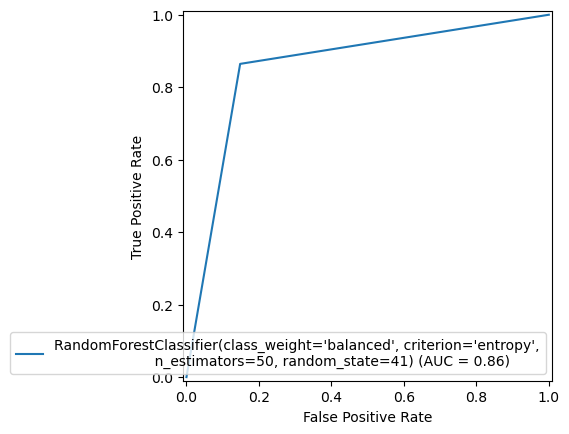

In [327]:
from sklearn import metrics
fpr,tpr,threshold=metrics.roc_curve(y_test,pred)
roc_auc=metrics.auc(fpr,tpr)
display=metrics.RocCurveDisplay(fpr=fpr,tpr=tpr,roc_auc=roc_auc,estimator_name=final_model)
display.plot()

#### Save the model

In [324]:
import joblib
joblib.dump(final_model,'loan_application.pkl')

['loan_application.pkl']

In [325]:
# lets load the saved model and get the predictions
model=joblib.load("loan_application.pkl")

# prediction
prediction=model.predict(x_test)
prediction

array([0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0,
       1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0,
       0, 0, 1, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0,
       0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1,
       1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1,
       1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1,
       1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1,
       1, 0, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0,
       1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1,
       1])

In [326]:
a=np.array(y_test)
df=pd.DataFrame()
df["Predicted"]=prediction
df["Original"]=a
df

,Predicted,Original
0,0,0
1,1,1
2,1,1
3,0,1
4,0,0
...,...,...
194,0,1
195,1,1
196,1,1
197,1,1


Conclusion:
In this project, we developed a binary classification model to predict application status based on various features . Among the models tested, insert the best-performing algorithm, e.g RandomForestClassifier ensemble provided the most accurate predictions. We fine-tuned the hyperparameters, including list key hyperparameters, e.g. number of estimators,ccp_alpha,criterion,random_state parameters to enhance the model's performance.

The final model achieved with 86% accuracy and a best classification report with high precision and demonstrated strong predictive capabilities. The results highlight the effectiveness of machine learning in predictive status.